In [1]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# Glaze


Se importan los documentos de la carperta ensayos_glaze. Se ha borrado el de 40 m/s para realizar las comparaciones en escenarios idénticos

In [29]:
nombre_carpeta='ensayos_glaze_2'
sensor_estudiado='S-pta'
archivos = os.listdir(nombre_carpeta)
print( os.listdir(nombre_carpeta))
#del archivos[0]

['P3-1_Glaze-4A.20200428120142.txt', 'P3-1_Glaze-4B.20200428113512.txt', 'P3-1_Glaze-4C.20200428123351.txt', 'P3-1_Glaze-5A.20200428115339.txt', 'P3-1_Glaze-5B.20200428112608.txt', 'P3-1_Glaze-5C.20200428122448.txt', 'P3-1_Glaze-6A.20200428114350.txt', 'P3-1_Glaze-6B.20200428111629.txt', 'P3-1_Glaze-6C.20200428121509.txt']


Ahora se procesan todos los archivos y se guardan en el diccionario "ensayos". Cada archivo es un DataFrame

In [30]:
ensayos={}
for archivo in archivos:
    file=open(nombre_carpeta+'//'+archivo,'r')
    lineas=file.readlines()
    file.close()
    inicial=int(lineas[0]) 
    texto=''
    for linea in range(inicial-1,len(lineas)):
        texto=texto+lineas[linea]+'\n'
    file=open('temporal.txt','w')
    file.write(texto)
    file.close()
    df=pd.read_csv('temporal.txt',sep='\t', decimal=',')
    initial_time_hours=float(df[df.columns[0]].loc[0][-14:-12])
    initial_time_minutes=float(df[df.columns[0]].loc[0][-11:-9])
    initial_time_seconds = float(df[df.columns[0]].loc[0][-8:])
    initial_time=3600*initial_time_hours+60*initial_time_minutes+initial_time_seconds
    Time=[]
    for t in df[df.columns[0]]:
        initial_time_hours=float(t[-14:-12])
        initial_time_minutes=float(t[-11:-9])
        initial_time_seconds = float(t[-8:])
        Time.append(3600*initial_time_hours+60*initial_time_minutes+initial_time_seconds-initial_time)
    df.index=Time
    ensayos.update({archivo[:-19]:df})
    print(archivo[:-19])
    df[sensor_estudiado].plot(label=archivo[12:-19],linewidth=0.1)
plt.legend()
plt.title('Sensor de la punta')
plt.xlabel('t(s)')
plt.ylabel('T(ºC)')
plt.savefig('resultados_29_04//'+sensor_estudiado+'ensayos_.pdf')

P3-1_Glaze-4A


KeyError: 'S-pta'

Se define la función de regresión como:

$$f(t)=a \frac{1 + m \exp(-(t-t_0)/\tau)}{ 1 + n \exp(-(t-t_0)/\tau)}\frac{ 1 + m_2 \exp(-(t-t_2)/\tau_{2})}{1 + n \exp(-(t-t_{2})/\tau_{2})}$$

In [44]:
def exponential(t,t0,a,m,tao,t_2,m_2,tao_2):
    import numpy as np
    n=6
    return a*(1+m*np.exp(-(t-t0)/tao))/(1+n*np.exp(-(t-t0)/tao))*(1+m_2*np.exp(-(t-t_2)/tao_2))/(1+n*np.exp(-(t-t_2)/tao_2))


Se asocia el archivo con el tipo de ensayo:

In [37]:
def caracterizar_ensayo(archivo):
    if archivo[-2]=='4':
        MVD=20
    if archivo[-2]=='5':
        MVD=40
    if archivo[-2]=='6':
        MVD=70
    if archivo[-1]=='A':
        LWC=.3
    if archivo[-1]=='B':
        LWC=.6
    if archivo[-1]=='C':
        LWC=.9
    return (LWC,MVD)

Se quita el ensayo de sin spray y se guardan todos los datos en listas. Luego se recopila en un DataFrame

In [61]:
S_pta=[]
Time=[]
MVD=[]
LWC=[]
#del ensayos['P2,3 en IWT-70ms-sin spray']
for archivo in ensayos:
    print(archivo)
    df=ensayos[archivo]
    lwc,mvd= caracterizar_ensayo(archivo)
    print(lwc)
    for i in df.index:
        S_pta.append(df[sensor_estudiado].loc[i])
        Time.append(i)
        MVD.append(mvd)
        LWC.append(lwc)

P3-1_Glaze-4A
0.3
P3-1_Glaze-4B
0.6
P3-1_Glaze-4C
0.9
P3-1_Glaze-5A
0.3
P3-1_Glaze-5B
0.6
P3-1_Glaze-5C
0.9
P3-1_Glaze-6A
0.3
P3-1_Glaze-6B
0.6
P3-1_Glaze-6C
0.9


In [62]:
dframe=pd.DataFrame()
dframe['LWC']=LWC
dframe['MVD']=MVD
dframe['S_pta']= S_pta
dframe['Tiempo']=Time

C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\scipy\optimize\minpack.py:808: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


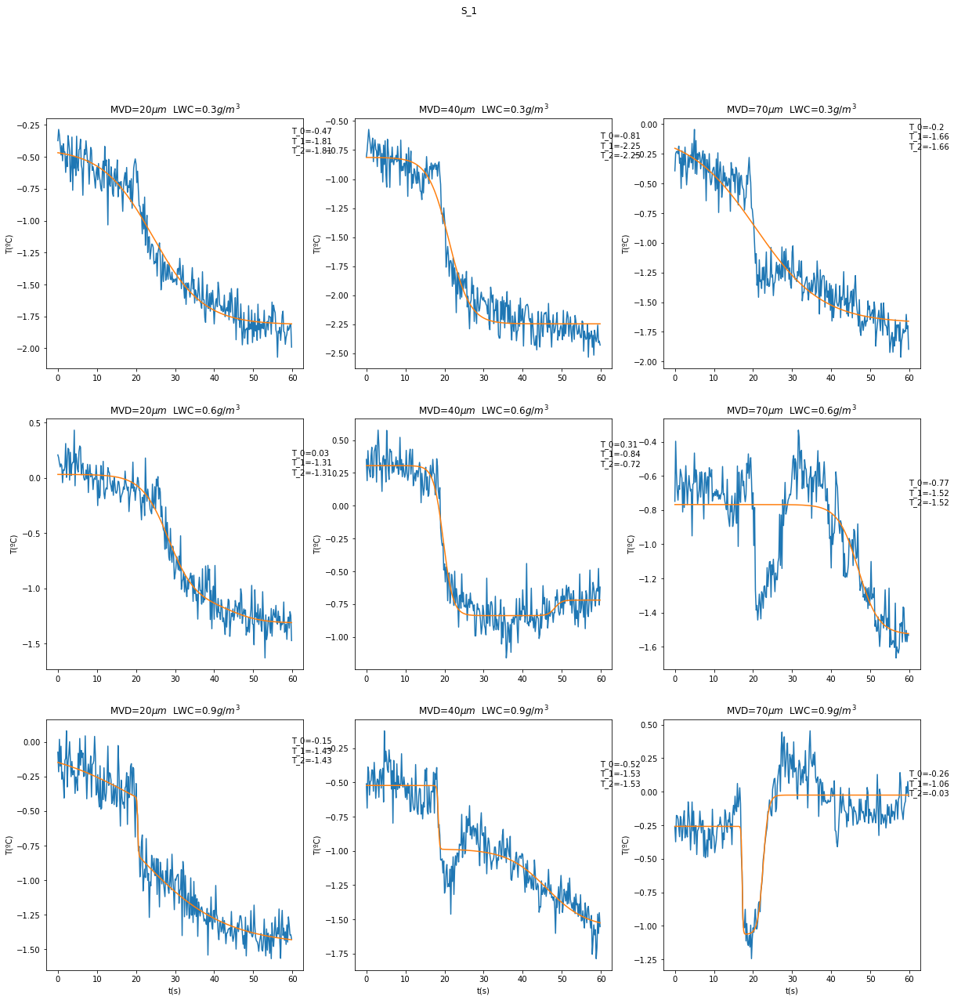

In [63]:
tabla=[]
fila=0
columna = 0
fig, ax = plt.subplots(3,3, sharey=False,figsize=(20,20))
fig.suptitle(sensor_estudiado)
for gota in [20,40,70]:
    
    for contenido in [0.3,0.6,0.9]:
        
        Testeo=dframe[(dframe.MVD==gota)&(dframe.LWC==contenido)&(dframe.Tiempo<60)]
        if len(Testeo)==0:continue
        tiempo=list(Testeo.Tiempo)
        tempe=list((Testeo.S_pta))
        
        disparo_a=float(np.mean(tempe[-20:]))
        disparo_m2=float(6/disparo_a*min(tempe))
        disparo_m1=float(tempe[0]*6**2/disparo_a/disparo_m2)
        popt, pcov = curve_fit(exponential, tiempo, tempe,p0=(tiempo[0],disparo_a,
                                                              disparo_m1,6,tiempo[0]+10,disparo_m2,6),maxfev = 1000000) 
        senal_aprox_rapido=[]
        t01=popt[0]
        a1=popt[1]
        m1=popt[2]
        tao1=popt[3]
        t02=popt[4]
        m2=popt[5]
        tao2=popt[6]
        f=[]
        for t in tiempo:f.append(exponential(t,t01,a1,m1,tao1,popt[4],popt[5],popt[6]))
               
               
        ax[fila,columna].plot(tiempo,tempe,tiempo,f)
 
        
        texto_grafica='T_0='+str(round(f[0],2))+'\n'+'T_1='+str(round(min(f),2))+'\n'+'T_2='+str(round(f[-1],2))
        ax[fila,columna].text(max(tiempo),max(f),texto_grafica)
        if fila==2:ax[fila,columna].set_xlabel('t(s)')
        ax[fila,columna].set_ylabel('T(ºC)')
        ax[fila,columna].set_title('MVD='+str(gota)+'$\mu m$  LWC='+ str(contenido)+'$g/m^{3}$')
        tabla.append([gota,contenido,round(f[0],2),round(min(f)-f[0],2),round(f[-1]-min(f),2)])
        fila+=1
    fila=0
    columna+=1
plt.savefig('resultados_29_04//'+sensor_estudiado+'ensayos_glaze2.pdf')

In [48]:
pd.DataFrame(data=tabla,columns=['MVD','LWC','T_0','bajada','subida'])

,MVD,LWC,T_0,bajada,subida
0,20,0.3,-0.66,-0.21,1.56
1,20,0.6,0.11,-0.48,3.92
2,20,0.9,-0.39,-0.16,4.19
3,40,0.3,-1.00,-0.20,2.08
4,40,0.6,0.17,0.00,3.63
5,40,0.9,-0.35,-0.60,5.17
6,70,0.3,-0.56,-0.39,2.59
7,70,0.6,-0.77,-0.17,4.27
8,70,0.9,-0.39,-0.10,4.01


# Rime

En Rime se hace lo mismo $\textbf{pero faltan ensayos}$

In [10]:
archivos = os.listdir('rime')
print(archivos)


['P2,3 en IWT-70ms_4A.20200421112931.txt', 'P2,3 en IWT-70ms_4B.20200421110132.txt', 'P2,3 en IWT-70ms_4C.20200420141301.txt', 'P2,3 en IWT-70ms_5A.20200421112023.txt', 'P2,3 en IWT-70ms_5B.20200420143231.txt', 'P2,3 en IWT-70ms_5C.20200420140238.txt', 'P2,3 en IWT-70ms_6A.20200421111056.txt', 'P2,3 en IWT-70ms_6B.20200420142309.txt', 'P2,3 en IWT-70ms_6C.20200420135051.txt']


P2,3 en IWT-70ms_4A
P2,3 en IWT-70ms_4B
P2,3 en IWT-70ms_4C
P2,3 en IWT-70ms_5A
P2,3 en IWT-70ms_5B
P2,3 en IWT-70ms_5C
P2,3 en IWT-70ms_6A
P2,3 en IWT-70ms_6B
P2,3 en IWT-70ms_6C


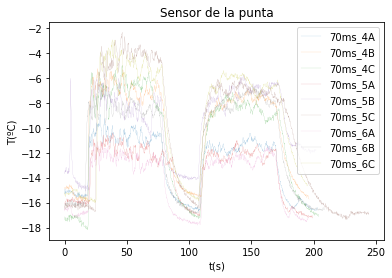

In [11]:
ensayos={}
for archivo in archivos:
    file=open('rime//'+archivo,'r')
    lineas=file.readlines()
    file.close()
    inicial=int(lineas[0])
    
    texto=''
    
    for linea in range(inicial-1,len(lineas)):
        texto=texto+lineas[linea]+'\n'
    file=open('temporal.txt','w')
    file.write(texto)
    file.close()
    df=pd.read_csv('temporal.txt',sep='\t', decimal=',')
  
    initial_time_hours=float(df[df.columns[0]].loc[0][-14:-12])
    initial_time_minutes=float(df[df.columns[0]].loc[0][-11:-9])
    initial_time_seconds = float(df[df.columns[0]].loc[0][-8:])
    initial_time=3600*initial_time_hours+60*initial_time_minutes+initial_time_seconds
    Time=[]
    for t in df[df.columns[0]]:
        initial_time_hours=float(t[-14:-12])
        initial_time_minutes=float(t[-11:-9])
        initial_time_seconds = float(t[-8:])
        Time.append(3600*initial_time_hours+60*initial_time_minutes+initial_time_seconds-initial_time)
    df.index=Time
    ensayos.update({archivo[:-19]:df})
    print(archivo[:-19])
    df['S-pta'].plot(label=archivo[12:-19],linewidth=0.1)
plt.legend()
plt.title('Sensor de la punta')
plt.xlabel('t(s)')
plt.ylabel('T(ºC)')
plt.savefig('ensayos_rime.pdf')

Se define la función de regresión como:

$$f(t)=a \frac{1 + m \exp(-(t-t_0)/\tau)}{ 1 + n \exp(-(t-t_0)/\tau)}$$

In [12]:
def exponential(t,t0,a,m,tao):
    import numpy as np
    n=6
    return a*(1+m*np.exp(-(t-t0)/tao))/(1+n*np.exp(-(t-t0)/tao))


La derivada temporal de la función: $$\frac{df}{dt}$$

In [13]:
def dexponential(a,m,tao,n,tiempo,t0):
    t=tiempo-t0
    import numpy as np
    A=a/(1+n*np.exp(-t/tao))**2;
    B=(1+n*np.exp(-t/tao))*(-m/tao*np.exp(-t/tao))
    C=-(1+m*np.exp(-t/tao))*(-n/tao*np.exp(-t/tao))
    df=A*(B+C)
    return df

In [14]:
def caracterizar_ensayo(archivo):
    if archivo[-2]=='4':
        MVD=20
    if archivo[-2]=='5':
        MVD=40
    if archivo[-2]=='6':
        MVD=70
    if archivo[-1]=='A':
        LWC=.3
    if archivo[-1]=='B':
        LWC=.6
    if archivo[-1]=='C':
        LWC=.9
    return (LWC,MVD)

In [15]:
S_pta=[]
Time=[]
MVD=[]
LWC=[]
#del ensayos['P2,3 en IWT-70ms-sin spray']
for archivo in ensayos:
    print(archivo)
    df=ensayos[archivo]
    lwc,mvd= caracterizar_ensayo(archivo)
    print(lwc)
    for i in df.index:
        S_pta.append(df['S-pta'].loc[i])
        Time.append(i)
        MVD.append(mvd)
        LWC.append(lwc)

P2,3 en IWT-70ms_4A
0.3
P2,3 en IWT-70ms_4B
0.6
P2,3 en IWT-70ms_4C
0.9
P2,3 en IWT-70ms_5A
0.3
P2,3 en IWT-70ms_5B
0.6
P2,3 en IWT-70ms_5C
0.9
P2,3 en IWT-70ms_6A
0.3
P2,3 en IWT-70ms_6B
0.6
P2,3 en IWT-70ms_6C
0.9


In [17]:
dframe=pd.DataFrame()
dframe['LWC']=LWC
dframe['MVD']=MVD
dframe['S_pta']= S_pta
dframe['Tiempo']=Time

C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.


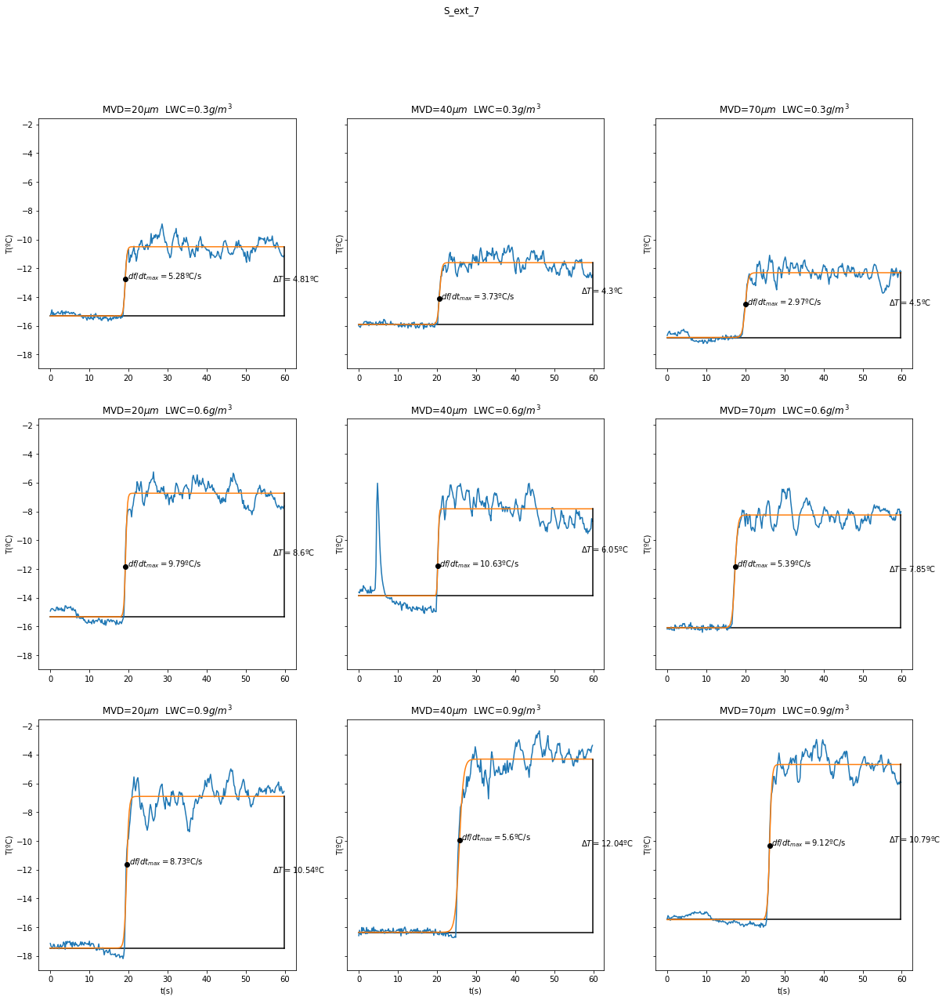

In [18]:
 
tabla=[]
fila=0
columna = 0
fig, ax = plt.subplots(3,3,figsize=(20,20),sharey=True)
fig.suptitle('S_ext_7')
for gota in [20,40,70]:
    
    for contenido in [0.3,0.6,0.9]:
        
        Testeo=dframe[(dframe.MVD==gota)&(dframe.LWC==contenido)&(dframe.Tiempo<60)]
        if len(Testeo)==0:continue
        tiempo=list(Testeo.Tiempo)
        tempe=list((Testeo.S_pta))
        
        disparo_a=float(np.mean(tempe[-20:]))
        popt, pcov = curve_fit(exponential, tiempo, tempe,p0=(tiempo[0],disparo_a,-90,6),maxfev = 100000) 
        senal_aprox_rapido=[]
        t01=popt[0]
        a1=popt[1]
        m1=popt[2]
        #            n1=popt[3]
        tao1=popt[3]
        f=[]
        for t in tiempo:f.append(exponential(t,t01,a1,m1,tao1))
        
        
        df=[]
        for t in tiempo:df.append(dexponential(a1,m1,tao1,6,t,t01))
        maxdf=max(df)
        for d in range(len(df)):
            if df[d]==maxdf:
                t_max=tiempo[d]
                max_f=f[d]
        
        
        ax[fila,columna].plot([tiempo[0],tiempo[-1]],[f[0],f[0]],'k')
        
        ax[fila,columna].plot(tiempo,tempe,tiempo,f)
        ax[fila,columna].plot(t_max,max_f,'ok')
        ax[fila,columna].plot([tiempo[-1],tiempo[-1]],[f[0],f[0]+a1*(1-m1/6)],'k')
        #plt.arrow(tiempo[-1],f[0],0,a1*(1-m1/6)-0.4,head_width=2, head_length=0.4)
        ax[fila,columna].text(tiempo[-1]-3,(f[0]+f[0]+a1*(1-m1/6))/2,r'$\Delta T =$' +str(round(a1*(1-m1/6),2))+'ºC')
        #ax[fila,columna].axis([40,90,min(tempe)-.3,max(tempe)+.3])
        ax[fila,columna].text(t_max+.5,max_f,'$df/dt_{max} =$' +str(round(maxdf,2))+'ºC/s')
        if fila==2:ax[fila,columna].set_xlabel('t(s)')
        ax[fila,columna].set_ylabel('T(ºC)')
        ax[fila,columna].set_title('MVD='+str(gota)+'$\mu m$  LWC='+ str(contenido)+'$g/m^{3}$')
        tabla.append([gota,contenido,round(f[0],2),round(a1*(1-m1/6),2),round(maxdf,2)] )
        fila+=1
    fila=0
    columna+=1
plt.savefig('ensayos_rime2.pdf')

In [19]:
pd.DataFrame(data=tabla,columns=['MVD','LWC','T_0','Delta_T','df_dt_max'])

,MVD,LWC,T_0,Delta_T,df_dt_max
0,20,0.3,-15.32,4.81,5.28
1,20,0.6,-15.33,8.60,9.79
2,20,0.9,-17.45,10.54,8.73
3,40,0.3,-15.92,4.30,3.73
4,40,0.6,-13.87,6.05,10.63
5,40,0.9,-16.36,12.04,5.60
6,70,0.3,-16.81,4.50,2.97
7,70,0.6,-16.10,7.85,5.39
8,70,0.9,-15.48,10.79,9.12


In [19]:
resultado_final=pd.DataFrame(data=tabla,columns=['MVD','LWC','T_0','Delta_T','df_dt_max'])

[ 6.73 10.54]


<BarContainer object of 2 artists>

<Figure size 432x288 with 0 Axes>

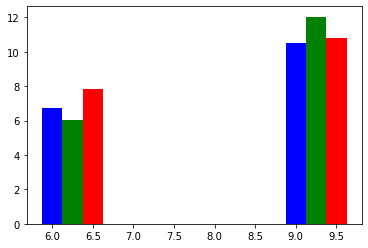

In [20]:
fig = plt.figure()
X = np.array([6,9])
plt.figure()

print(np.array(resultado_final[resultado_final.MVD==20]['Delta_T']))
plt.bar(X + 0.00, np.array(resultado_final[resultado_final.MVD==20]['Delta_T']), color = 'b', width = 0.25)
plt.bar(X + 0.25,  np.array(resultado_final[resultado_final.MVD==40]['Delta_T']), color = 'g', width = 0.25)
plt.bar(X + 0.50,  np.array(resultado_final[resultado_final.MVD==70]['Delta_T']), color = 'r', width = 0.25)

# Glaze usando nuevas calibraciones

Se carga el objeto pickle

In [4]:
import pickle
Calibracion = pd.read_pickle('calibracion_1.pickle')
Calibracion.index=Calibracion.sensor
Calibracion=Calibracion.drop(columns=['sensor'])
Calibracion

,A,B,C,D
sensor,,,,
FBG_A1 (nm),18.238715,-83218.247076,1.265674e+08,-6.416593e+10
FBG_A2 (nm),10.673267,-48800.319122,7.437505e+07,-3.778429e+10
FBG_A3 (nm),17.877506,-81889.235415,1.250333e+08,-6.363615e+10
FBG_A4 (nm),17.723985,-81340.705786,1.244324e+08,-6.345099e+10
FBG_A5 (nm),37.227268,-171164.557529,2.623285e+08,-1.340158e+11
FBG_A6 (nm),24.430151,-112549.621102,1.728387e+08,-8.847423e+10
FBG_A7 (nm),20.411166,-94219.987921,1.449764e+08,-7.435850e+10
FBG_B3 (nm),57.333861,-262575.713720,4.008453e+08,-2.039754e+11
FBG_B4 (nm),48.426080,-222210.547022,3.398826e+08,-1.732894e+11


In [3]:
archivos = os.listdir('ensayos_glaze')
print(archivos)
del archivos[0]


['P2,3 en IWT-40ms-Glaze-6A.20200421142856.txt', 'P2,3 en IWT-70ms-Glaze-4A.20200421141616.txt', 'P2,3 en IWT-70ms-Glaze-4B.20200421134437.txt', 'P2,3 en IWT-70ms-Glaze-4C.20200421131256.txt', 'P2,3 en IWT-70ms-Glaze-5A.20200421140548.txt', 'P2,3 en IWT-70ms-Glaze-5B.20200421133457.txt', 'P2,3 en IWT-70ms-Glaze-5C.20200421130212.txt', 'P2,3 en IWT-70ms-Glaze-6A.20200421135558.txt', 'P2,3 en IWT-70ms-Glaze-6B.20200421132316.txt', 'P2,3 en IWT-70ms-Glaze-6C.20200421125244.txt', 'P2,3 en IWT-70ms-sin spray.20200421124605.txt']


In [4]:
def wavelength_to_T(wavelength,sensor):
    global Calibracion
    C=Calibracion.loc[sensor]
    return (C['A']*wavelength**3+C['B']*wavelength**2+C['C']*wavelength+C['D'])

P2,3 en IWT-70ms-Glaze-4A
P2,3 en IWT-70ms-Glaze-4B
P2,3 en IWT-70ms-Glaze-4C
P2,3 en IWT-70ms-Glaze-5A
P2,3 en IWT-70ms-Glaze-5B
P2,3 en IWT-70ms-Glaze-5C
P2,3 en IWT-70ms-Glaze-6A
P2,3 en IWT-70ms-Glaze-6B
P2,3 en IWT-70ms-Glaze-6C


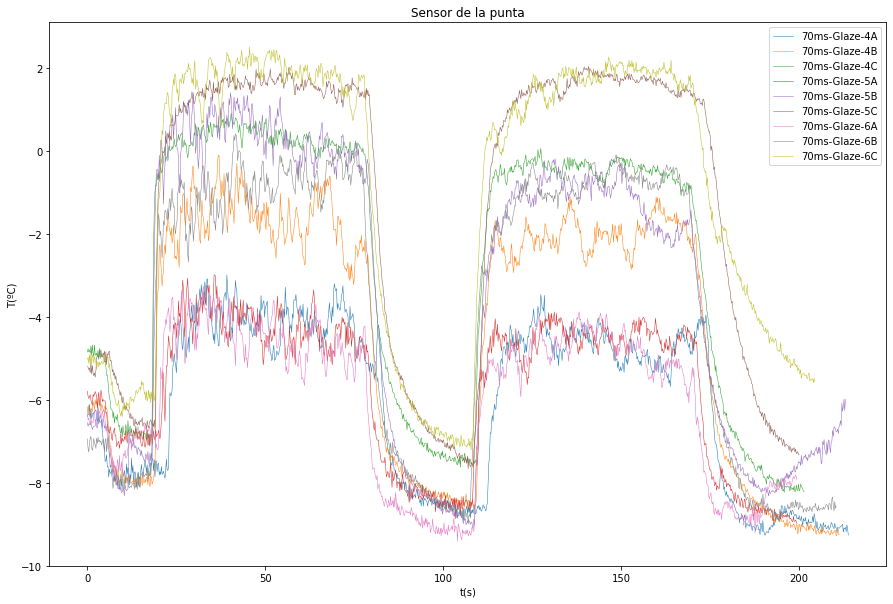

In [5]:
ensayos={}
plt.figure(figsize=(15,10))
for archivo in archivos[:-1]:
    file=open('ensayos_glaze//'+archivo,'r')
    lineas=file.readlines()
    file.close()
    inicial=int(lineas[0])
    
    texto=''
    
    for linea in range(inicial-1,len(lineas)):
        texto=texto+lineas[linea]+'\n'
    file=open('temporal.txt','w')
    file.write(texto)
    file.close()
    df=pd.read_csv('temporal.txt',sep='\t', decimal=',')
   
    initial_time_hours=float(df[df.columns[0]].loc[0][-14:-12])
    initial_time_minutes=float(df[df.columns[0]].loc[0][-11:-9])
    initial_time_seconds = float(df[df.columns[0]].loc[0][-8:])
    initial_time=3600*initial_time_hours+60*initial_time_minutes+initial_time_seconds
    Time=[]
    for t in df[df.columns[0]]:
        initial_time_hours=float(t[-14:-12])
        initial_time_minutes=float(t[-11:-9])
        initial_time_seconds = float(t[-8:])
        Time.append(3600*initial_time_hours+60*initial_time_minutes+initial_time_seconds-initial_time)
    df.index=Time
    
    columnas=[]
    for columna in df:
        if columna[:3]=='FBG':columnas.append(columna)
    df=df[columnas]
    for col in df:
        
        fbg=np.array(df[col])
        Temperature=[wavelength_to_T(wavelength,col) for wavelength in fbg]
        df['S_'+col[4:6]]=Temperature
    df['S-pta']=df['S_C1']
    ensayos.update({archivo[:-19]:df})
    print(archivo[:-19])
    df['S_C1'].plot(label=archivo[12:-19],linewidth=0.5)
    
plt.legend()
plt.title('Sensor de la punta')
plt.xlabel('t(s)')
plt.ylabel('T(ºC)')
plt.savefig('ensayos_glaze_calibracion_nueva.svg')

In [14]:
df.columns


Index(['FBG_A1 (nm)', 'FBG_A2 (nm)', 'FBG_A3 (nm)', 'FBG_A4 (nm)',
       'FBG_A5 (nm)', 'FBG_A6 (nm)', 'FBG_A7 (nm)', 'FBG_B3 (nm)',
       'FBG_B4 (nm)', 'FBG_B5 (nm)', 'FBG_B6 (nm)', 'FBG_B7 (nm)',
       'FBG_C1 (nm)', 'S_A1', 'S_A2', 'S_A3', 'S_A4', 'S_A5', 'S_A6', 'S_A7',
       'S_B3', 'S_B4', 'S_B5', 'S_B6', 'S_B7', 'S_C1', 'S-pta'],
      dtype='object')

In [6]:
def exponential(t,t0,a,m,tao,t_2,m_2,tao_2):
    import numpy as np
    n=6
    return a*(1+m*np.exp(-(t-t0)/tao))/(1+n*np.exp(-(t-t0)/tao))*(1+m_2*np.exp(-(t-t_2)/tao_2))/(1+n*np.exp(-(t-t_2)/tao_2))


Se asocia el archivo con el tipo de ensayo:

In [7]:
def caracterizar_ensayo(archivo):
    if archivo[-2]=='4':
        MVD=20
    if archivo[-2]=='5':
        MVD=40
    if archivo[-2]=='6':
        MVD=70
    if archivo[-1]=='A':
        LWC=.3
    if archivo[-1]=='B':
        LWC=.6
    if archivo[-1]=='C':
        LWC=.9
    return (LWC,MVD)

Se quita el ensayo de sin spray y se guardan todos los datos en listas. Luego se recopila en un DataFrame

In [8]:
S_pta=[]
Time=[]
MVD=[]
LWC=[]

for archivo in ensayos:
    print(archivo)
    df=ensayos[archivo]
    lwc,mvd= caracterizar_ensayo(archivo)
    print(lwc)
    for i in df.index:
        S_pta.append(df['S_C1'].loc[i])
        Time.append(i)
        MVD.append(mvd)
        LWC.append(lwc)

P2,3 en IWT-70ms-Glaze-4A
0.3
P2,3 en IWT-70ms-Glaze-4B
0.6
P2,3 en IWT-70ms-Glaze-4C
0.9
P2,3 en IWT-70ms-Glaze-5A
0.3
P2,3 en IWT-70ms-Glaze-5B
0.6
P2,3 en IWT-70ms-Glaze-5C
0.9
P2,3 en IWT-70ms-Glaze-6A
0.3
P2,3 en IWT-70ms-Glaze-6B
0.6
P2,3 en IWT-70ms-Glaze-6C
0.9


In [9]:
dframe=pd.DataFrame()
dframe['LWC']=LWC
dframe['MVD']=MVD
dframe['S_pta']= S_pta
dframe['Tiempo']=Time

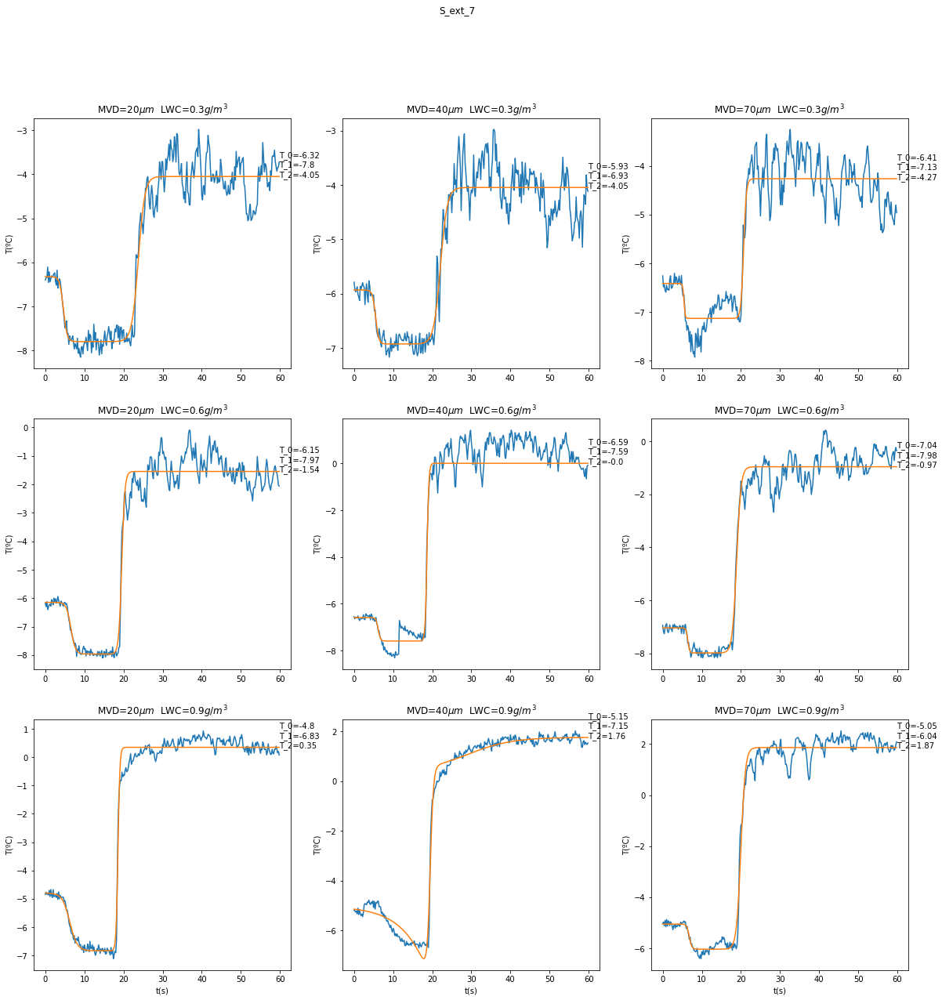

In [23]:
tabla=[]
fila=0
columna = 0
fig, ax = plt.subplots(3,3, sharey=False,figsize=(20,20))
fig.suptitle('S_ext_7')
for gota in [20,40,70]:
    
    for contenido in [0.3,0.6,0.9]:
        
        Testeo=dframe[(dframe.MVD==gota)&(dframe.LWC==contenido)&(dframe.Tiempo<60)]
        if len(Testeo)==0:continue
        tiempo=list(Testeo.Tiempo)
        tempe=list((Testeo.S_pta))
        
        disparo_a=float(np.mean(tempe[-20:]))
        disparo_m2=float(6/disparo_a*min(tempe))
        disparo_m1=float(tempe[0]*6**2/disparo_a/disparo_m2)
        popt, pcov = curve_fit(exponential, tiempo, tempe,p0=(tiempo[0],disparo_a,
                                                              disparo_m1,6,tiempo[0]+10,disparo_m2,6),maxfev = 1000000) 
        senal_aprox_rapido=[]
        t01=popt[0]
        a1=popt[1]
        m1=popt[2]
        tao1=popt[3]
        t02=popt[4]
        m2=popt[5]
        tao2=popt[6]
        f=[]
        for t in tiempo:f.append(exponential(t,t01,a1,m1,tao1,popt[4],popt[5],popt[6]))
               
               
        ax[fila,columna].plot(tiempo,tempe,tiempo,f)
 
        
        texto_grafica='T_0='+str(round(f[0],2))+'\n'+'T_1='+str(round(min(f),2))+'\n'+'T_2='+str(round(f[-1],2))
        ax[fila,columna].text(max(tiempo),max(f),texto_grafica)
        if fila==2:ax[fila,columna].set_xlabel('t(s)')
        ax[fila,columna].set_ylabel('T(ºC)')
        ax[fila,columna].set_title('MVD='+str(gota)+'$\mu m$  LWC='+ str(contenido)+'$g/m^{3}$')
        tabla.append([gota,contenido,round(f[0],2),round(min(f)-f[0],2),round(f[-1]-min(f),2)])
        fila+=1
    fila=0
    columna+=1
plt.savefig('ensayos_glaze_calibracion_nueva2.pdf')

In [12]:
pd.DataFrame(data=tabla,columns=['MVD','LWC','T_0','bajada','subida'])

,MVD,LWC,T_0,bajada,subida
0,20,0.3,-5.27,-0.48,0.00
1,20,0.6,-4.86,-0.84,0.69
2,20,0.9,-3.33,-1.33,0.59
3,40,0.3,-4.85,-0.76,0.00
4,40,0.6,-5.14,-0.92,1.37
5,40,0.9,-4.38,-0.60,2.95
6,70,0.3,-5.50,-0.45,0.34
7,70,0.6,-5.27,-0.64,4.44
8,70,0.9,-5.51,-0.57,3.46


Ahora se procesan $\textbf{todos}$ los ensayos

P2,3 en IWT-70ms-Glaze-4A
0.3
P2,3 en IWT-70ms-Glaze-4B
0.6
P2,3 en IWT-70ms-Glaze-4C
0.9
P2,3 en IWT-70ms-Glaze-5A
0.3
P2,3 en IWT-70ms-Glaze-5B
0.6
P2,3 en IWT-70ms-Glaze-5C
0.9
P2,3 en IWT-70ms-Glaze-6A
0.3
P2,3 en IWT-70ms-Glaze-6B
0.6
P2,3 en IWT-70ms-Glaze-6C
0.9
P2,3 en IWT-70ms-Glaze-4A
0.3
P2,3 en IWT-70ms-Glaze-4B
0.6
P2,3 en IWT-70ms-Glaze-4C
0.9
P2,3 en IWT-70ms-Glaze-5A
0.3
P2,3 en IWT-70ms-Glaze-5B
0.6
P2,3 en IWT-70ms-Glaze-5C
0.9
P2,3 en IWT-70ms-Glaze-6A
0.3
P2,3 en IWT-70ms-Glaze-6B
0.6
P2,3 en IWT-70ms-Glaze-6C
0.9
P2,3 en IWT-70ms-Glaze-4A
0.3
P2,3 en IWT-70ms-Glaze-4B
0.6
P2,3 en IWT-70ms-Glaze-4C
0.9
P2,3 en IWT-70ms-Glaze-5A
0.3
P2,3 en IWT-70ms-Glaze-5B
0.6
P2,3 en IWT-70ms-Glaze-5C
0.9
P2,3 en IWT-70ms-Glaze-6A
0.3
P2,3 en IWT-70ms-Glaze-6B
0.6
P2,3 en IWT-70ms-Glaze-6C
0.9
P2,3 en IWT-70ms-Glaze-4A
0.3
P2,3 en IWT-70ms-Glaze-4B
0.6
P2,3 en IWT-70ms-Glaze-4C
0.9
P2,3 en IWT-70ms-Glaze-5A
0.3
P2,3 en IWT-70ms-Glaze-5B
0.6
P2,3 en IWT-70ms-Glaze-5C
0.9
P2,3 en IW

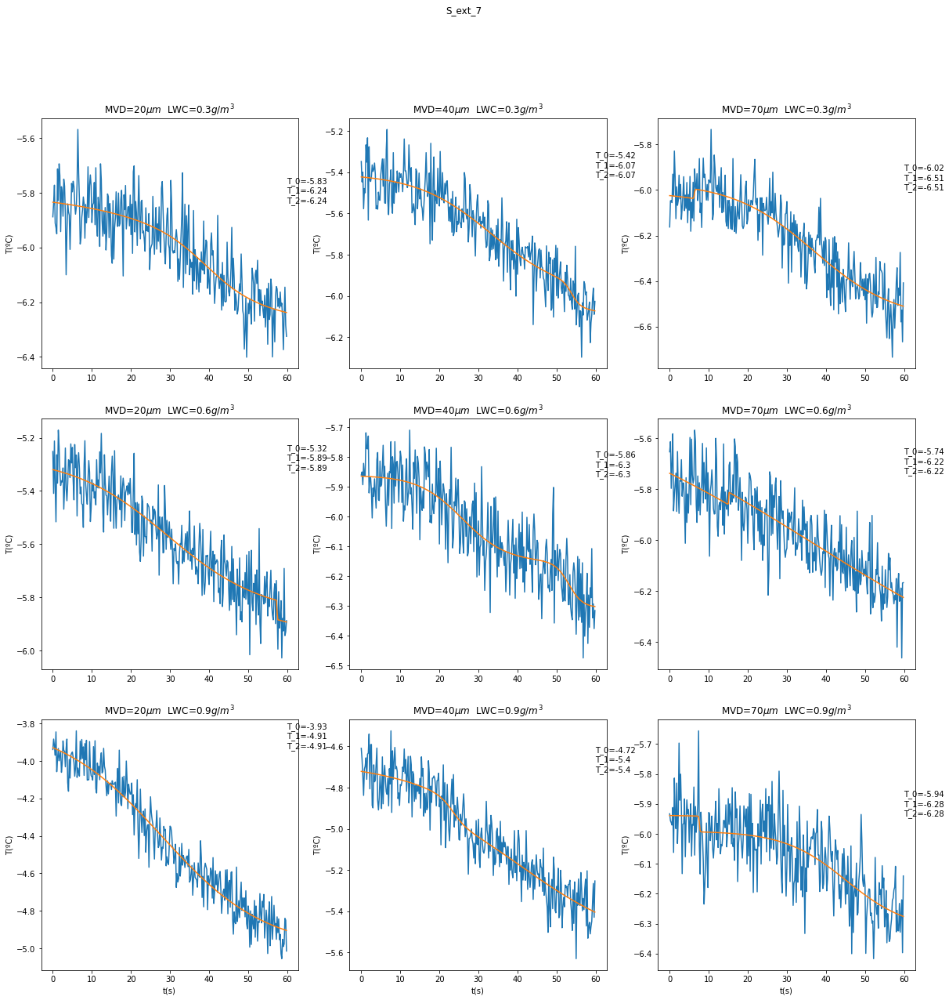

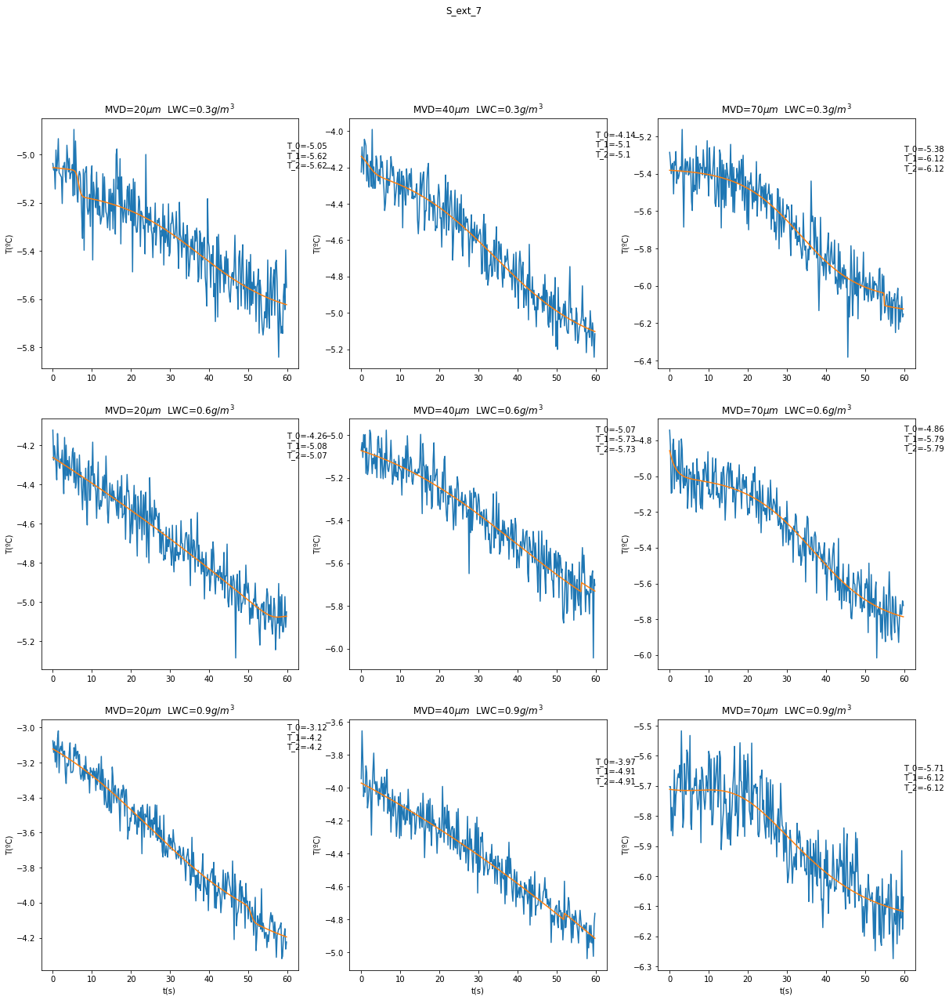

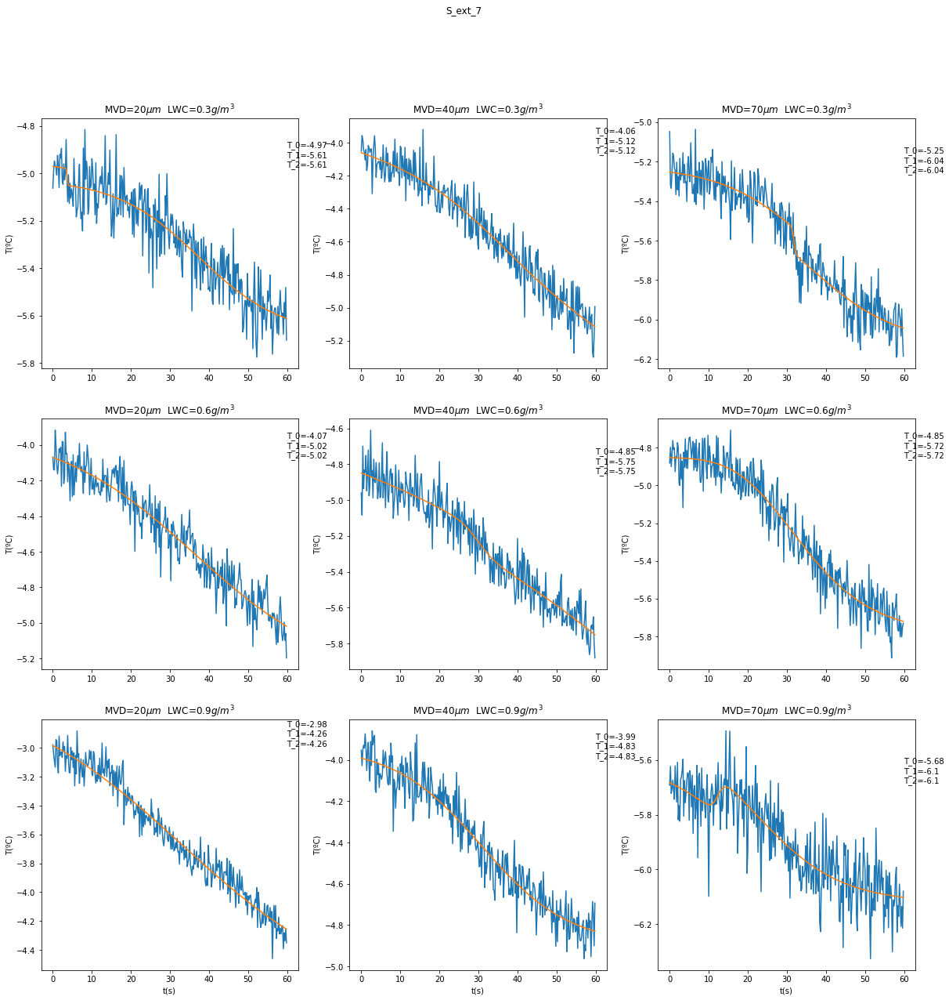

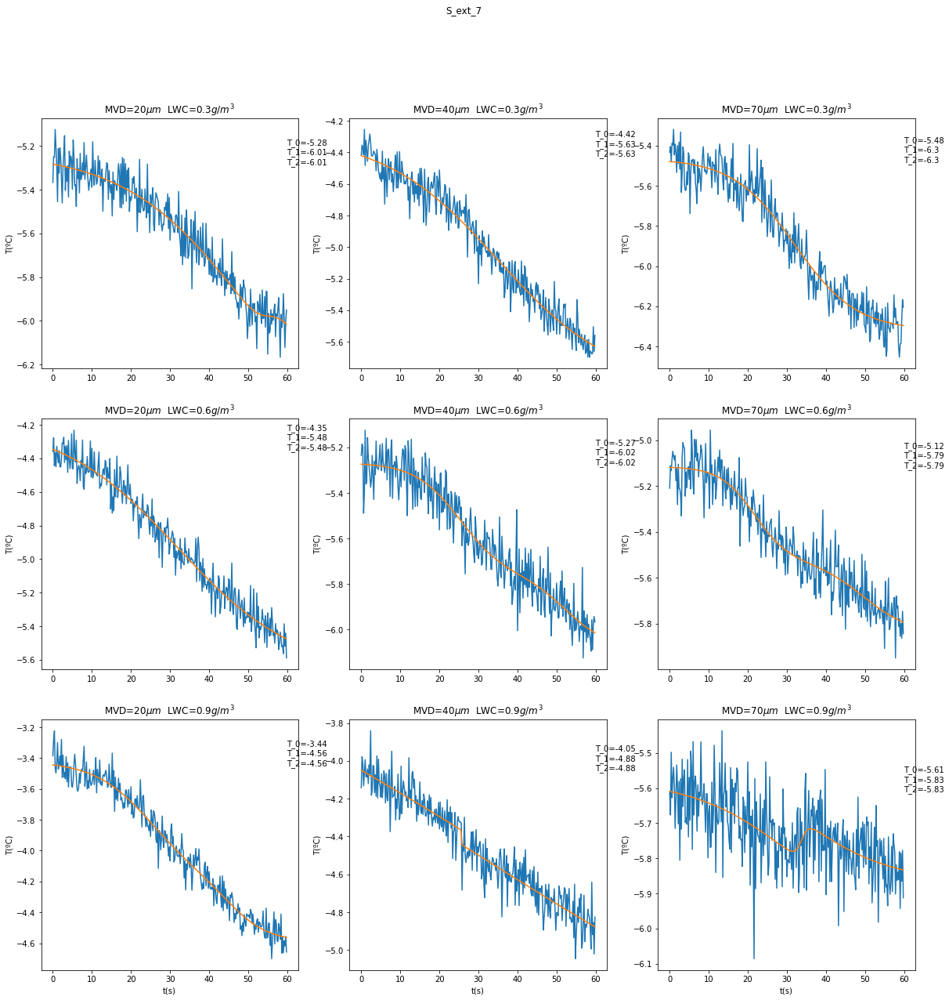

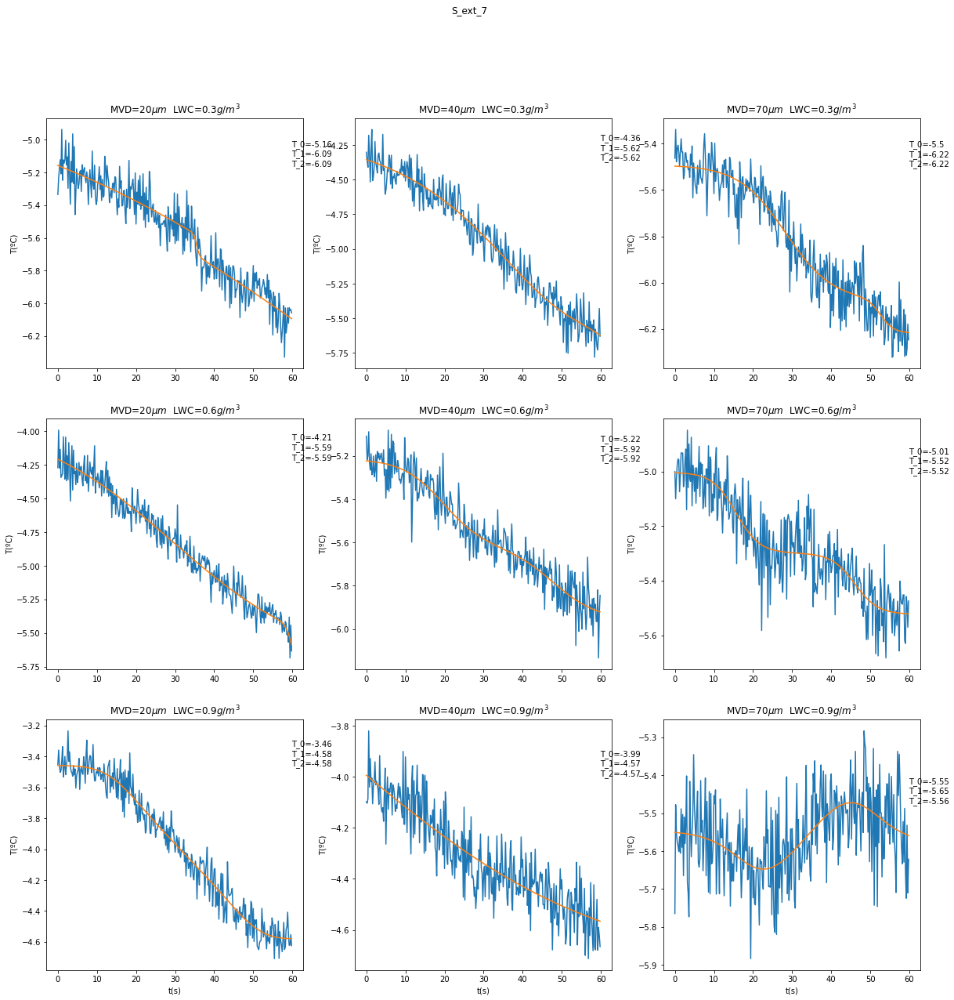

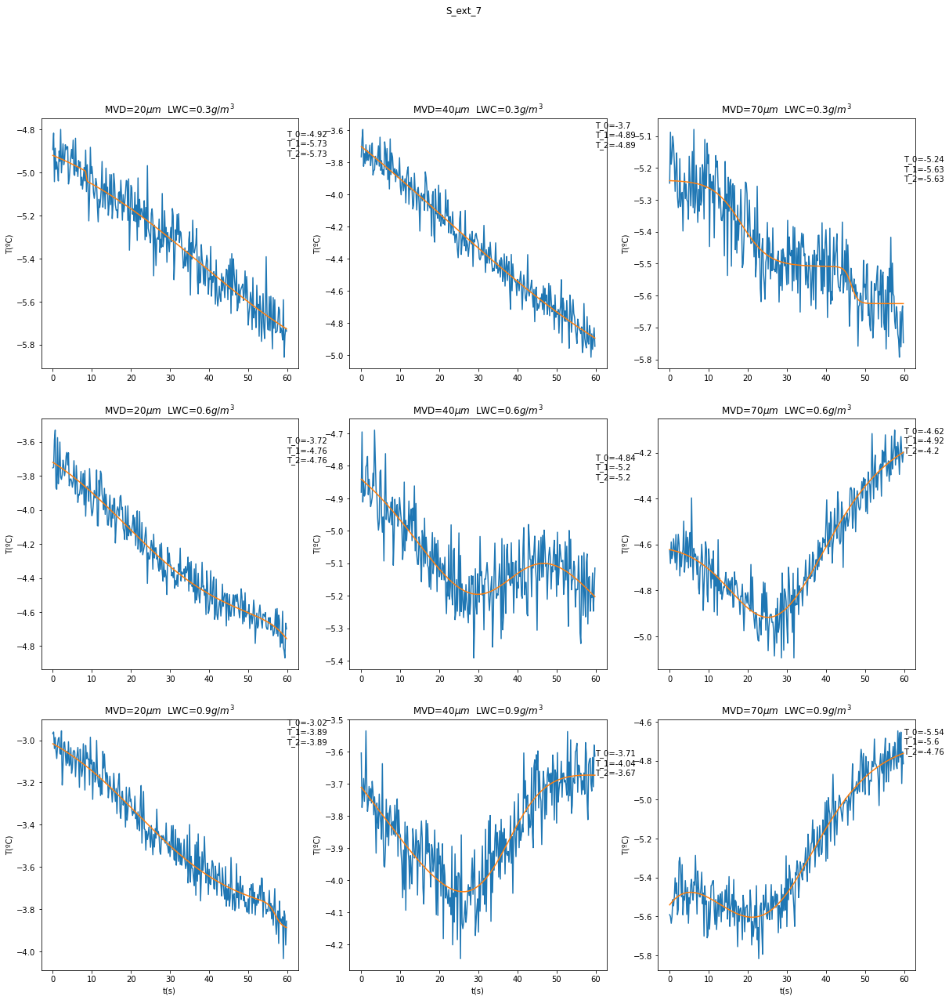

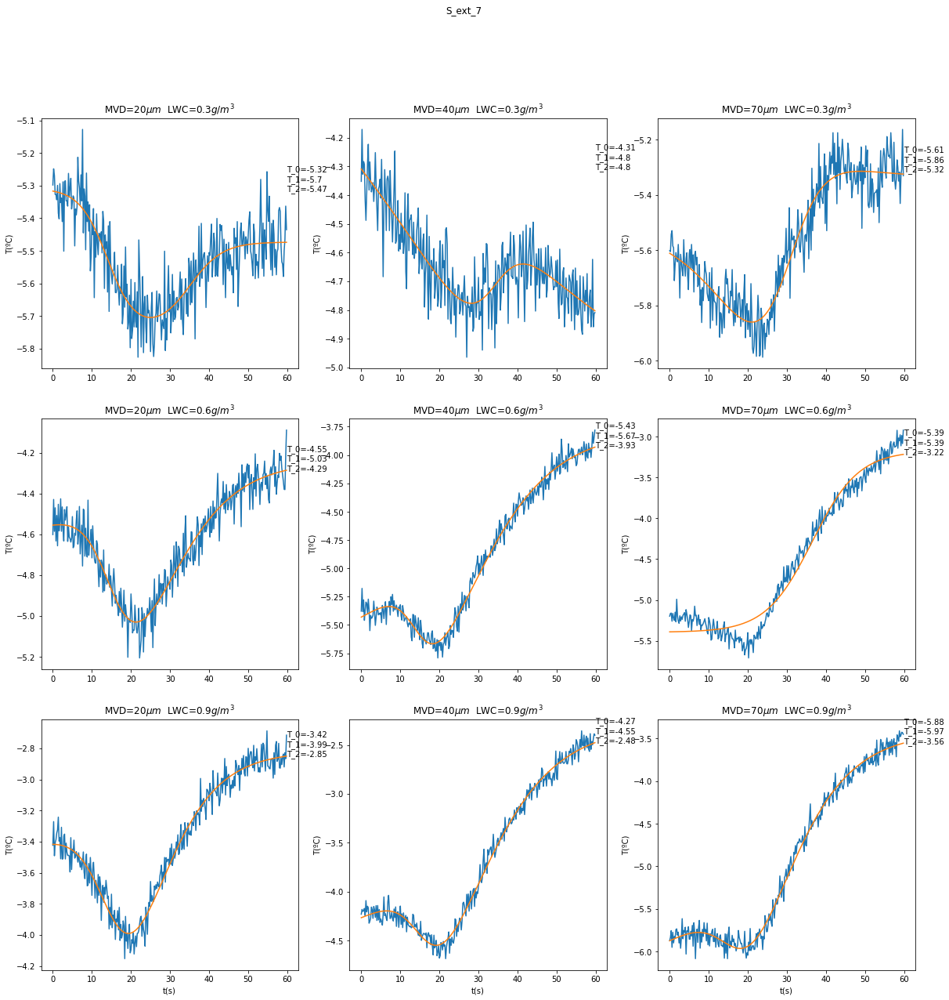

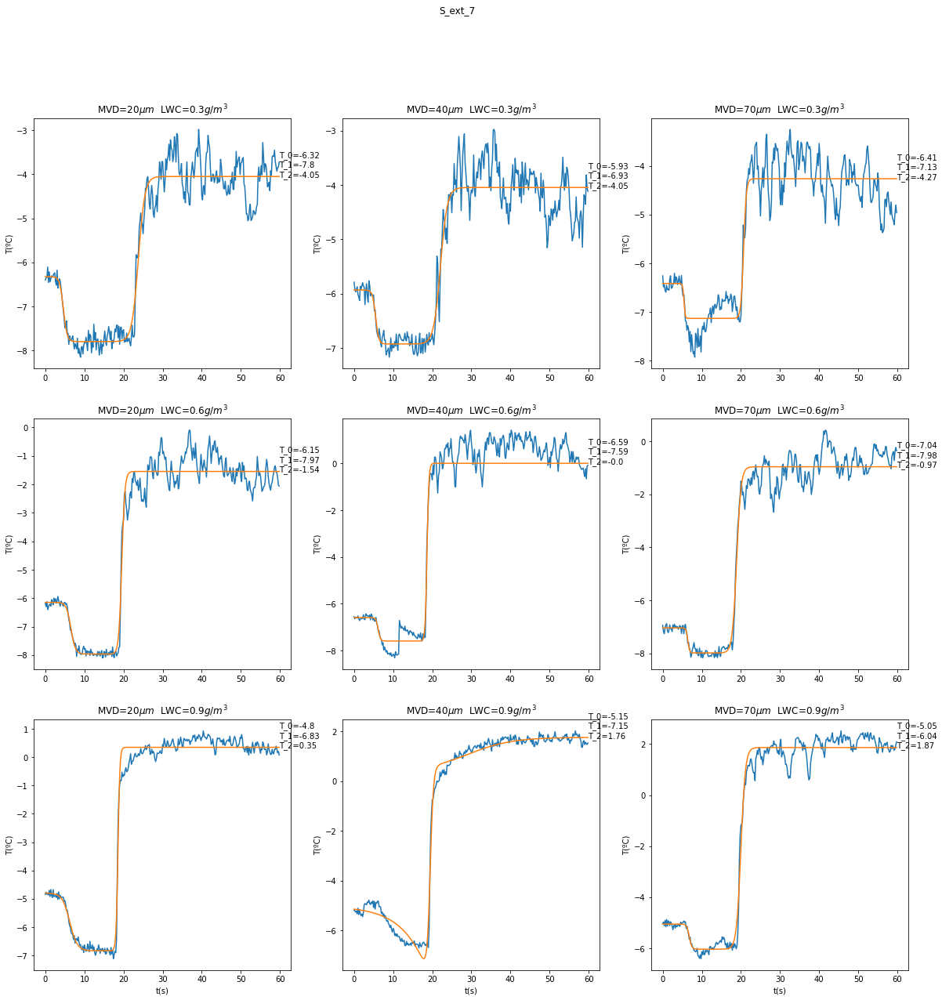

In [19]:
tabla=[]
for sensor in ['S_A1', 'S_A2', 'S_A3', 'S_A4', 'S_A5', 'S_A6', 'S_A7', 'S_C1']:
    print(sensor)
    S_pta=[]
    Time=[]
    MVD=[]
    LWC=[]
    for archivo in ensayos:
        df=ensayos[archivo]
        lwc,mvd= caracterizar_ensayo(archivo)
        for i in df.index:
            S_pta.append(df[sensor].loc[i])
            Time.append(i)
            MVD.append(mvd)
            LWC.append(lwc)
    dframe=pd.DataFrame()
    dframe['LWC']=LWC
    dframe['MVD']=MVD
    dframe['S_pta']= S_pta
    dframe['Tiempo']=Time

    fila=0
    columna = 0
    fig, ax = plt.subplots(3,3, sharey=False,figsize=(20,20))
    fig.suptitle('S_ext_7')
    for gota in [20,40,70]:
        
        for contenido in [0.3,0.6,0.9]:
            
            Testeo=dframe[(dframe.MVD==gota)&(dframe.LWC==contenido)&(dframe.Tiempo<60)]
            if len(Testeo)==0:continue
            tiempo=list(Testeo.Tiempo)
            tempe=list((Testeo.S_pta))
            
            disparo_a=float(np.mean(tempe[-20:]))
            disparo_m2=float(6/disparo_a*min(tempe))
            disparo_m1=float(tempe[0]*6**2/disparo_a/disparo_m2)
            popt, pcov = curve_fit(exponential, tiempo, tempe,p0=(tiempo[0],disparo_a,
                                                                disparo_m1,6,tiempo[0]+10,disparo_m2,6),maxfev = 1000000) 
            senal_aprox_rapido=[]
            t01=popt[0]
            a1=popt[1]
            m1=popt[2]
            tao1=popt[3]
            t02=popt[4]
            m2=popt[5]
            tao2=popt[6]
            f=[]
            for t in tiempo:f.append(exponential(t,t01,a1,m1,tao1,popt[4],popt[5],popt[6]))
            ax[fila,columna].plot(tiempo,tempe,tiempo,f)
            texto_grafica='T_0='+str(round(f[0],2))+'\n'+'T_1='+str(round(min(f),2))+'\n'+'T_2='+str(round(f[-1],2))
            ax[fila,columna].text(max(tiempo),max(f),texto_grafica)
            if fila==2:ax[fila,columna].set_xlabel('t(s)')
            ax[fila,columna].set_ylabel('T(ºC)')
            ax[fila,columna].set_title('MVD='+str(gota)+'$\mu m$  LWC='+ str(contenido)+'$g/m^{3}$')
            tabla.append([sensor,gota,contenido,round(f[0],2),round(min(f)),round(f[-1],2)])
            fila+=1
        fila=0
        columna+=1
    plt.savefig('P2,3 en IWT-70ms-resultados//glaze//'+sensor+'.pdf')
BD_glaze=pd.DataFrame(data=tabla,columns=['sensor','MVD','LWC','T_0','bajada','subida'])
BD_glaze.to_csv('P2,3 en IWT-70ms-resultados//glaze//basededatos.csv')

# Rime con nuevas calibraciones

In [5]:
archivos = os.listdir('rime')
print(archivos[0])



P2,3 en IWT-70ms_4A.20200421112931.txt


In [6]:
def wavelength_to_T(wavelength,sensor):
    global Calibracion
    C=Calibracion.loc[sensor]
    return (C['A']*wavelength**3+C['B']*wavelength**2+C['C']*wavelength+C['D'])

P2,3 en IWT-70ms_4A
P2,3 en IWT-70ms_4B
P2,3 en IWT-70ms_4C
P2,3 en IWT-70ms_5A
P2,3 en IWT-70ms_5B
P2,3 en IWT-70ms_5C
P2,3 en IWT-70ms_6A
P2,3 en IWT-70ms_6B
P2,3 en IWT-70ms_6C


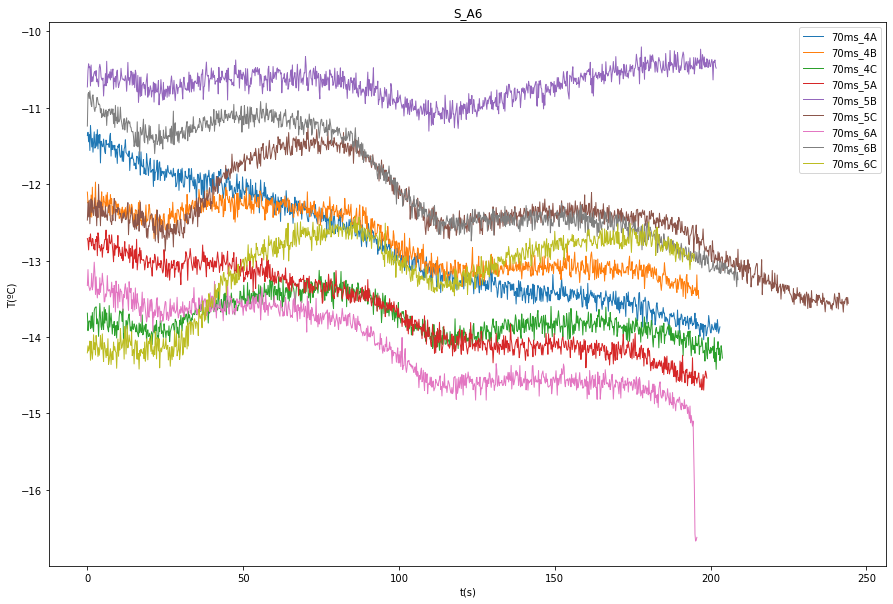

In [14]:
ensayos={}
plt.figure(figsize=(15,10))
for archivo in archivos:
    file=open('rime//'+archivo,'r')
    lineas=file.readlines()
    file.close()
    inicial=int(lineas[0])
    
    texto=''
    
    for linea in range(inicial-1,len(lineas)):
        texto=texto+lineas[linea]+'\n'
    file=open('temporal.txt','w')
    file.write(texto)
    file.close()
    df=pd.read_csv('temporal.txt',sep='\t', decimal=',')
    
    initial_time_hours=float(df[df.columns[0]].loc[0][-14:-12])
    initial_time_minutes=float(df[df.columns[0]].loc[0][-11:-9])
    initial_time_seconds = float(df[df.columns[0]].loc[0][-8:])
    initial_time=3600*initial_time_hours+60*initial_time_minutes+initial_time_seconds
    Time=[]
    for t in df[df.columns[0]]:
        initial_time_hours=float(t[-14:-12])
        initial_time_minutes=float(t[-11:-9])
        initial_time_seconds = float(t[-8:])
        Time.append(3600*initial_time_hours+60*initial_time_minutes+initial_time_seconds-initial_time)
    df.index=Time
    
    columnas=[]
    for columna in df:
        if columna[:3]=='FBG':columnas.append(columna)
    df=df[columnas]
    for col in df:
        
        fbg=np.array(df[col])
        Temperature=[wavelength_to_T(wavelength,col) for wavelength in fbg]
        df['S_'+col[4:6]]=Temperature
    df['S-pta']=df['S_A5']
    ensayos.update({archivo[:-19]:df})
    print(archivo[:-19])
    df['S_A6'].plot(label=archivo[12:-19],linewidth=1)
    
plt.legend()
plt.title('S_A6')
plt.xlabel('t(s)')
plt.ylabel('T(ºC)')
plt.savefig('ensayos_rime_calibracion_nueva.pdf')

In [1]:
ensayos


NameError: name 'ensayos' is not defined

In [13]:
def exponential(t,t0,a,m,tao):
    import numpy as np
    n=6
    return a*(1+m*np.exp(-(t-t0)/tao))/(1+n*np.exp(-(t-t0)/tao))


La derivada temporal de la función: $$\frac{df}{dt}$$

In [17]:
def dexponential(a,m,tao,n,tiempo,t0):
    t=tiempo-t0
    import numpy as np
    A=a/(1+n*np.exp(-t/tao))**2;
    B=(1+n*np.exp(-t/tao))*(-m/tao*np.exp(-t/tao))
    C=-(1+m*np.exp(-t/tao))*(-n/tao*np.exp(-t/tao))
    df=A*(B+C)
    return df

In [9]:
def caracterizar_ensayo(archivo):
    if archivo[-2]=='4':
        MVD=20
    if archivo[-2]=='5':
        MVD=40
    if archivo[-2]=='6':
        MVD=70
    if archivo[-1]=='A':
        LWC=.3
    if archivo[-1]=='B':
        LWC=.6
    if archivo[-1]=='C':
        LWC=.9
    return (LWC,MVD)

In [26]:
S_pta=[]
Time=[]
MVD=[]
LWC=[]
#del ensayos['P2,3 en IWT-70ms-sin spray']
for archivo in ensayos:
    print(archivo)
    df=ensayos[archivo]
    lwc,mvd= caracterizar_ensayo(archivo)
    print(lwc)
    for i in df.index:
        S_pta.append(df['S_B5'].loc[i])
        Time.append(i)
        MVD.append(mvd)
        LWC.append(lwc)

P2,3 en IWT-70ms_4A
0.3
P2,3 en IWT-70ms_4B
0.6
P2,3 en IWT-70ms_4C
0.9
P2,3 en IWT-70ms_5A
0.3
P2,3 en IWT-70ms_5B
0.6
P2,3 en IWT-70ms_5C
0.9
P2,3 en IWT-70ms_6A
0.3
P2,3 en IWT-70ms_6B
0.6
P2,3 en IWT-70ms_6C
0.9


In [27]:
dframe=pd.DataFrame()
dframe['LWC']=LWC
dframe['MVD']=MVD
dframe['S_pta']= S_pta
dframe['Tiempo']=Time

C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in multiply
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in double_scalars
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: overflow encountered in double_scalars
  """
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_l

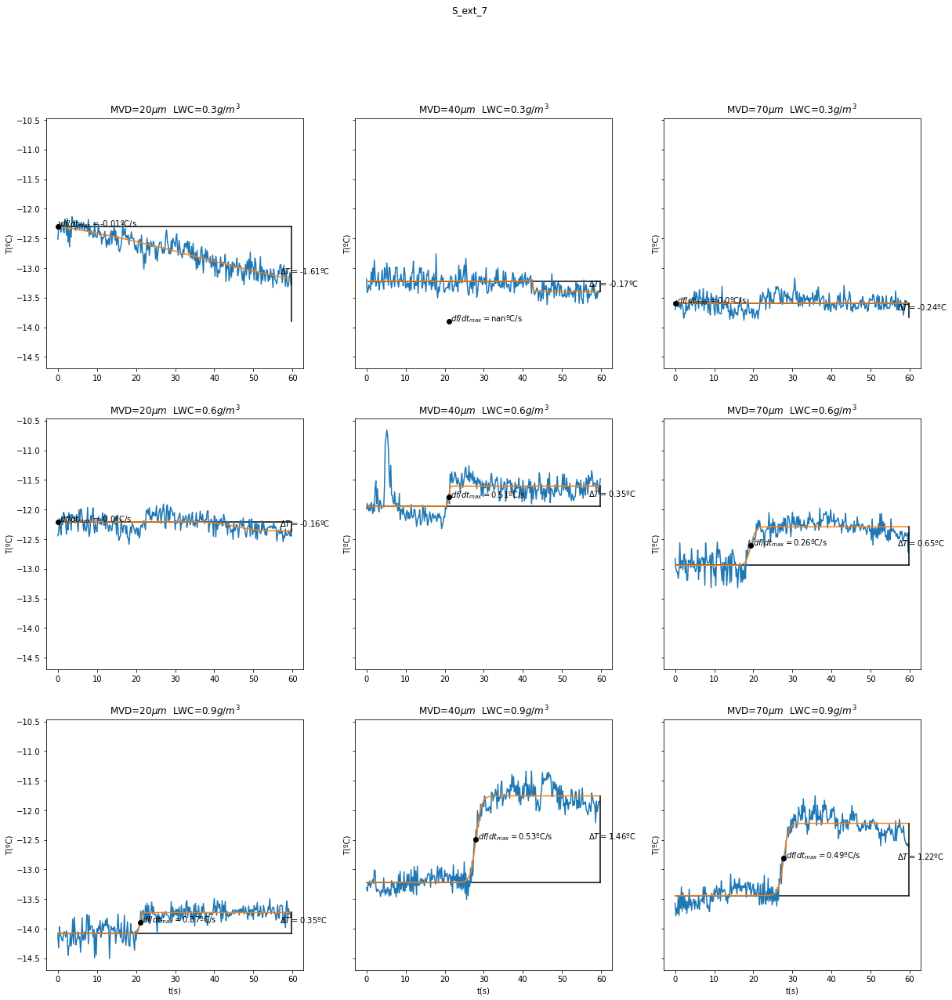

In [28]:
 
tabla=[]
fila=0
columna = 0
fig, ax = plt.subplots(3,3,figsize=(20,20),sharey=True)
fig.suptitle('S_ext_7')
for gota in [20,40,70]:
    
    for contenido in [0.3,0.6,0.9]:
        
        Testeo=dframe[(dframe.MVD==gota)&(dframe.LWC==contenido)&(dframe.Tiempo<60)]
        if len(Testeo)==0:continue
        tiempo=list(Testeo.Tiempo)
        tempe=list((Testeo.S_pta))
        
        disparo_a=float(np.mean(tempe[-20:]))
        popt, pcov = curve_fit(exponential, tiempo, tempe,p0=(tiempo[0],disparo_a,-50,6),maxfev = 100000) 
        senal_aprox_rapido=[]
        t01=popt[0]
        a1=popt[1]
        m1=popt[2]
        #            n1=popt[3]
        tao1=popt[3]
        f=[]
        for t in tiempo:f.append(exponential(t,t01,a1,m1,tao1))
        
        
        df=[]
        for t in tiempo:df.append(dexponential(a1,m1,tao1,6,t,t01))
        maxdf=max(df)
        for d in range(len(df)):
            if df[d]==maxdf:
                t_max=tiempo[d]
                max_f=f[d]
        
        
        ax[fila,columna].plot([tiempo[0],tiempo[-1]],[f[0],f[0]],'k')
        
        ax[fila,columna].plot(tiempo,tempe,tiempo,f)
        ax[fila,columna].plot(t_max,max_f,'ok')
        ax[fila,columna].plot([tiempo[-1],tiempo[-1]],[f[0],f[0]+a1*(1-m1/6)],'k')
        #plt.arrow(tiempo[-1],f[0],0,a1*(1-m1/6)-0.4,head_width=2, head_length=0.4)
        ax[fila,columna].text(tiempo[-1]-3,(f[0]+f[0]+a1*(1-m1/6))/2,r'$\Delta T =$' +str(round(a1*(1-m1/6),2))+'ºC')
        #ax[fila,columna].axis([40,90,min(tempe)-.3,max(tempe)+.3])
        ax[fila,columna].text(t_max+.5,max_f,'$df/dt_{max} =$' +str(round(maxdf,2))+'ºC/s')
        if fila==2:ax[fila,columna].set_xlabel('t(s)')
        ax[fila,columna].set_ylabel('T(ºC)')
        ax[fila,columna].set_title('MVD='+str(gota)+'$\mu m$  LWC='+ str(contenido)+'$g/m^{3}$')
        tabla.append([gota,contenido,round(f[0],2),round(a1*(1-m1/6),2),round(maxdf,2)] )
        fila+=1
    fila=0
    columna+=1
plt.savefig('ensayos_rime_nueva_cal2.pdf')

In [29]:
pd.DataFrame(data=tabla,columns=['MVD','LWC','T_0','Delta_T','df_dt_max'])

,MVD,LWC,T_0,Delta_T,df_dt_max
0,20,0.3,-12.30,-1.61,-0.01
1,20,0.6,-12.21,-0.16,-0.00
2,20,0.9,-14.08,0.35,0.37
3,40,0.3,-13.22,-0.17,NaN
4,40,0.6,-11.95,0.35,0.51
5,40,0.9,-13.22,1.46,0.53
6,70,0.3,-13.59,-0.24,0.00
7,70,0.6,-12.94,0.65,0.26
8,70,0.9,-13.44,1.22,0.49


# Glaze usando nuevas calibraciones (P3)

Se carga el objeto pickle

In [10]:
import pickle
Calibracion = pd.read_pickle('calibracion_3.pickle')
Calibracion.index=Calibracion.sensor
Calibracion=Calibracion.drop(columns=['sensor'])
Calibracion

,A,B,C,D
sensor,,,,
FBG_A1 (nm),-44.928533,204936.301776,-3.115976e+08,1.579239e+11
FBG_A2 (nm),8.908830,-40734.969039,6.208597e+07,-3.154271e+10
FBG_A3 (nm),4.475960,-20512.973834,3.133654e+07,-1.595708e+10
FBG_A4 (nm),-5.597499,25660.078644,-3.921021e+07,1.997182e+10
FBG_A5 (nm),7.728141,-35545.756924,5.449793e+07,-2.785170e+10
FBG_A6 (nm),35.666894,-164294.025093,2.522651e+08,-1.291135e+11


In [11]:
archivos = os.listdir('ensayos_glaze_2')
print(archivos)
#del archivos[0]
sensor_estudiado='S_A6'


['P3-1_Glaze-4A.20200428120142.txt', 'P3-1_Glaze-4B.20200428113512.txt', 'P3-1_Glaze-4C.20200428123351.txt', 'P3-1_Glaze-5A.20200428115339.txt', 'P3-1_Glaze-5B.20200428112608.txt', 'P3-1_Glaze-5C.20200428122448.txt', 'P3-1_Glaze-6A.20200428114350.txt', 'P3-1_Glaze-6B.20200428111629.txt', 'P3-1_Glaze-6C.20200428121509.txt']


In [12]:
def wavelength_to_T(wavelength,sensor):
    global Calibracion
    C=Calibracion.loc[sensor]
    return (C['A']*wavelength**3+C['B']*wavelength**2+C['C']*wavelength+C['D'])

P3-1_Glaze-4A
P3-1_Glaze-4B
P3-1_Glaze-4C
P3-1_Glaze-5A
P3-1_Glaze-5B
P3-1_Glaze-5C
P3-1_Glaze-6A
P3-1_Glaze-6B
P3-1_Glaze-6C


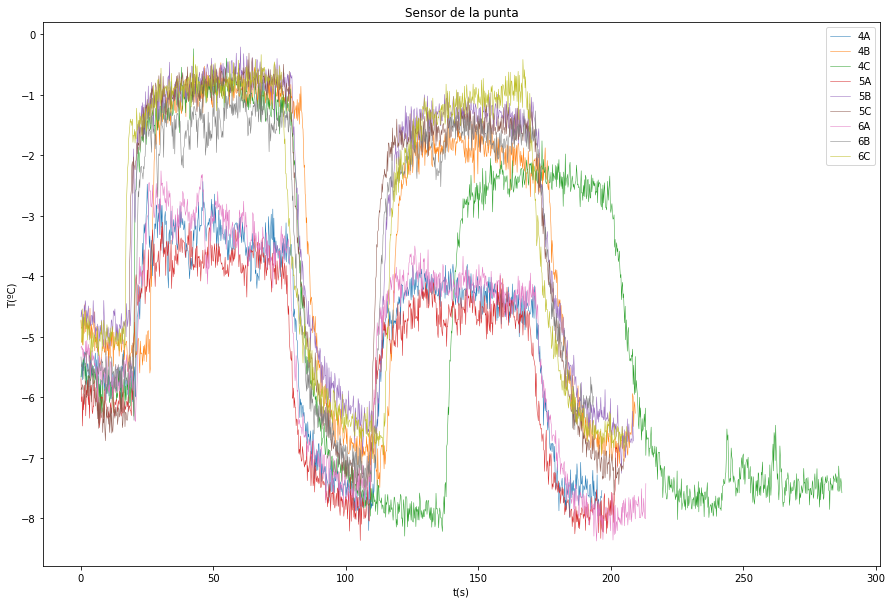

In [13]:
ensayos={}
plt.figure(figsize=(15,10))
for archivo in archivos:
    file=open('ensayos_glaze_2//'+archivo,'r')
    lineas=file.readlines()
    file.close()
    inicial=int(lineas[0])
    
    texto=''
    
    for linea in range(inicial-1,len(lineas)):
        texto=texto+lineas[linea]+'\n'
    file=open('temporal.txt','w')
    file.write(texto)
    file.close()
    df=pd.read_csv('temporal.txt',sep='\t', decimal=',')
    
    initial_time_hours=float(df[df.columns[0]].loc[0][-14:-12])
    initial_time_minutes=float(df[df.columns[0]].loc[0][-11:-9])
    initial_time_seconds = float(df[df.columns[0]].loc[0][-8:])
    initial_time=3600*initial_time_hours+60*initial_time_minutes+initial_time_seconds
    Time=[]
    for t in df[df.columns[0]]:
        initial_time_hours=float(t[-14:-12])
        initial_time_minutes=float(t[-11:-9])
        initial_time_seconds = float(t[-8:])
        Time.append(3600*initial_time_hours+60*initial_time_minutes+initial_time_seconds-initial_time)
    df.index=Time
    
    columnas=[]
    for columna in df:
        if columna[:3]=='FBG':columnas.append(columna)
    df=df[columnas]
    for col in df:
        
        fbg=np.array(df[col])
        Temperature=[wavelength_to_T(wavelength,col) for wavelength in fbg]
        df['S_'+col[4:6]]=Temperature
    df['S-pta']=df[sensor_estudiado]
    ensayos.update({archivo[:-19]:df})
    print(archivo[:-19])
    df[sensor_estudiado].plot(label=archivo[11:-19],linewidth=0.5)
    
plt.legend()
plt.title('Sensor de la punta')
plt.xlabel('t(s)')
plt.ylabel('T(ºC)')
plt.savefig('resultados_29_04//'+sensor_estudiado+'ensayos_glaze_calibracion_nueva.svg')

In [32]:
def exponential(t,t0,a,m,tao,t_2,m_2,tao_2):
    import numpy as np
    n=6
    return a*(1+m*np.exp(-(t-t0)/tao))/(1+n*np.exp(-(t-t0)/tao))*(1+m_2*np.exp(-(t-t_2)/tao_2))/(1+n*np.exp(-(t-t_2)/tao_2))


Se asocia el archivo con el tipo de ensayo:

In [36]:
def caracterizar_ensayo(archivo):
    if archivo[-2]=='4':
        MVD=20
    if archivo[-2]=='5':
        MVD=40
    if archivo[-2]=='6':
        MVD=70
    if archivo[-1]=='A':
        LWC=.3
    if archivo[-1]=='B':
        LWC=.6
    if archivo[-1]=='C':
        LWC=.9
    return (LWC,MVD)

Se quita el ensayo de sin spray y se guardan todos los datos en listas. Luego se recopila en un DataFrame

In [35]:
S_pta=[]
Time=[]
MVD=[]
LWC=[]
#del ensayos['P2,3 en IWT-70ms-sin spray']
for archivo in ensayos:
    print(archivo)
    df=ensayos[archivo]
    lwc,mvd= caracterizar_ensayo(archivo)
    print(lwc)
    for i in df.index:
        S_pta.append(df[sensor_estudiado].loc[i])
        Time.append(i)
        MVD.append(mvd)
        LWC.append(lwc)

P3-1_Glaze-4A
0.3
P3-1_Glaze-4B
0.6
P3-1_Glaze-4C
0.9
P3-1_Glaze-5A
0.3
P3-1_Glaze-5B
0.6
P3-1_Glaze-5C
0.9
P3-1_Glaze-6A
0.3
P3-1_Glaze-6B
0.6
P3-1_Glaze-6C
0.9


In [37]:
dframe=pd.DataFrame()
dframe['LWC']=LWC
dframe['MVD']=MVD
dframe['S_pta']= S_pta
dframe['Tiempo']=Time

C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in multiply
  after removing the cwd from sys.path.


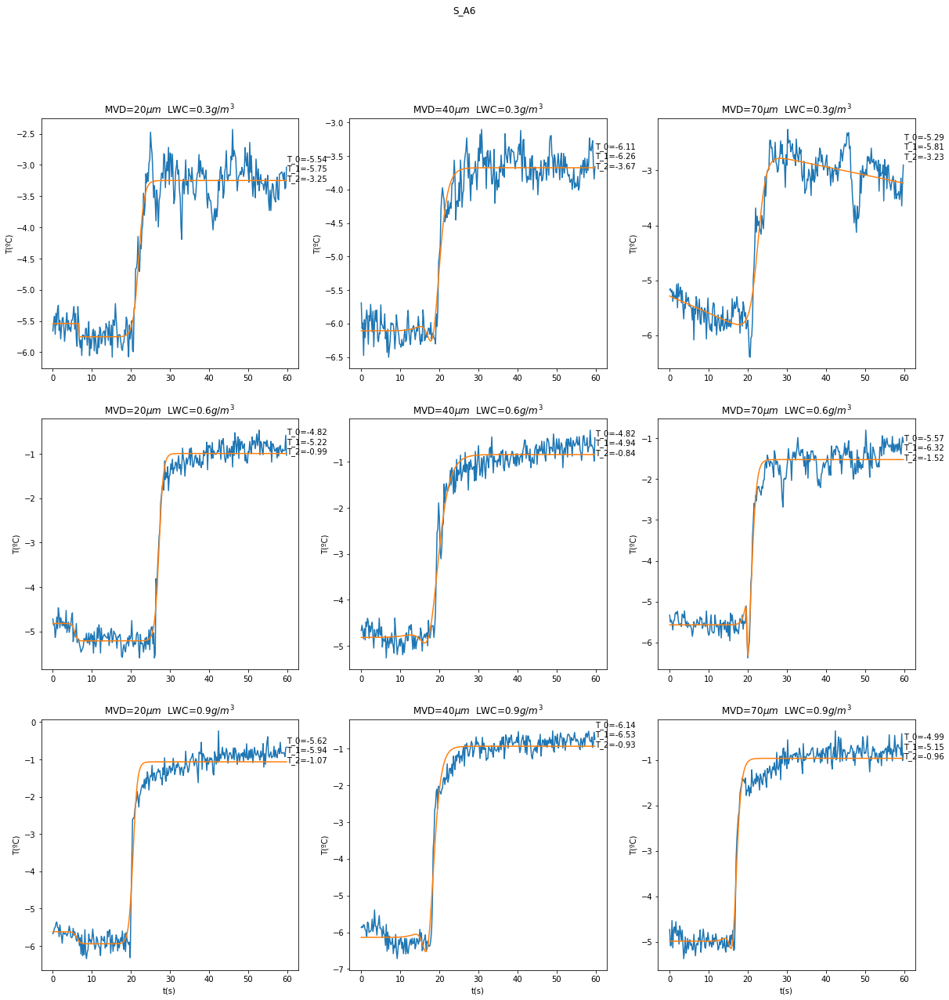

In [38]:
tabla=[]
fila=0
columna = 0
fig, ax = plt.subplots(3,3, sharey=False,figsize=(20,20))
fig.suptitle(sensor_estudiado)
for gota in [20,40,70]:
    
    for contenido in [0.3,0.6,0.9]:
        
        Testeo=dframe[(dframe.MVD==gota)&(dframe.LWC==contenido)&(dframe.Tiempo<60)]
        if len(Testeo)==0:continue
        tiempo=list(Testeo.Tiempo)
        tempe=list((Testeo.S_pta))
        
        disparo_a=float(np.mean(tempe[-20:]))
        disparo_m2=float(6/disparo_a*min(tempe))
        disparo_m1=float(tempe[0]*6**2/disparo_a/disparo_m2)
        popt, pcov = curve_fit(exponential, tiempo, tempe,p0=(tiempo[0],disparo_a,
                                                              disparo_m1,6,tiempo[0]+10,disparo_m2,6),maxfev = 1000000) 
        senal_aprox_rapido=[]
        t01=popt[0]
        a1=popt[1]
        m1=popt[2]
        tao1=popt[3]
        t02=popt[4]
        m2=popt[5]
        tao2=popt[6]
        f=[]
        for t in tiempo:f.append(exponential(t,t01,a1,m1,tao1,popt[4],popt[5],popt[6]))
               
               
        ax[fila,columna].plot(tiempo,tempe,tiempo,f)
 
        
        texto_grafica='T_0='+str(round(f[0],2))+'\n'+'T_1='+str(round(min(f),2))+'\n'+'T_2='+str(round(f[-1],2))
        ax[fila,columna].text(max(tiempo),max(f),texto_grafica)
        if fila==2:ax[fila,columna].set_xlabel('t(s)')
        ax[fila,columna].set_ylabel('T(ºC)')
        ax[fila,columna].set_title('MVD='+str(gota)+'$\mu m$  LWC='+ str(contenido)+'$g/m^{3}$')
        tabla.append([gota,contenido,round(f[0],2),round(min(f)-f[0],2),round(f[-1]-min(f),2)])
        fila+=1
    fila=0
    columna+=1
plt.savefig('resultados_29_04//'+sensor_estudiado+'ensayos_glaze_curvas.pdf')

In [39]:
pd.DataFrame(data=tabla,columns=['MVD','LWC','T_0','bajada','subida'])

,MVD,LWC,T_0,bajada,subida
0,20,0.3,-5.54,-0.21,2.50
1,20,0.6,-4.82,-0.39,4.22
2,20,0.9,-5.62,-0.32,4.88
3,40,0.3,-6.11,-0.15,2.59
4,40,0.6,-4.82,-0.12,4.10
5,40,0.9,-6.14,-0.39,5.59
6,70,0.3,-5.29,-0.52,2.58
7,70,0.6,-5.57,-0.75,4.80
8,70,0.9,-4.99,-0.16,4.18


# Rime

En Rime se hace lo mismo $\textbf{pero faltan ensayos}$

In [3]:
archivos = os.listdir('rvnuevosdatos2xciclosenrimep3_5b')
print(archivos)


['ens P3-5 _-13-4A-2.20200604135220.txt', 'ens P3-5 _-13-4B-2.20200604131758.txt', 'ens P3-5 _-13-4C-2.20200604124318.txt', 'ens P3-5 _-13-5A-2.20200604134139.txt', 'ens P3-5 _-13-5B-2.20200604130617.txt', 'ens P3-5 _-13-5C-2.20200604123118.txt', 'ens P3-5 _-13-6A-2.20200604133020.txt', 'ens P3-5 _-13-6B-2.20200604125458.txt', 'ens P3-5 _-13-6C-2.20200604121859.txt']


In [4]:
import seaborn as sns

ens P3-5 _-13-4A
ens P3-5 _-13-4B
ens P3-5 _-13-4C
ens P3-5 _-13-5A
ens P3-5 _-13-5B
ens P3-5 _-13-5C
ens P3-5 _-13-6A
ens P3-5 _-13-6B
ens P3-5 _-13-6C


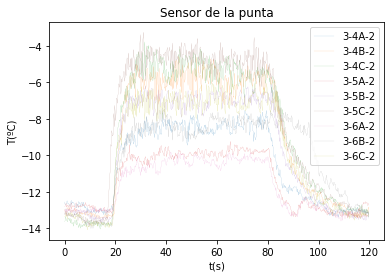

In [5]:
ensayos={}
for archivo in archivos:
    file=open('rvnuevosdatos2xciclosenrimep3_5b//'+archivo,'r')
    lineas=file.readlines()
    file.close()
    inicial=int(lineas[0])
    
    texto=''
    
    for linea in range(inicial-1,len(lineas)):
        texto=texto+lineas[linea]+'\n'
    file=open('temporal.txt','w')
    file.write(texto)
    file.close()
    df=pd.read_csv('temporal.txt',sep='\t', decimal=',')
  
    initial_time_hours=float(df[df.columns[0]].loc[0][-14:-12])
    initial_time_minutes=float(df[df.columns[0]].loc[0][-11:-9])
    initial_time_seconds = float(df[df.columns[0]].loc[0][-8:])
    initial_time=3600*initial_time_hours+60*initial_time_minutes+initial_time_seconds
    Time=[]
    for t in df[df.columns[0]]:
        initial_time_hours=float(t[-14:-12])
        initial_time_minutes=float(t[-11:-9])
        initial_time_seconds = float(t[-8:])
        Time.append(3600*initial_time_hours+60*initial_time_minutes+initial_time_seconds-initial_time)
    df.index=Time
    df['Tiempo']=Time
    df = df[df.Tiempo<120]
    ensayos.update({archivo[:-21]:df})
    print(archivo[:-21])
    df['A8'].plot(label=archivo[12:-19],linewidth=0.1)
plt.legend()
plt.title('Sensor de la punta')
plt.xlabel('t(s)')
plt.ylabel('T(ºC)')
plt.savefig('ensayos_rime.pdf')

Se define la función de regresión como:

$$f(t)=a \frac{1 + m \exp(-(t-t_0)/\tau)}{ 1 + n \exp(-(t-t_0)/\tau)}$$

In [6]:
def exponential(t,t0,a,m,tao):
    import numpy as np
    n=6
    return a*(1+m*np.exp(-(t-t0)/tao))/(1+n*np.exp(-(t-t0)/tao))


La derivada temporal de la función: $$\frac{df}{dt}$$

In [7]:
def dexponential(a,m,tao,n,tiempo,t0):
    t=tiempo-t0
    import numpy as np
    A=a/(1+n*np.exp(-t/tao))**2;
    B=(1+n*np.exp(-t/tao))*(-m/tao*np.exp(-t/tao))
    C=-(1+m*np.exp(-t/tao))*(-n/tao*np.exp(-t/tao))
    df=A*(B+C)
    return df

In [8]:
def caracterizar_ensayo(archivo):
    if archivo[-2]=='4':
        MVD=20
    if archivo[-2]=='5':
        MVD=40
    if archivo[-2]=='6':
        MVD=70
    if archivo[-1]=='A':
        LWC=.3
    if archivo[-1]=='B':
        LWC=.6
    if archivo[-1]=='C':
        LWC=.9
    return (LWC,MVD)

In [28]:
S_pta=[]
Time=[]
MVD=[]
LWC=[]
#del ensayos['P2,3 en IWT-70ms-sin spray']
for archivo in ensayos:
    print(archivo)
    df=ensayos[archivo]
    lwc,mvd= caracterizar_ensayo(archivo)
    print(lwc)
    for i in df.index:
        S_pta.append(df['A8'].loc[i])
        Time.append(i)
        MVD.append(mvd)
        LWC.append(lwc)

ens P3-5 _-13-4A
0.3
ens P3-5 _-13-4B
0.6
ens P3-5 _-13-4C
0.9
ens P3-5 _-13-5A
0.3
ens P3-5 _-13-5B
0.6
ens P3-5 _-13-5C
0.9
ens P3-5 _-13-6A
0.3
ens P3-5 _-13-6B
0.6
ens P3-5 _-13-6C
0.9


In [29]:
dframe=pd.DataFrame()
dframe['LWC']=LWC
dframe['MVD']=MVD
dframe['S_pta']= S_pta
dframe['Tiempo']=Time

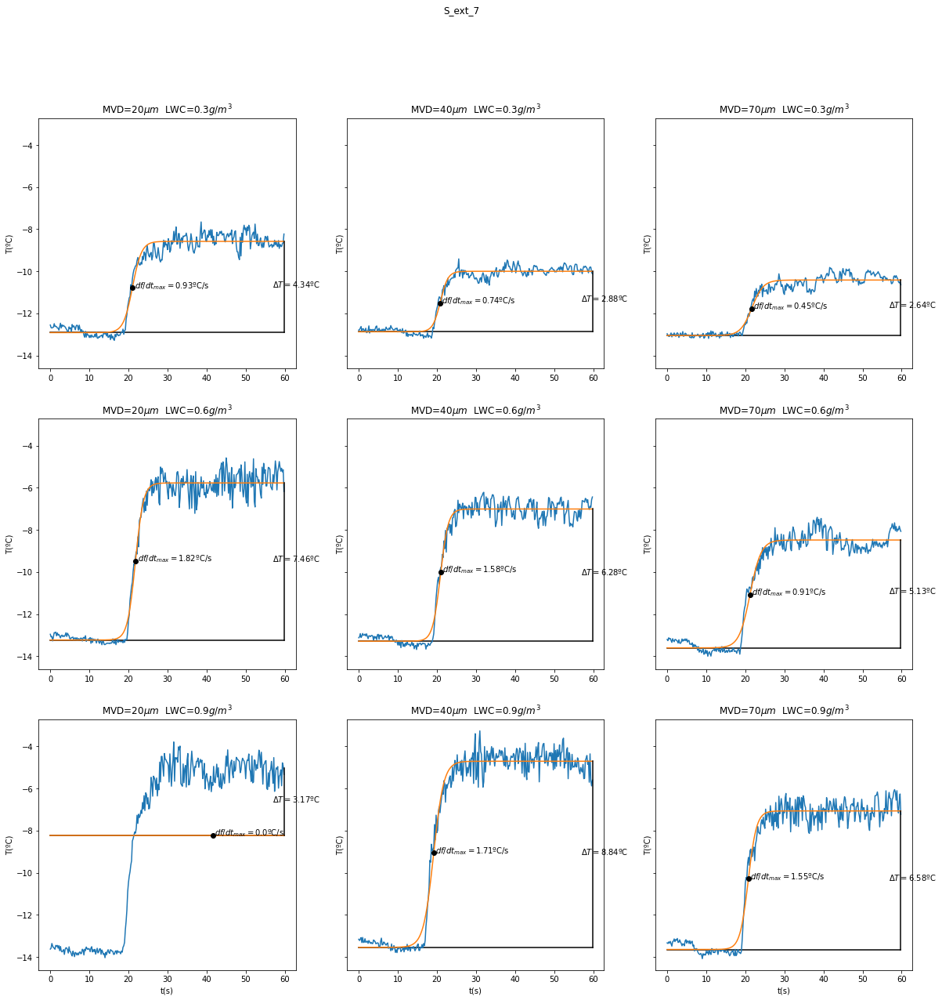

In [30]:
 
tabla=[]
fila=0
columna = 0
fig, ax = plt.subplots(3,3,figsize=(20,20),sharey=True)
fig.suptitle('S_ext_7')
for gota in [20,40,70]:
    
    for contenido in [0.3,0.6,0.9]:
        
        Testeo=dframe[(dframe.MVD==gota)&(dframe.LWC==contenido)&(dframe.Tiempo<60)]
        if len(Testeo)==0:continue
        tiempo=list(Testeo.Tiempo)
        tempe=list((Testeo.S_pta))
        
        disparo_a=float(np.mean(tempe[-20:]))
        popt, pcov = curve_fit(exponential, tiempo, tempe,p0=(tiempo[0],disparo_a,-90,6),maxfev = 100000) 
        senal_aprox_rapido=[]
        t01=popt[0]
        a1=popt[1]
        m1=popt[2]
        #            n1=popt[3]
        tao1=popt[3]
        f=[]
        for t in tiempo:f.append(exponential(t,t01,a1,m1,tao1))
        
        
        df=[]
        for t in tiempo:df.append(dexponential(a1,m1,tao1,6,t,t01))
        maxdf=max(df)
        for d in range(len(df)):
            if df[d]==maxdf:
                t_max=tiempo[d]
                max_f=f[d]
        
        
        ax[fila,columna].plot([tiempo[0],tiempo[-1]],[f[0],f[0]],'k')
        
        ax[fila,columna].plot(tiempo,tempe,tiempo,f)
        ax[fila,columna].plot(t_max,max_f,'ok')
        ax[fila,columna].plot([tiempo[-1],tiempo[-1]],[f[0],f[0]+a1*(1-m1/6)],'k')
        #plt.arrow(tiempo[-1],f[0],0,a1*(1-m1/6)-0.4,head_width=2, head_length=0.4)
        ax[fila,columna].text(tiempo[-1]-3,(f[0]+f[0]+a1*(1-m1/6))/2,r'$\Delta T =$' +str(round(a1*(1-m1/6),2))+'ºC')
        #ax[fila,columna].axis([40,90,min(tempe)-.3,max(tempe)+.3])
        ax[fila,columna].text(t_max+.5,max_f,'$df/dt_{max} =$' +str(round(maxdf,2))+'ºC/s')
        if fila==2:ax[fila,columna].set_xlabel('t(s)')
        ax[fila,columna].set_ylabel('T(ºC)')
        ax[fila,columna].set_title('MVD='+str(gota)+'$\mu m$  LWC='+ str(contenido)+'$g/m^{3}$')
        tabla.append([gota,contenido,round(f[0],2),round(a1*(1-m1/6),2),round(maxdf,2)] )
        fila+=1
    fila=0
    columna+=1
plt.savefig('ensayos_rime2.pdf')

A1


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in multiply
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in double_scalars
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: overflow encountered in double_scalars
  """
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_l

A2


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in multiply
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in double_scalars
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: overflow encountered in double_scalars
  """
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_l

A3


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in multiply
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in double_scalars
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: overflow encountered in double_scalars
  """
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_l

A4
A5


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.


A6


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\scipy\optimize\minpack.py:808: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


A7
A8


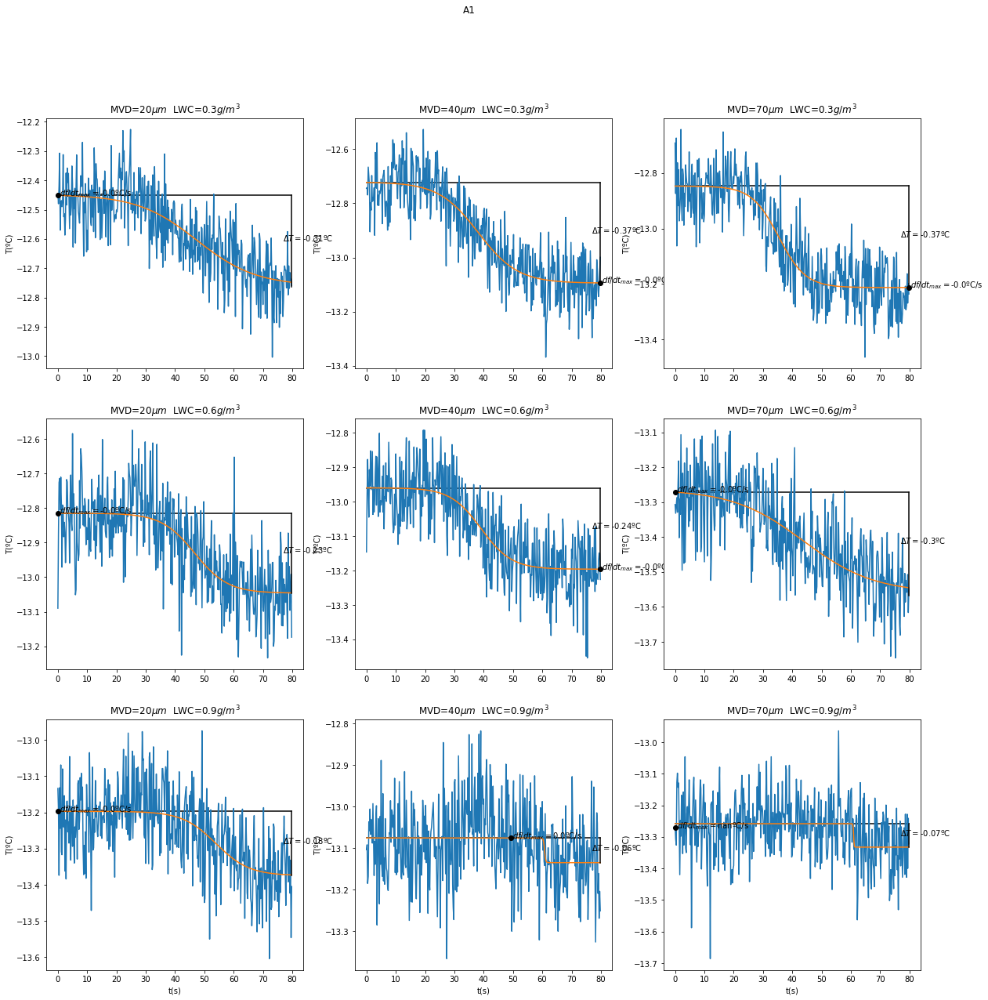

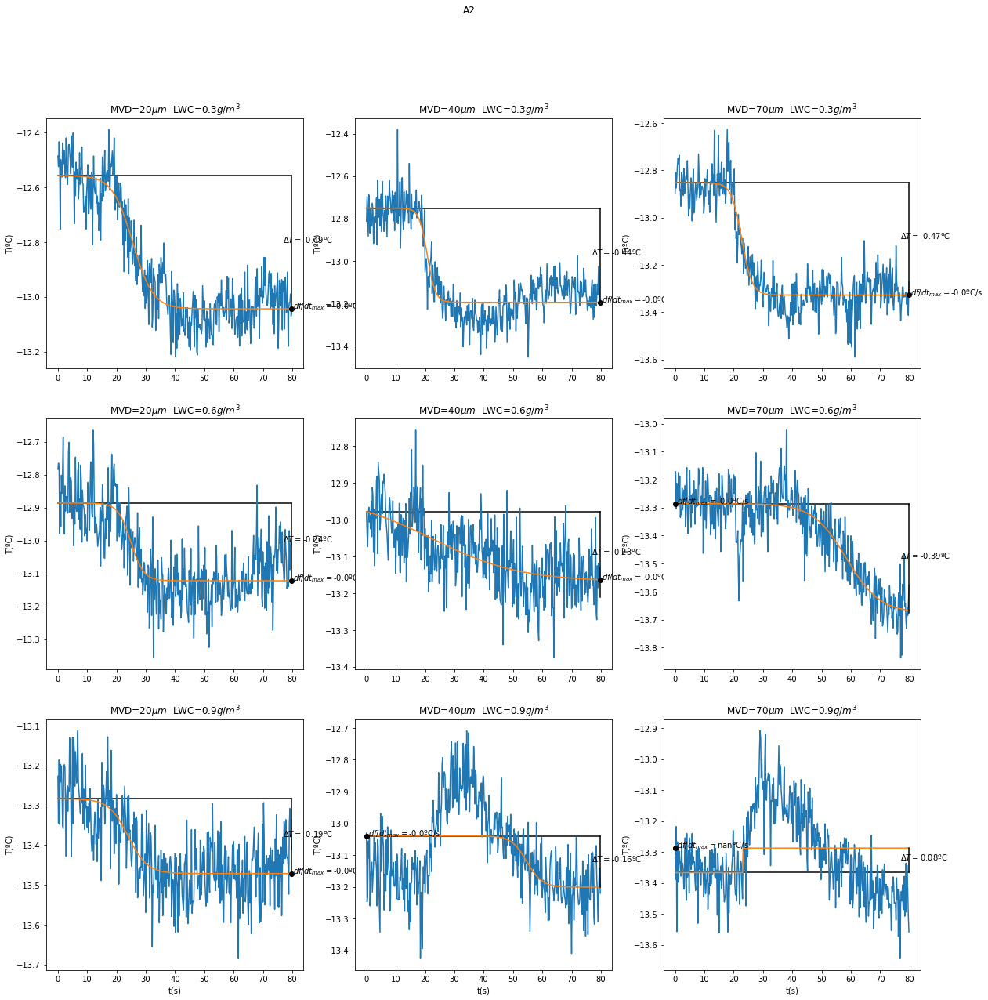

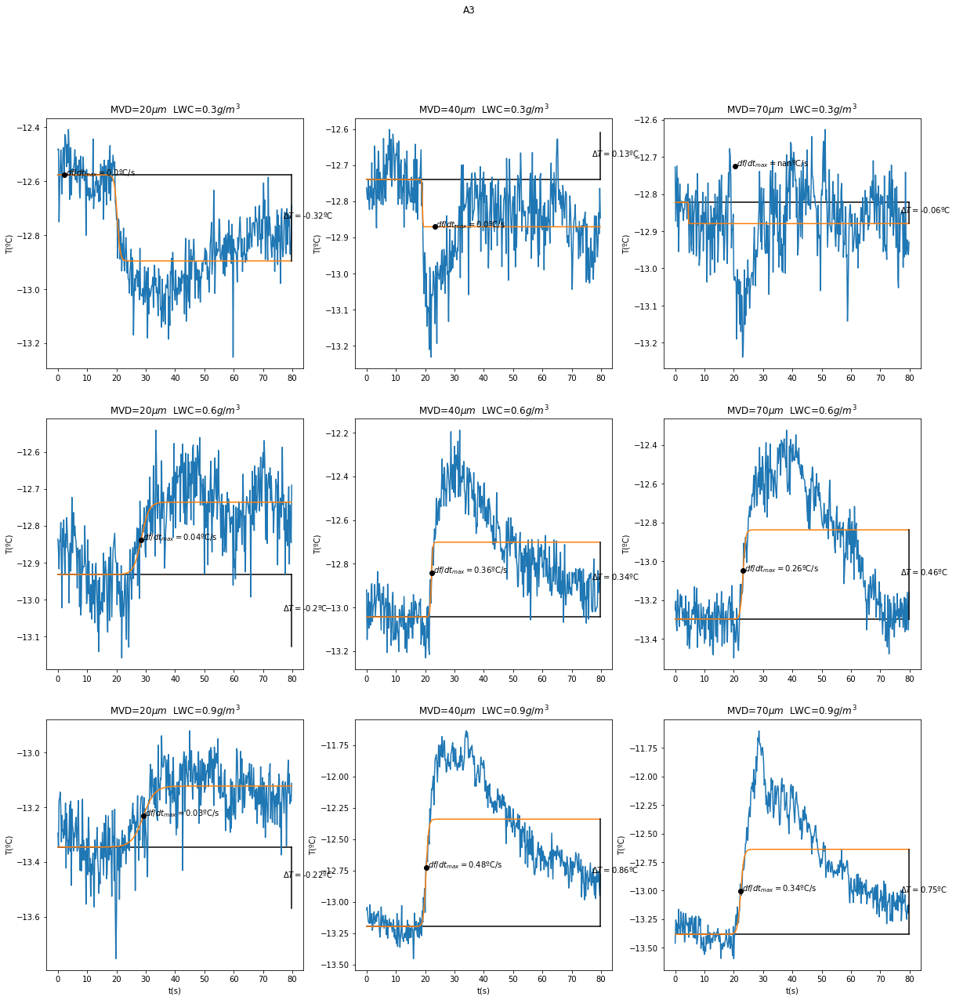

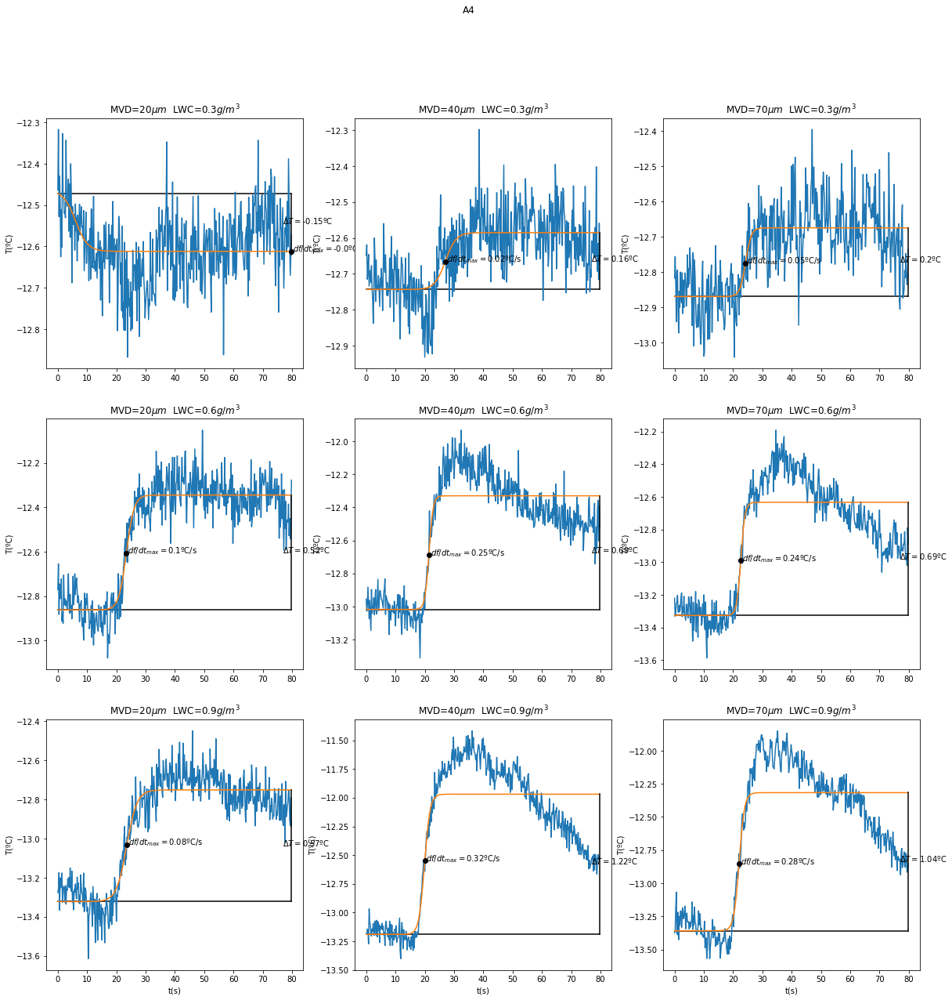

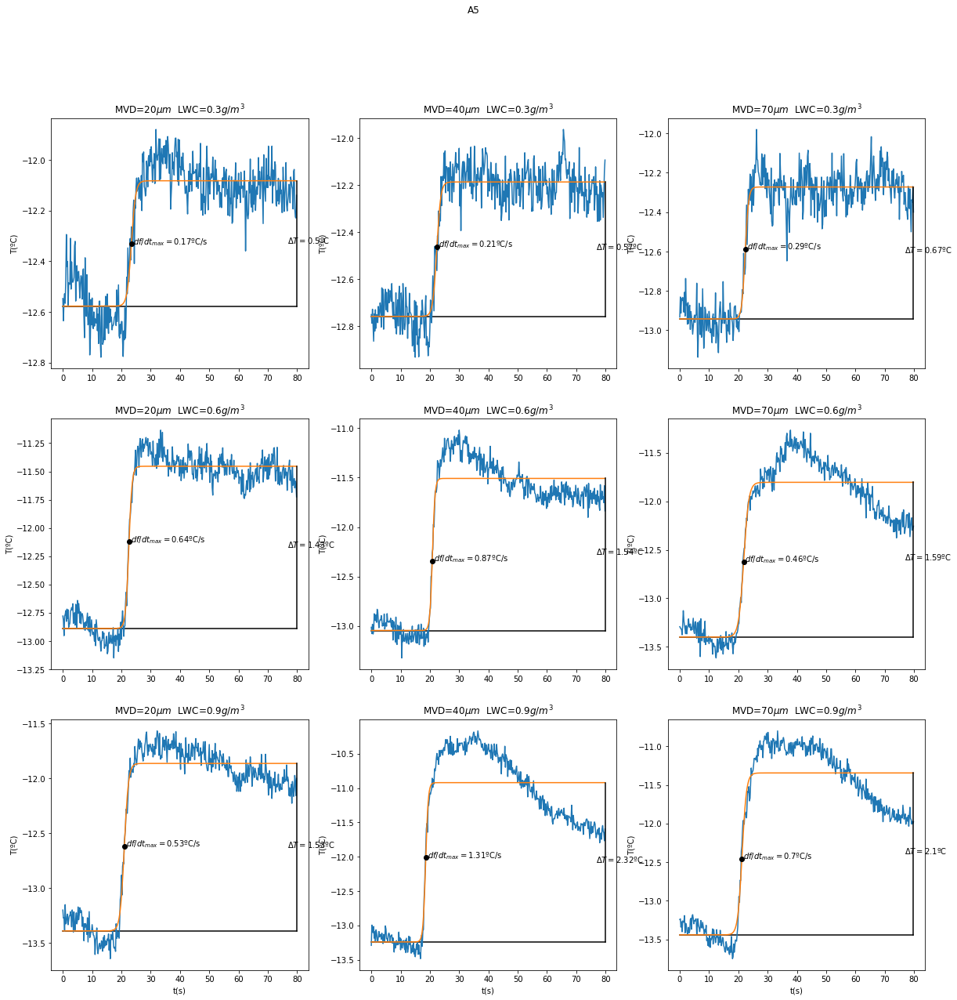

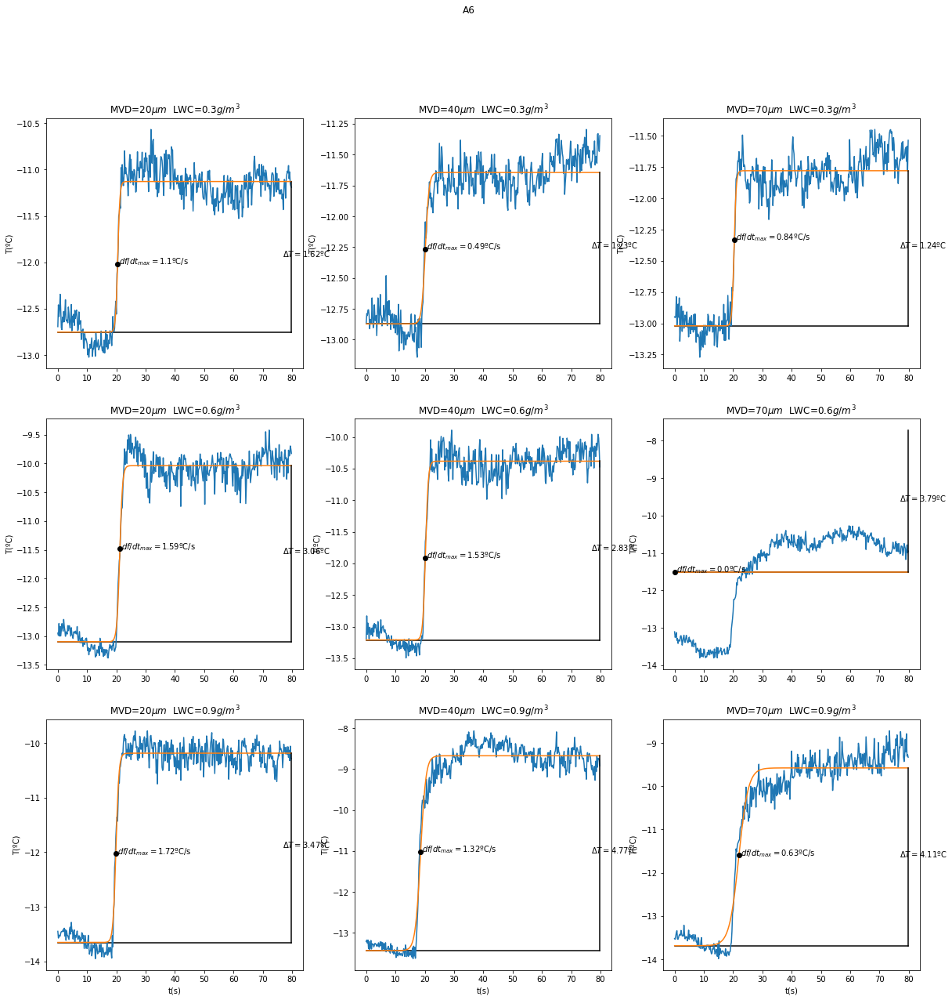

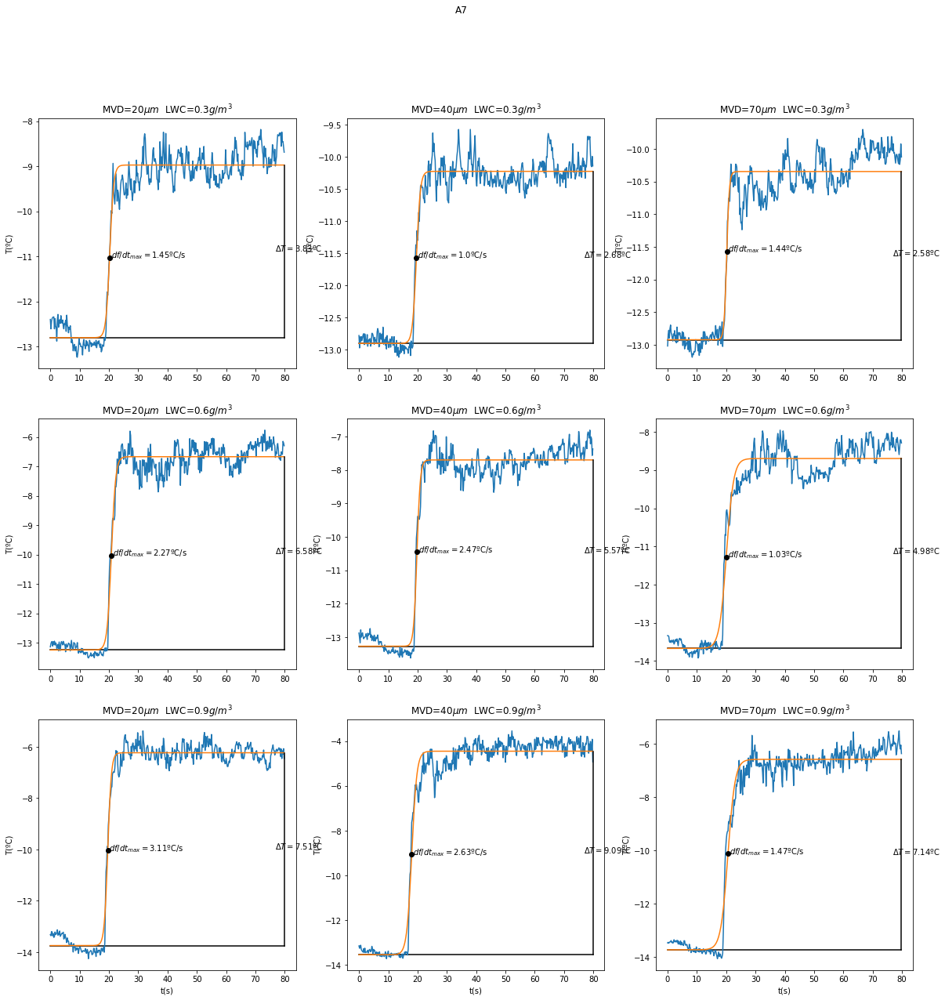

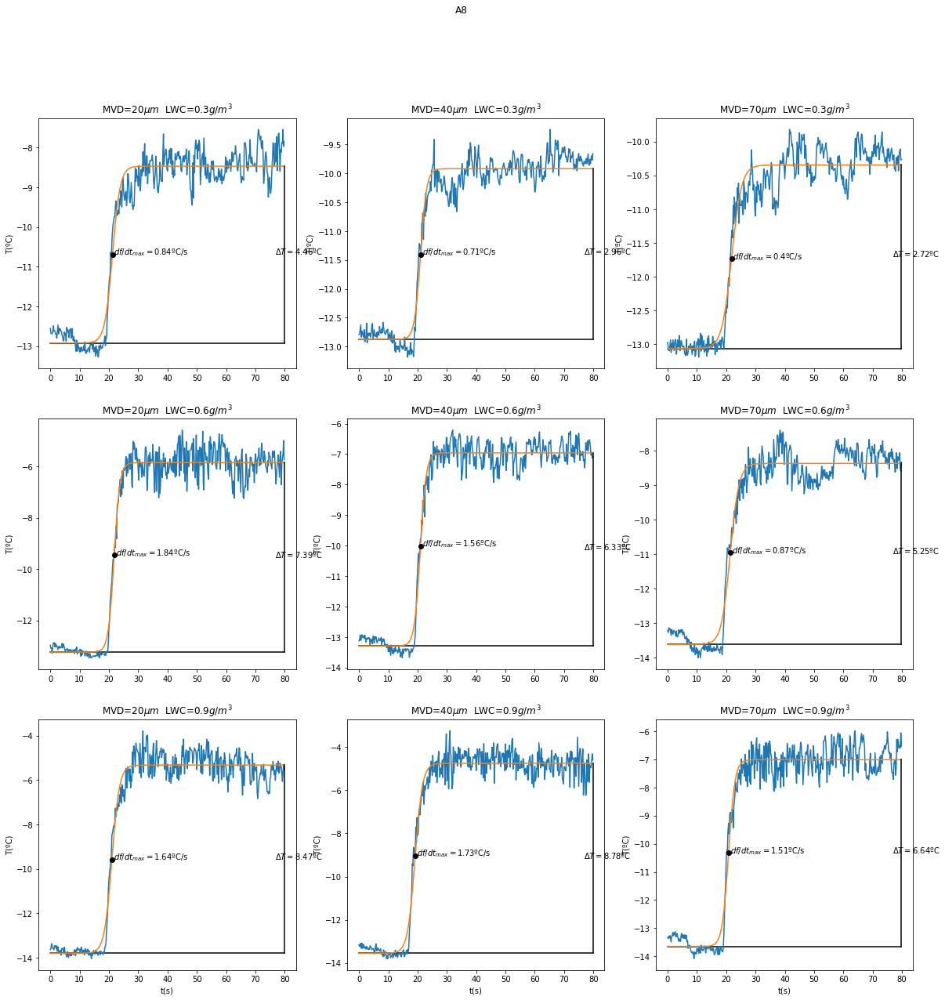

In [9]:
tabla=[]
for sensor in ['A1', 'A2', 'A3', 'A4', 'A5', 'A6', 'A7', 'A8']:
    print(sensor)
    S_pta=[]
    Time=[]
    MVD=[]
    LWC=[]
    for archivo in ensayos:
        df=ensayos[archivo]
        lwc,mvd= caracterizar_ensayo(archivo)
        for i in df.index:
            S_pta.append(df[sensor].loc[i])
            Time.append(i)
            MVD.append(mvd)
            LWC.append(lwc)
    dframe=pd.DataFrame()
    dframe['LWC']=LWC
    dframe['MVD']=MVD
    dframe['S_pta']= S_pta
    dframe['Tiempo']=Time

    fila=0
    columna = 0
    fig, ax = plt.subplots(3,3, sharey=False,figsize=(20,20))
    fig.suptitle(sensor)
    for gota in [20,40,70]:
        
        for contenido in [0.3,0.6,0.9]:
            
            Testeo=dframe[(dframe.MVD==gota)&(dframe.LWC==contenido)&(dframe.Tiempo<80)]
            if len(Testeo)==0:continue
            tiempo=list(Testeo.Tiempo)
            tempe=list((Testeo.S_pta))

            disparo_a=float(np.mean(tempe[-20:]))
            popt, pcov = curve_fit(exponential, tiempo, tempe,p0=(tiempo[0],disparo_a,-50,6),maxfev = 100000) 
            senal_aprox_rapido=[]
            t01=popt[0]
            a1=popt[1]
            m1=popt[2]
            #            n1=popt[3]
            tao1=popt[3]
            f=[]
            for t in tiempo:f.append(exponential(t,t01,a1,m1,tao1))


            df=[]
            for t in tiempo:df.append(dexponential(a1,m1,tao1,6,t,t01))
            maxdf=max(df)
            for d in range(len(df)):
                if df[d]==maxdf:
                    t_max=tiempo[d]
                    max_f=f[d]


            ax[fila,columna].plot([tiempo[0],tiempo[-1]],[f[0],f[0]],'k')

            ax[fila,columna].plot(tiempo,tempe,tiempo,f)
            ax[fila,columna].plot(t_max,max_f,'ok')
            ax[fila,columna].plot([tiempo[-1],tiempo[-1]],[f[0],f[0]+a1*(1-m1/6)],'k')
            #plt.arrow(tiempo[-1],f[0],0,a1*(1-m1/6)-0.4,head_width=2, head_length=0.4)
            ax[fila,columna].text(tiempo[-1]-3,(f[0]+f[0]+a1*(1-m1/6))/2,r'$\Delta T =$' +str(round(a1*(1-m1/6),2))+'ºC')
            #ax[fila,columna].axis([40,90,min(tempe)-.3,max(tempe)+.3])
            ax[fila,columna].text(t_max+.5,max_f,'$df/dt_{max} =$' +str(round(maxdf,2))+'ºC/s')
            if fila==2:ax[fila,columna].set_xlabel('t(s)')
            ax[fila,columna].set_ylabel('T(ºC)')
            ax[fila,columna].set_title('MVD='+str(gota)+'$\mu m$  LWC='+ str(contenido)+'$g/m^{3}$')
            tabla.append([sensor,gota,contenido,round(f[0],2),round(a1*(1-m1/6),2),round(maxdf,2)] )
            fila+=1
        fila=0
        columna+=1
    plt.savefig('Resultados_sensor_mayo//rime//'+sensor+'.pdf')


In [12]:
BD_glaze=pd.DataFrame(data=tabla,columns=['sensor','MVD','LWC','T_0','Delta_T','dT'])
BD_glaze.to_csv('Resultados_sensor_mayo//rime//basededatos.csv')

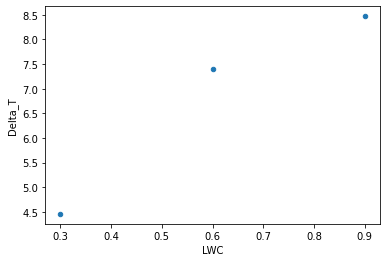

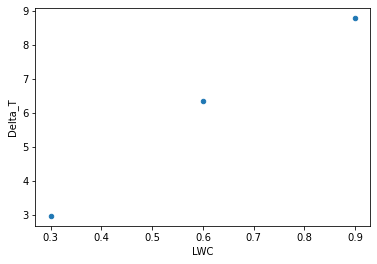

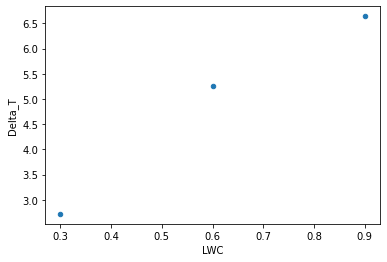

In [13]:
for mvd in [20,40,70]:
    BD_glaze[(BD_glaze['sensor']=='A8')&(BD_glaze['MVD']==mvd)].plot.scatter(x='LWC',y='Delta_T')

In [14]:
archivos = os.listdir('rv_nuevos_ensayos')
print(archivos)


['P3-5 _-13-4A-1.20200604120742.txt', 'P3-5 _-13-4B-1.20200604110155.txt', 'P3-5 _-13-4C-1.20200604102300.txt', 'P3-5 _-13-5A-1.20200604115519.txt', 'P3-5 _-13-5B-1.20200604104955.txt', 'P3-5 _-13-5C-1.20200604100955.txt', 'P3-5 _-13-6A-1.20200604114012.txt', 'P3-5 _-13-6B-1.20200604103504.txt', 'P3-5 _-13-6C-1.20200604095714.txt']


In [15]:
import seaborn as sns

P3-5 _-13-4A
P3-5 _-13-4B
P3-5 _-13-4C
P3-5 _-13-5A
P3-5 _-13-5B
P3-5 _-13-5C
P3-5 _-13-6A
P3-5 _-13-6B
P3-5 _-13-6C


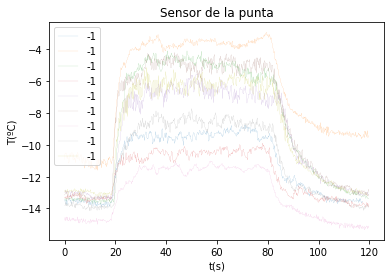

In [16]:
ensayos={}
for archivo in archivos:
    file=open('rv_nuevos_ensayos//'+archivo,'r')
    lineas=file.readlines()
    file.close()
    inicial=int(lineas[0])
    
    texto=''
    
    for linea in range(inicial-1,len(lineas)):
        texto=texto+lineas[linea]+'\n'
    file=open('temporal.txt','w')
    file.write(texto)
    file.close()
    df=pd.read_csv('temporal.txt',sep='\t', decimal=',')
  
    initial_time_hours=float(df[df.columns[0]].loc[0][-14:-12])
    initial_time_minutes=float(df[df.columns[0]].loc[0][-11:-9])
    initial_time_seconds = float(df[df.columns[0]].loc[0][-8:])
    initial_time=3600*initial_time_hours+60*initial_time_minutes+initial_time_seconds
    Time=[]
    for t in df[df.columns[0]]:
        initial_time_hours=float(t[-14:-12])
        initial_time_minutes=float(t[-11:-9])
        initial_time_seconds = float(t[-8:])
        Time.append(3600*initial_time_hours+60*initial_time_minutes+initial_time_seconds-initial_time)
    df.index=Time
    df['Tiempo']=Time
    df = df[df.Tiempo<120]
    ensayos.update({archivo[:-21]:df})
    print(archivo[:-21])
    df['A8'].plot(label=archivo[12:-19],linewidth=0.1)
plt.legend()
plt.title('Sensor de la punta')
plt.xlabel('t(s)')
plt.ylabel('T(ºC)')
plt.savefig('ensayos_rime.pdf')

Se define la función de regresión como:

$$f(t)=a \frac{1 + m \exp(-(t-t_0)/\tau)}{ 1 + n \exp(-(t-t_0)/\tau)}$$

In [21]:
def exponential(t,t0,a,m,tao):
    import numpy as np
    n=6
    return a*(1+m*np.exp(-(t-t0)/tao))/(1+n*np.exp(-(t-t0)/tao))


La derivada temporal de la función: $$\frac{df}{dt}$$

In [22]:
def dexponential(a,m,tao,n,tiempo,t0):
    t=tiempo-t0
    import numpy as np
    A=a/(1+n*np.exp(-t/tao))**2;
    B=(1+n*np.exp(-t/tao))*(-m/tao*np.exp(-t/tao))
    C=-(1+m*np.exp(-t/tao))*(-n/tao*np.exp(-t/tao))
    df=A*(B+C)
    return df

In [23]:
def caracterizar_ensayo(archivo):
    if archivo[-2]=='4':
        MVD=20
    if archivo[-2]=='5':
        MVD=40
    if archivo[-2]=='6':
        MVD=70
    if archivo[-1]=='A':
        LWC=.3
    if archivo[-1]=='B':
        LWC=.6
    if archivo[-1]=='C':
        LWC=.9
    return (LWC,MVD)

In [28]:
S_pta=[]
Time=[]
MVD=[]
LWC=[]
#del ensayos['P2,3 en IWT-70ms-sin spray']
for archivo in ensayos:
    print(archivo)
    df=ensayos[archivo]
    lwc,mvd= caracterizar_ensayo(archivo)
    print(lwc)
    for i in df.index:
        S_pta.append(df['A8'].loc[i])
        Time.append(i)
        MVD.append(mvd)
        LWC.append(lwc)

ens P3-5 _-13-4A
0.3
ens P3-5 _-13-4B
0.6
ens P3-5 _-13-4C
0.9
ens P3-5 _-13-5A
0.3
ens P3-5 _-13-5B
0.6
ens P3-5 _-13-5C
0.9
ens P3-5 _-13-6A
0.3
ens P3-5 _-13-6B
0.6
ens P3-5 _-13-6C
0.9


In [29]:
dframe=pd.DataFrame()
dframe['LWC']=LWC
dframe['MVD']=MVD
dframe['S_pta']= S_pta
dframe['Tiempo']=Time

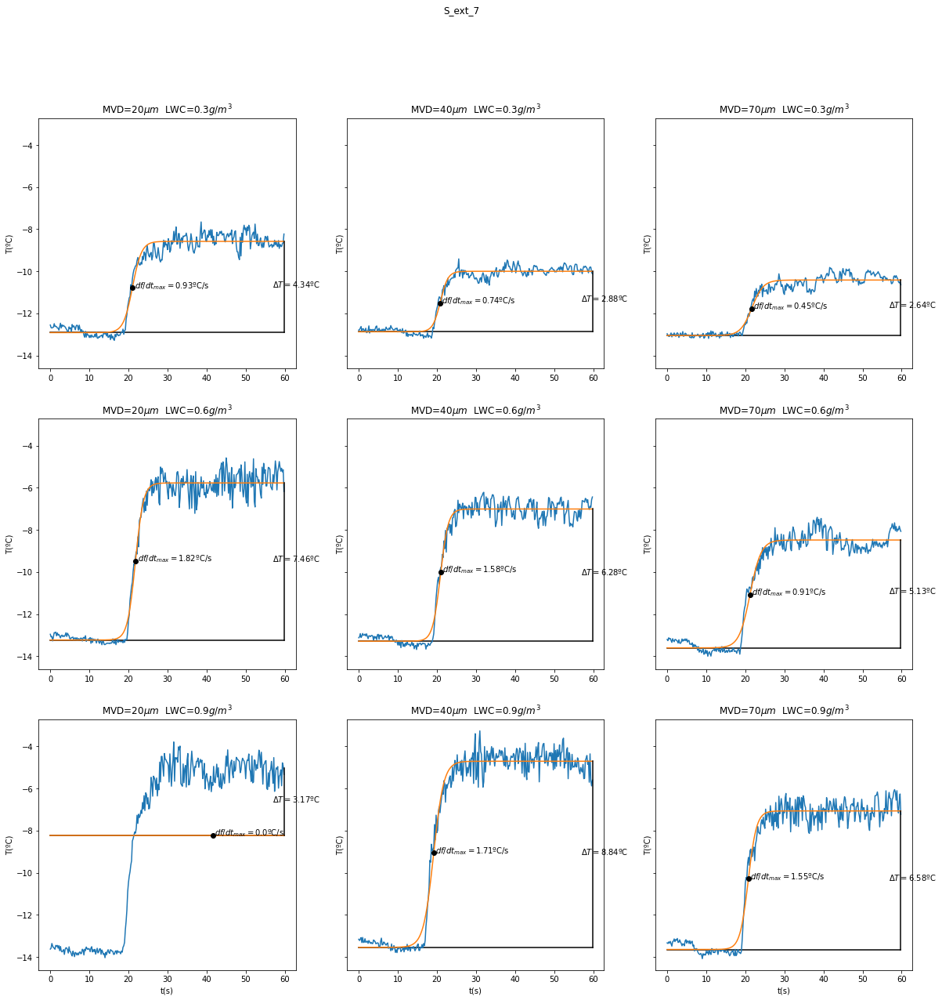

In [30]:
 
tabla=[]
fila=0
columna = 0
fig, ax = plt.subplots(3,3,figsize=(20,20),sharey=True)
fig.suptitle('S_ext_7')
for gota in [20,40,70]:
    
    for contenido in [0.3,0.6,0.9]:
        
        Testeo=dframe[(dframe.MVD==gota)&(dframe.LWC==contenido)&(dframe.Tiempo<60)]
        if len(Testeo)==0:continue
        tiempo=list(Testeo.Tiempo)
        tempe=list((Testeo.S_pta))
        
        disparo_a=float(np.mean(tempe[-20:]))
        popt, pcov = curve_fit(exponential, tiempo, tempe,p0=(tiempo[0],disparo_a,-90,6),maxfev = 100000) 
        senal_aprox_rapido=[]
        t01=popt[0]
        a1=popt[1]
        m1=popt[2]
        #            n1=popt[3]
        tao1=popt[3]
        f=[]
        for t in tiempo:f.append(exponential(t,t01,a1,m1,tao1))
        
        
        df=[]
        for t in tiempo:df.append(dexponential(a1,m1,tao1,6,t,t01))
        maxdf=max(df)
        for d in range(len(df)):
            if df[d]==maxdf:
                t_max=tiempo[d]
                max_f=f[d]
        
        
        ax[fila,columna].plot([tiempo[0],tiempo[-1]],[f[0],f[0]],'k')
        
        ax[fila,columna].plot(tiempo,tempe,tiempo,f)
        ax[fila,columna].plot(t_max,max_f,'ok')
        ax[fila,columna].plot([tiempo[-1],tiempo[-1]],[f[0],f[0]+a1*(1-m1/6)],'k')
        #plt.arrow(tiempo[-1],f[0],0,a1*(1-m1/6)-0.4,head_width=2, head_length=0.4)
        ax[fila,columna].text(tiempo[-1]-3,(f[0]+f[0]+a1*(1-m1/6))/2,r'$\Delta T =$' +str(round(a1*(1-m1/6),2))+'ºC')
        #ax[fila,columna].axis([40,90,min(tempe)-.3,max(tempe)+.3])
        ax[fila,columna].text(t_max+.5,max_f,'$df/dt_{max} =$' +str(round(maxdf,2))+'ºC/s')
        if fila==2:ax[fila,columna].set_xlabel('t(s)')
        ax[fila,columna].set_ylabel('T(ºC)')
        ax[fila,columna].set_title('MVD='+str(gota)+'$\mu m$  LWC='+ str(contenido)+'$g/m^{3}$')
        tabla.append([gota,contenido,round(f[0],2),round(a1*(1-m1/6),2),round(maxdf,2)] )
        fila+=1
    fila=0
    columna+=1
plt.savefig('ensayos_rime2.pdf')

A1


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in multiply
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in double_scalars
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: overflow encountered in double_scalars
  """
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_l

A2


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in multiply
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in double_scalars
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: overflow encountered in double_scalars
  """
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_l

A3


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in multiply
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.


A4
A5
A6
A7
A8


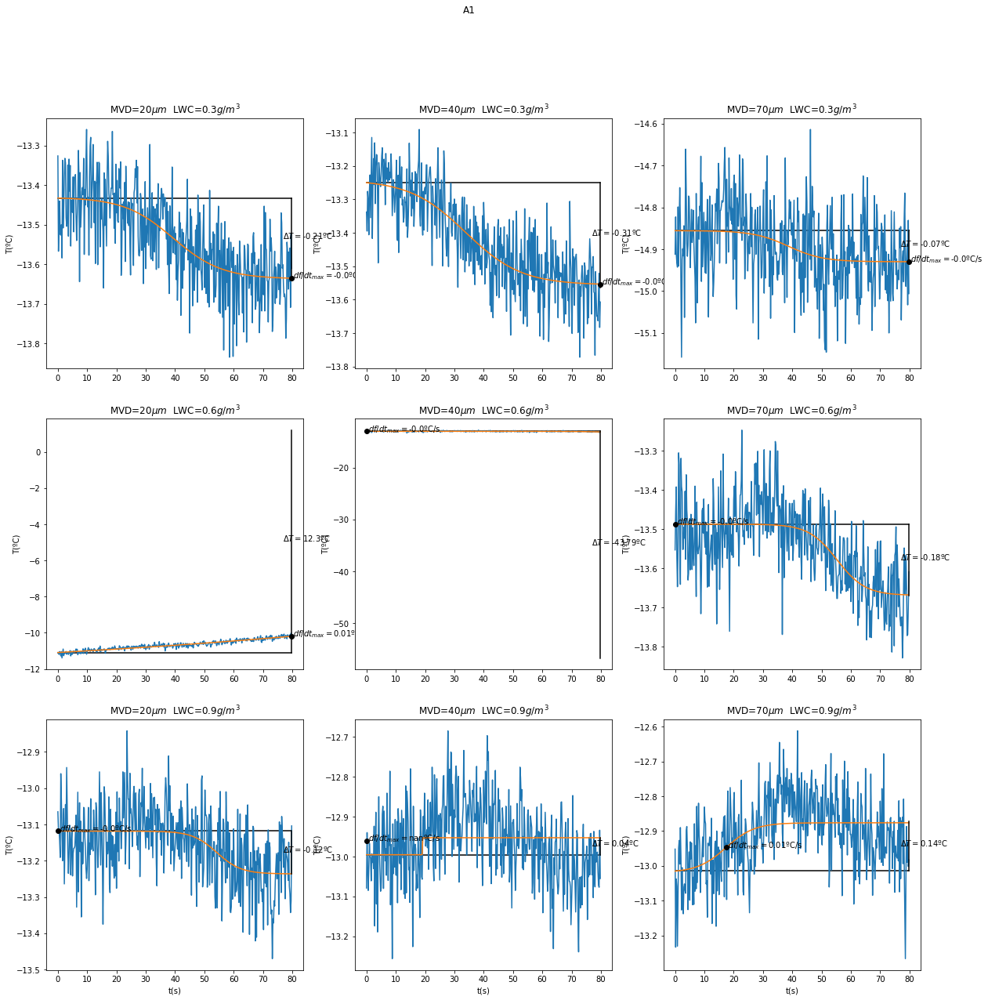

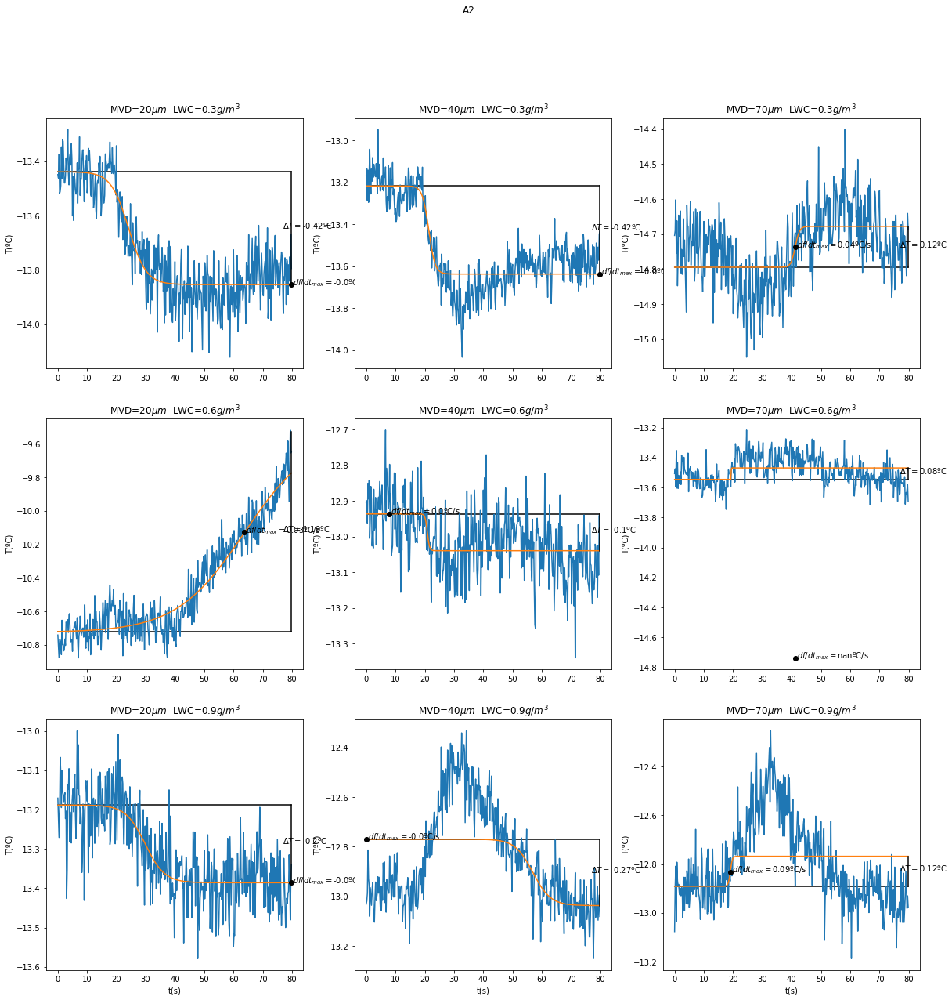

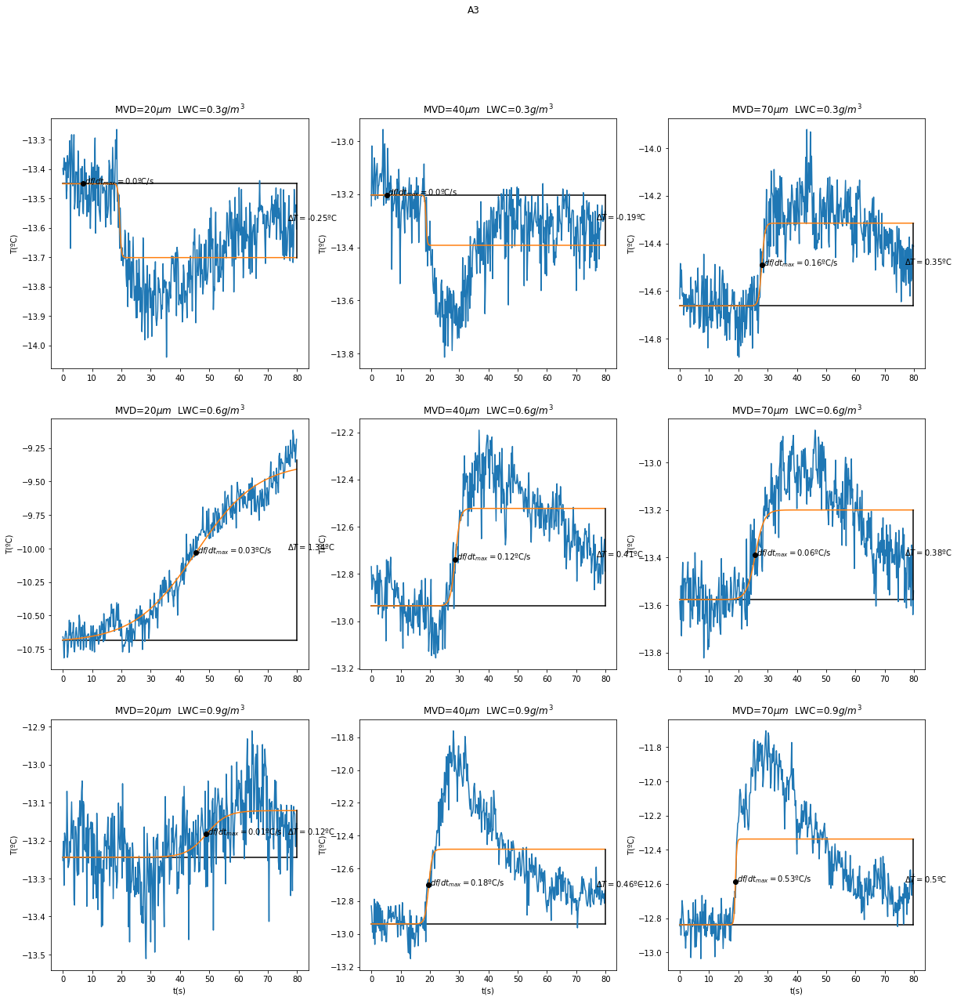

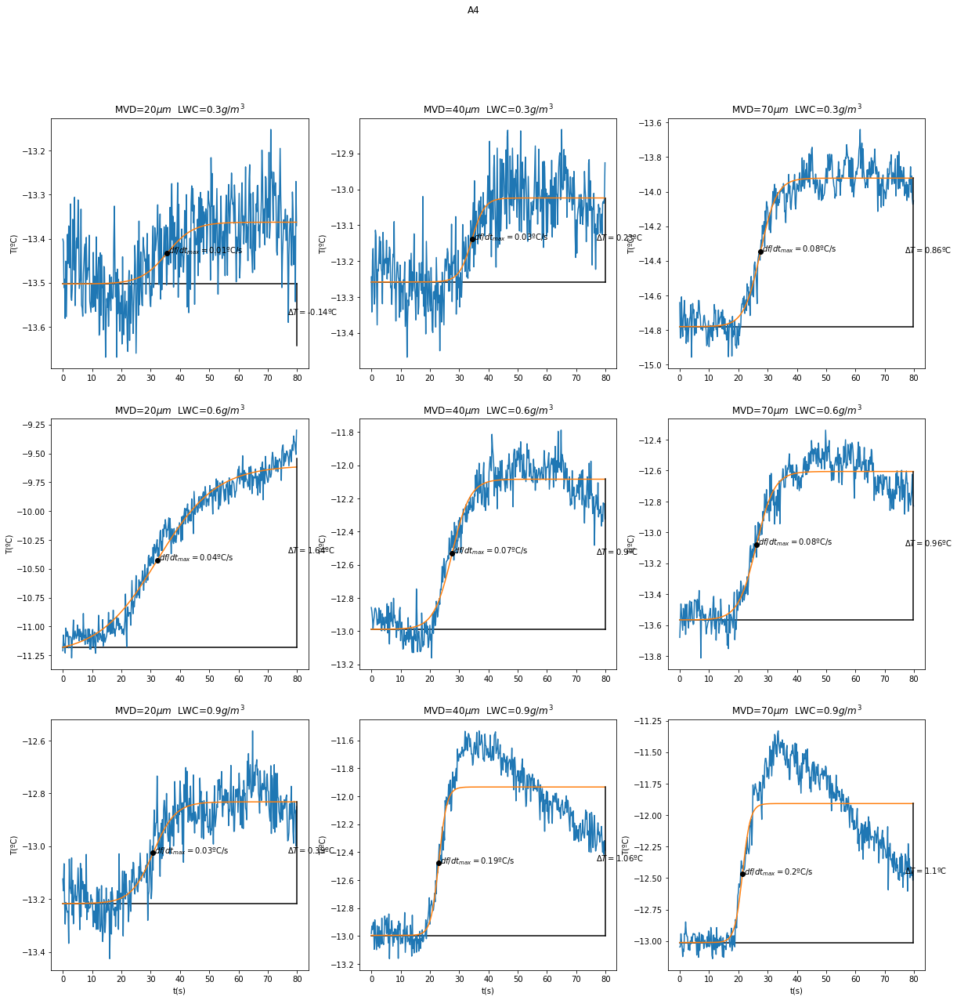

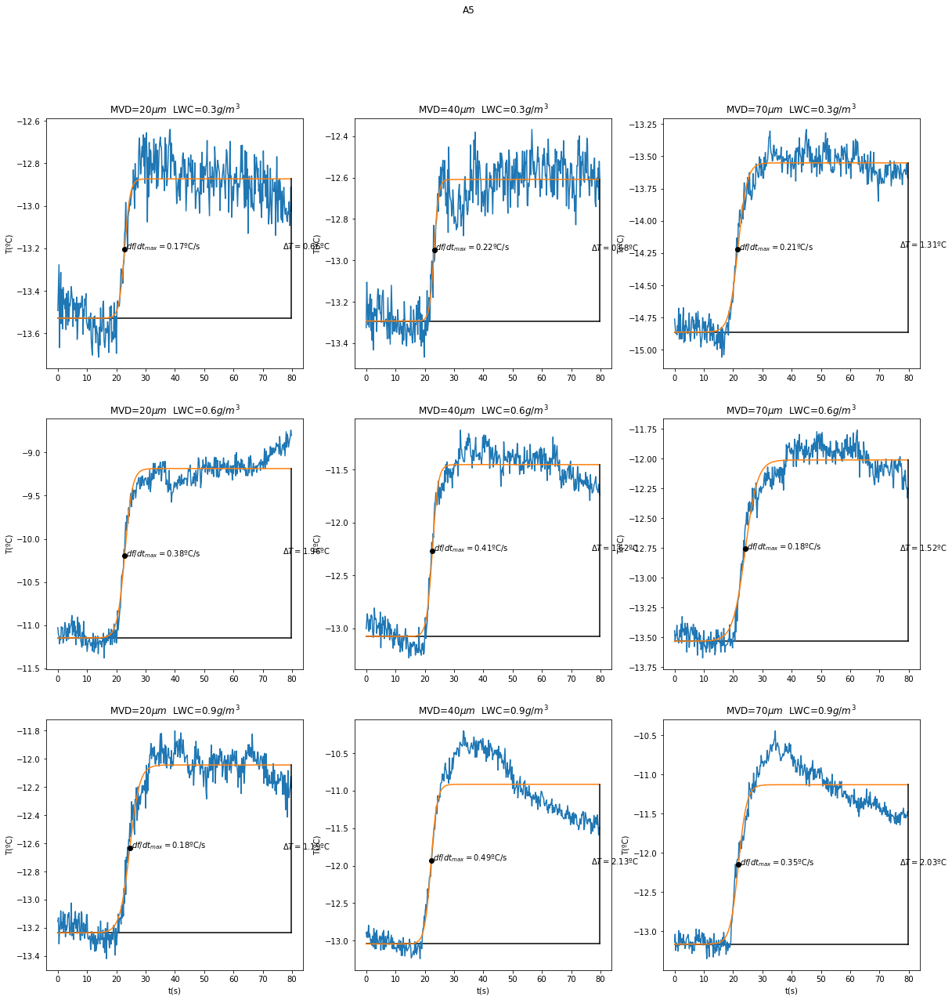

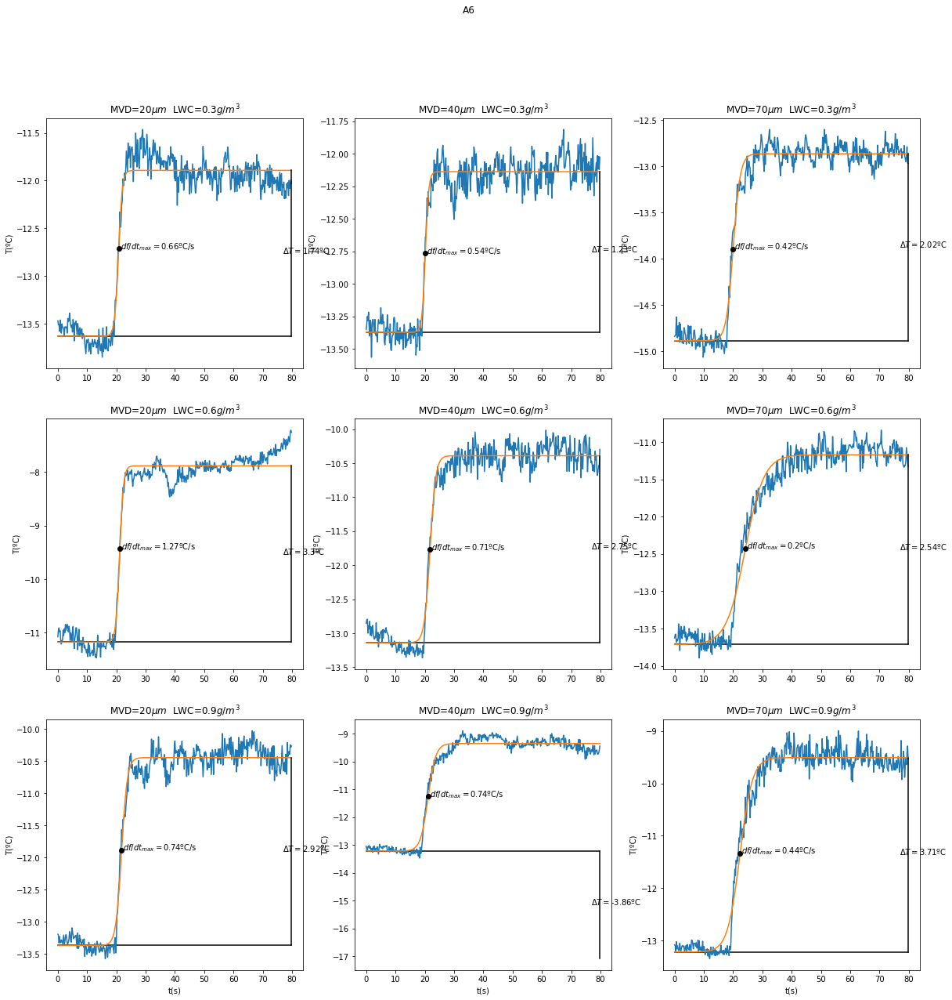

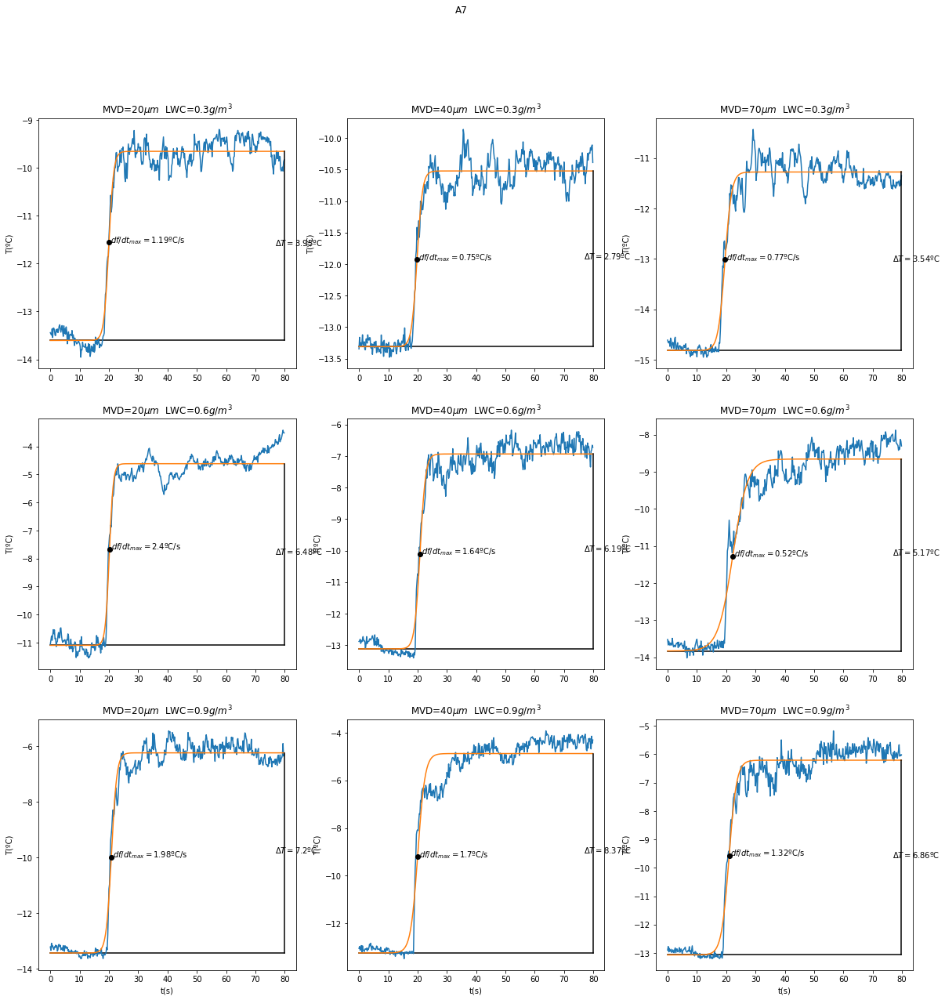

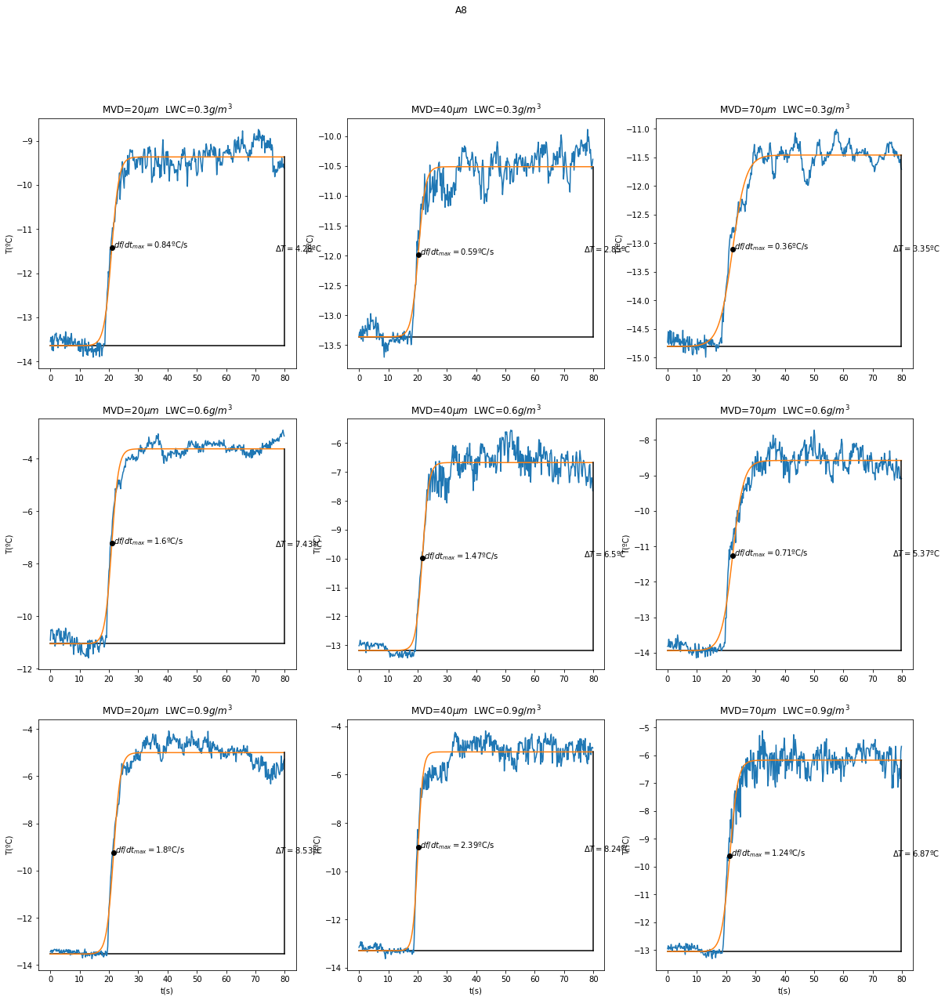

In [17]:
tabla=[]
for sensor in ['A1', 'A2', 'A3', 'A4', 'A5', 'A6', 'A7', 'A8']:
    print(sensor)
    S_pta=[]
    Time=[]
    MVD=[]
    LWC=[]
    for archivo in ensayos:
        df=ensayos[archivo]
        lwc,mvd= caracterizar_ensayo(archivo)
        for i in df.index:
            S_pta.append(df[sensor].loc[i])
            Time.append(i)
            MVD.append(mvd)
            LWC.append(lwc)
    dframe=pd.DataFrame()
    dframe['LWC']=LWC
    dframe['MVD']=MVD
    dframe['S_pta']= S_pta
    dframe['Tiempo']=Time

    fila=0
    columna = 0
    fig, ax = plt.subplots(3,3, sharey=False,figsize=(20,20))
    fig.suptitle(sensor)
    for gota in [20,40,70]:
        
        for contenido in [0.3,0.6,0.9]:
            
            Testeo=dframe[(dframe.MVD==gota)&(dframe.LWC==contenido)&(dframe.Tiempo<80)]
            if len(Testeo)==0:continue
            tiempo=list(Testeo.Tiempo)
            tempe=list((Testeo.S_pta))

            disparo_a=float(np.mean(tempe[-20:]))
            popt, pcov = curve_fit(exponential, tiempo, tempe,p0=(tiempo[0],disparo_a,-50,6),maxfev = 100000) 
            senal_aprox_rapido=[]
            t01=popt[0]
            a1=popt[1]
            m1=popt[2]
            #            n1=popt[3]
            tao1=popt[3]
            f=[]
            for t in tiempo:f.append(exponential(t,t01,a1,m1,tao1))


            df=[]
            for t in tiempo:df.append(dexponential(a1,m1,tao1,6,t,t01))
            maxdf=max(df)
            for d in range(len(df)):
                if df[d]==maxdf:
                    t_max=tiempo[d]
                    max_f=f[d]


            ax[fila,columna].plot([tiempo[0],tiempo[-1]],[f[0],f[0]],'k')

            ax[fila,columna].plot(tiempo,tempe,tiempo,f)
            ax[fila,columna].plot(t_max,max_f,'ok')
            ax[fila,columna].plot([tiempo[-1],tiempo[-1]],[f[0],f[0]+a1*(1-m1/6)],'k')
            #plt.arrow(tiempo[-1],f[0],0,a1*(1-m1/6)-0.4,head_width=2, head_length=0.4)
            ax[fila,columna].text(tiempo[-1]-3,(f[0]+f[0]+a1*(1-m1/6))/2,r'$\Delta T =$' +str(round(a1*(1-m1/6),2))+'ºC')
            #ax[fila,columna].axis([40,90,min(tempe)-.3,max(tempe)+.3])
            ax[fila,columna].text(t_max+.5,max_f,'$df/dt_{max} =$' +str(round(maxdf,2))+'ºC/s')
            if fila==2:ax[fila,columna].set_xlabel('t(s)')
            ax[fila,columna].set_ylabel('T(ºC)')
            ax[fila,columna].set_title('MVD='+str(gota)+'$\mu m$  LWC='+ str(contenido)+'$g/m^{3}$')
            tabla.append([sensor,gota,contenido,round(f[0],2),round(a1*(1-m1/6),2),round(maxdf,2)] )
            fila+=1
        fila=0
        columna+=1
    plt.savefig('Resultados_sensor_mayo//rime//'+sensor+'.pdf')


In [18]:
BD_glaze_2=pd.DataFrame(data=tabla,columns=['sensor','MVD','LWC','T_0','Delta_T','dT'])
BD_glaze_2.to_csv('Resultados_sensor_mayo//rime//basededatos_2.csv')

In [19]:
frames = [BD_glaze, BD_glaze_2]

result = pd.concat(frames)

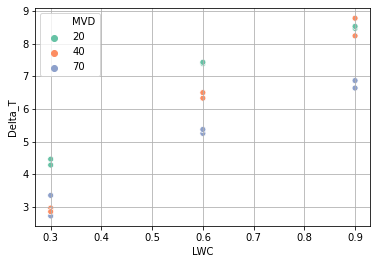

In [46]:
g =sns.scatterplot(x="LWC", y="Delta_T",
              hue="MVD",palette="Set2",
              data=result[(result.Delta_T>0)&(result.sensor=='A8')])  
plt.grid()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


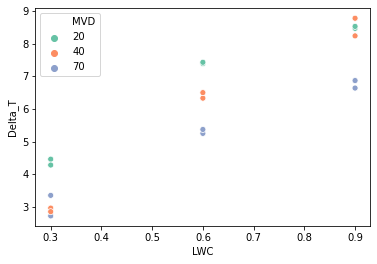

<Figure size 1080x720 with 0 Axes>

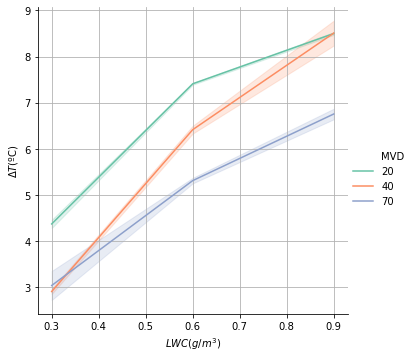

In [68]:
g =sns.scatterplot(x="LWC", y="Delta_T",
              hue="MVD",palette="Set2",
              data=result[(result.Delta_T>0)&(result.sensor=='A8')]) 
plt.figure(figsize=(15,10))
sns.relplot(x="LWC", y="Delta_T", hue="MVD", palette="Set2",
            dashes=True, markers=True, kind="line", data=result[(result.Delta_T>0)&(result.sensor=='A8')])
plt.ylabel(r'$\Delta T$(ºC)')
plt.xlabel(r'$LWC(g/m^3)$')
plt.grid()
plt.savefig('LWCvsDelta_T.eps')

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


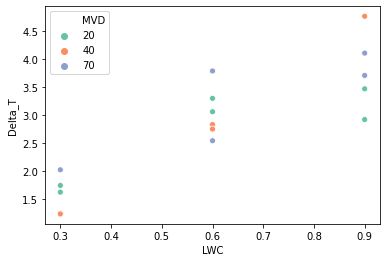

<Figure size 1080x720 with 0 Axes>

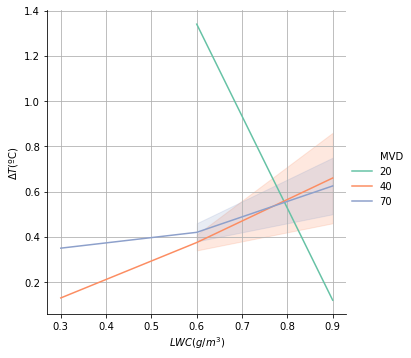

In [80]:
g =sns.scatterplot(x="LWC", y="Delta_T",
              hue="MVD",palette="Set2",
              data=result[(result.Delta_T>0)&(result.sensor=='A6')]) 
plt.figure(figsize=(15,10))
sns.relplot(x="LWC", y="Delta_T", hue="MVD", palette="Set2",
            dashes=True, markers=True, kind="line", data=result[(result.Delta_T>0)&(result.sensor=='A3')])
plt.ylabel(r'$\Delta T$(ºC)')
plt.xlabel(r'$LWC(g/m^3)$')
plt.grid()
plt.savefig('LWCvsDelta_T.eps')

In [20]:

sensores = {'A8':0,'A7':0.002,'A6':0.01,'A5':0.018,'A4':0.027,'A3':0.035,'A2':0.042,'A1':0.055}
posicion=[]
for sensor in result.sensor:posicion.append(sensores[sensor])
result['x(m)']=posicion

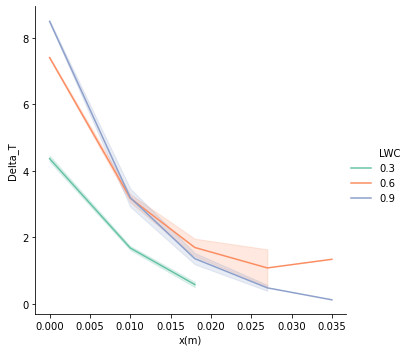

In [25]:
R40=result[(result.Delta_T>0)&(result.MVD==20)&result['sensor'].isin(['A8','A6','A5','A4','A3'])]
#R40=result[(result.MVD==20)&result['sensor'].isin(['A8','A6','A5','A4','A3'])]
sns.relplot(x='x(m)', y="Delta_T", hue="LWC", palette="Set2",
            dashes=True, markers=True, kind="line", data=R40)


In [87]:
import pickle
betha = pickle.load( open( "betha40.p", "rb" ) )
betha = np.delete(betha, 0, 0)

print(betha)
def coll_efficiency(x,betha):
    x_nodos = betha[:,0]
    bethas = betha[:,1]
    for i in range(1,len(x_nodos)):
        if (x<=x_nodos[i]) and (x>=x_nodos[i-1]):
            resultado = (x-x_nodos[i-1])/(x_nodos[i]-x_nodos[i-1])*(bethas[i]-bethas[i-1])+bethas[i-1]
            break
    return resultado

[[0.         0.89897078]
 [0.005      0.6115434 ]
 [0.01       0.46682616]
 [0.015      0.31865324]
 [0.02       0.23865569]
 [0.025      0.20747129]
 [0.03       0.17664861]
 [0.035      0.15166929]
 [0.04       0.13143695]
 [0.045      0.11861382]
 [0.05       0.10665929]]


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


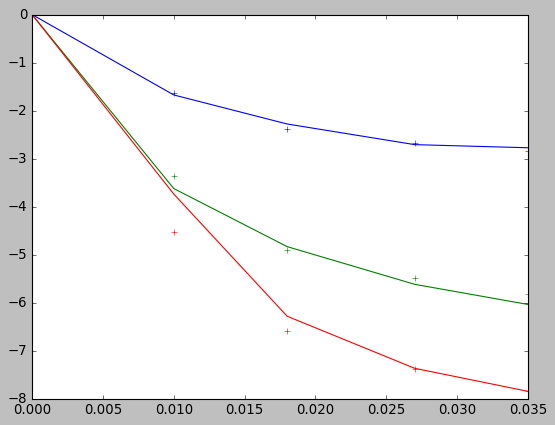

In [135]:
beta = [coll_efficiency(x,betha) for x in R40['x(m)']]
R40['beta']=beta
plt.style.use('classic')
sensores = list(set(R40.sensor))
sensores.sort()
colores = {'0.3':'b','0.6':'g','0.9':'r'}
pendientes={'0.3':3.8,'0.6':7.8,'0.9':10.5}
n=0
for LWC in [0.3,0.6,0.9]:
    It = R40[R40.LWC==LWC]
    pendiente = pendientes[str(LWC)]
    color = colores[str(LWC)]
    color_teorico =color+'+'
    It.index = It['sensor']
    Referencia =np.mean(np.array(It['Delta_T'].loc['A8']))
    Experimentales = np.array([[np.mean(np.array(It['x(m)'].loc[sensor])),np.mean(np.array(It['Delta_T'].loc[sensor]))] for sensor in sensores])
    Teoricos= np.array([[np.mean(np.array(It['x(m)'].loc[sensor])),np.mean(np.array(It['beta'].loc[sensor]))] for sensor in sensores])
    Referencia_beta =np.mean(np.array(It['beta'].loc['A8']))
    plt.plot(Experimentales[:,0],Experimentales[:,1]-Referencia,color)
    plt.plot(Teoricos[:,0],(Teoricos[:,1]-Referencia_beta)*pendiente,color_teorico)

# Ensayos Glaze P3.5

In [186]:
archivos = os.listdir('ensayosglazep3_5')

del archivos[-1]
del archivos[-2]
print(archivos[1:])

['ens P3-5 _4A.20200624133351.txt', 'ens P3-5 _4B.20200624130421.txt', 'ens P3-5 _4C.20200624120317.txt', 'ens P3-5 _5A.20200624132349.txt', 'ens P3-5 _5B.20200624125347.txt', 'ens P3-5 _5C.20200624115252.txt', 'ens P3-5 _6A.20200624131543.txt', 'ens P3-5 _6B.20200624123654.txt', 'ens P3-5 _6C.20200624113757.txt', 'ens P3-52_005.20200624112505.txt']


In [161]:
import seaborn as sns

ens P3-5 _4A
ens P3-5 _4B
ens P3-5 _4C
ens P3-5 _5A
ens P3-5 _5B
ens P3-5 _5C
ens P3-5 _6A
ens P3-5 _6B
ens P3-5 _6C
ens P3-52_005


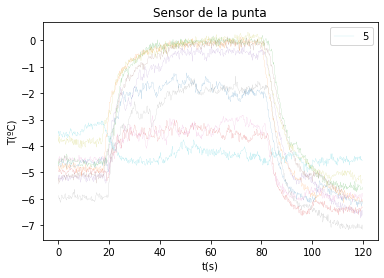

In [187]:
ensayos={}
for archivo in archivos[1:]:
    file=open('ensayosglazep3_5//'+archivo,'r')
    lineas=file.readlines()
    file.close()
    inicial=int(lineas[0])
    
    texto=''
    
    for linea in range(inicial-1,len(lineas)):
        texto=texto+lineas[linea]+'\n'
    file=open('temporal.txt','w')
    file.write(texto)
    file.close()
    df=pd.read_csv('temporal.txt',sep='\t', decimal=',')
  
    initial_time_hours=float(df[df.columns[0]].loc[0][-14:-12])
    initial_time_minutes=float(df[df.columns[0]].loc[0][-11:-9])
    initial_time_seconds = float(df[df.columns[0]].loc[0][-8:])
    initial_time=3600*initial_time_hours+60*initial_time_minutes+initial_time_seconds
    Time=[]
    for t in df[df.columns[0]]:
        initial_time_hours=float(t[-14:-12])
        initial_time_minutes=float(t[-11:-9])
        initial_time_seconds = float(t[-8:])
        Time.append(3600*initial_time_hours+60*initial_time_minutes+initial_time_seconds-initial_time)
    df.index=Time
    df['Tiempo']=Time
    df = df[df.Tiempo<120]
    ensayos.update({archivo[:-19]:df})
    print(archivo[:-19])
    df['A8'].plot(label=archivo[12:-19],linewidth=0.1)
plt.legend()
plt.title('Sensor de la punta')
plt.xlabel('t(s)')
plt.ylabel('T(ºC)')
plt.savefig('ensayos_glaze_35.pdf')

Se define la función de regresión como:

$$f(t)=a \frac{1 + m \exp(-(t-t_0)/\tau)}{ 1 + n \exp(-(t-t_0)/\tau)}$$

In [9]:
def exponential(t,t0,a,m,tao):
    import numpy as np
    n=6
    return a*(1+m*np.exp(-(t-t0)/tao))/(1+n*np.exp(-(t-t0)/tao))


La derivada temporal de la función: $$\frac{df}{dt}$$

In [10]:
def dexponential(a,m,tao,n,tiempo,t0):
    t=tiempo-t0
    import numpy as np
    A=a/(1+n*np.exp(-t/tao))**2;
    B=(1+n*np.exp(-t/tao))*(-m/tao*np.exp(-t/tao))
    C=-(1+m*np.exp(-t/tao))*(-n/tao*np.exp(-t/tao))
    df=A*(B+C)
    return df

In [168]:
def caracterizar_ensayo(archivo):
    if archivo[-2]=='4':
        MVD=20
    if archivo[-2]=='5':
        MVD=40
    if archivo[-2]=='6':
        MVD=70
    if archivo[-1]=='A':
        LWC=.3
    if archivo[-1]=='B':
        LWC=.6
    if archivo[-1]=='C':
        LWC=.9
    if archivo[-1]=='5':
        MVD = 20
        LWC =0.05
    return (LWC,MVD)

['ens P3-5 _6B.20200624123654.txt', 'ens P3-5 _6C.20200624113757.txt', 'ens P3-52_005.20200624112505.txt']


<Figure size 432x288 with 0 Axes>

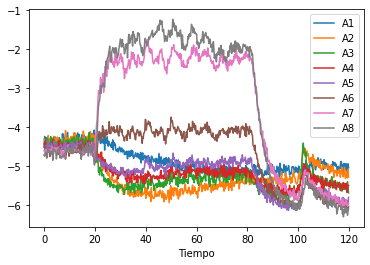

<Figure size 432x288 with 0 Axes>

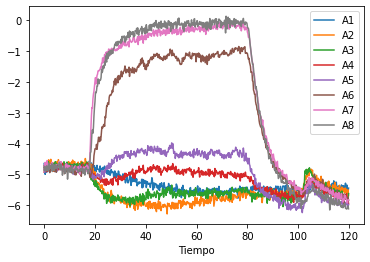

<Figure size 432x288 with 0 Axes>

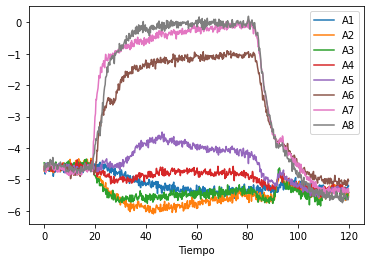

<Figure size 432x288 with 0 Axes>

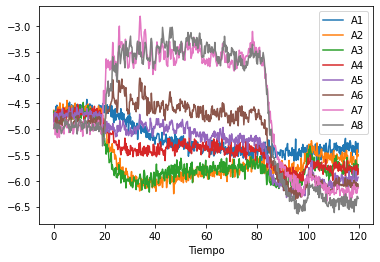

<Figure size 432x288 with 0 Axes>

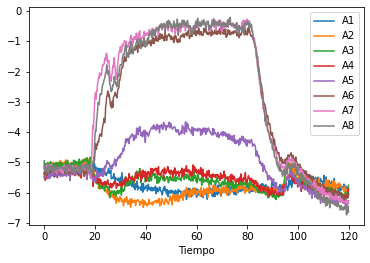

<Figure size 432x288 with 0 Axes>

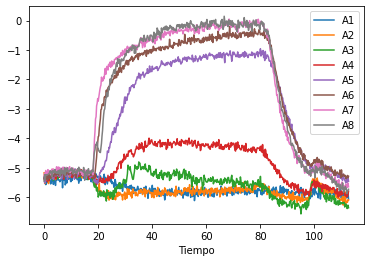

<Figure size 432x288 with 0 Axes>

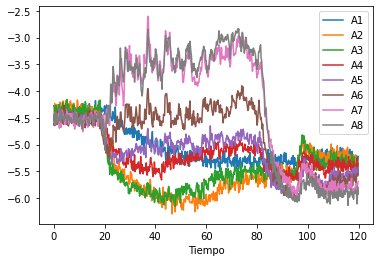

<Figure size 432x288 with 0 Axes>

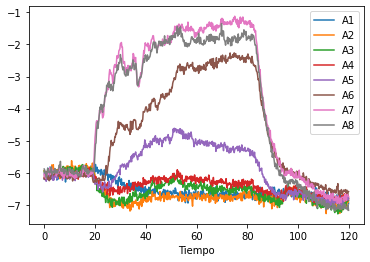

<Figure size 432x288 with 0 Axes>

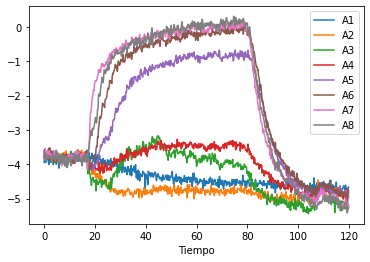

<Figure size 432x288 with 0 Axes>

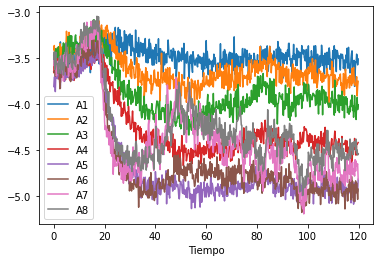

In [188]:
print(archivos[-3:])
sensores = ['A1', 'A2', 'A3', 'A4', 'A5', 'A6', 'A7', 'A8','Tiempo']
for archivo in ensayos:
    df = ensayos[archivo]
    plt.figure()
    df[sensores].plot(x='Tiempo')

In [28]:
S_pta=[]
Time=[]
MVD=[]
LWC=[]
#del ensayos['P2,3 en IWT-70ms-sin spray']
for archivo in ensayos:
    print(archivo)
    df=ensayos[archivo]
    lwc,mvd= caracterizar_ensayo(archivo)
    print(lwc)
    for i in df.index:
        S_pta.append(df['A8'].loc[i])
        Time.append(i)
        MVD.append(mvd)
        LWC.append(lwc)

ens P3-5 _-13-4A
0.3
ens P3-5 _-13-4B
0.6
ens P3-5 _-13-4C
0.9
ens P3-5 _-13-5A
0.3
ens P3-5 _-13-5B
0.6
ens P3-5 _-13-5C
0.9
ens P3-5 _-13-6A
0.3
ens P3-5 _-13-6B
0.6
ens P3-5 _-13-6C
0.9


In [29]:
dframe=pd.DataFrame()
dframe['LWC']=LWC
dframe['MVD']=MVD
dframe['S_pta']= S_pta
dframe['Tiempo']=Time

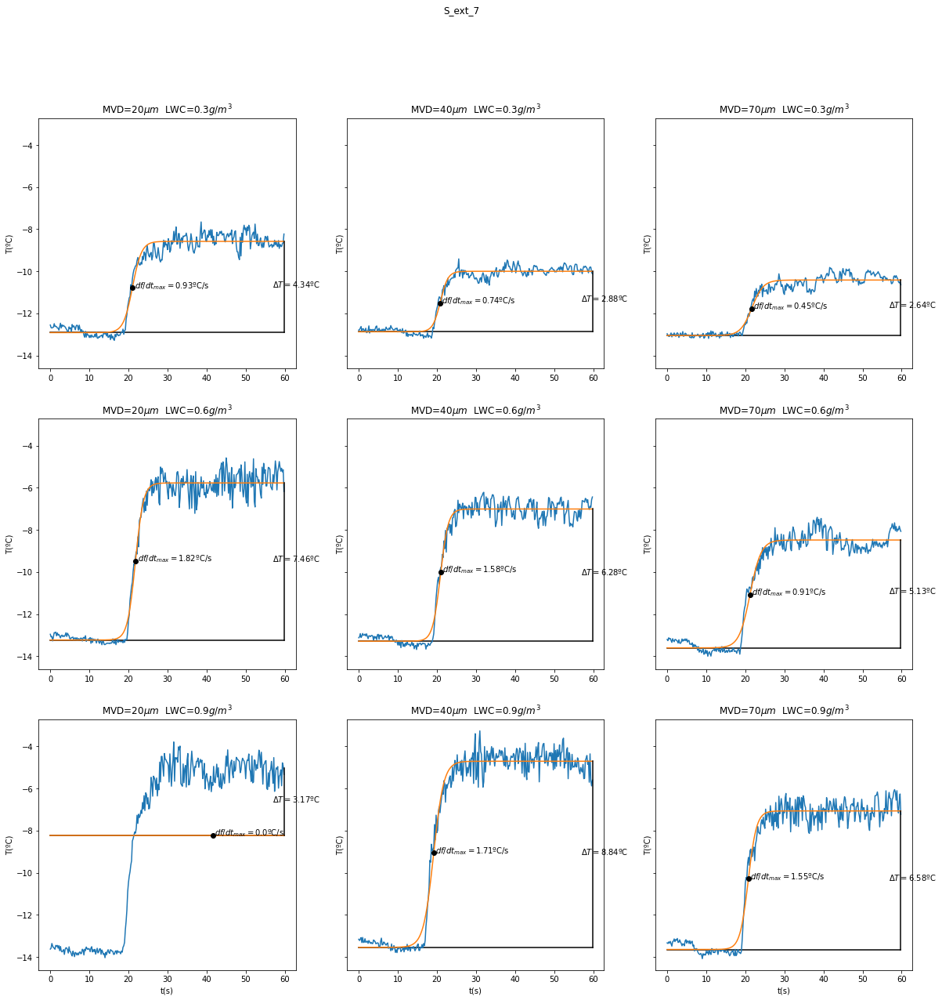

In [30]:
 
tabla=[]
fila=0
columna = 0
fig, ax = plt.subplots(3,3,figsize=(20,20),sharey=True)
fig.suptitle('S_ext_7')
for gota in [20,40,70]:
    
    for contenido in [0.3,0.6,0.9]:
        
        Testeo=dframe[(dframe.MVD==gota)&(dframe.LWC==contenido)&(dframe.Tiempo<60)]
        if len(Testeo)==0:continue
        tiempo=list(Testeo.Tiempo)
        tempe=list((Testeo.S_pta))
        
        disparo_a=float(np.mean(tempe[-20:]))
        popt, pcov = curve_fit(exponential, tiempo, tempe,p0=(tiempo[0],disparo_a,-90,6),maxfev = 100000) 
        senal_aprox_rapido=[]
        t01=popt[0]
        a1=popt[1]
        m1=popt[2]
        #            n1=popt[3]
        tao1=popt[3]
        f=[]
        for t in tiempo:f.append(exponential(t,t01,a1,m1,tao1))
        
        
        df=[]
        for t in tiempo:df.append(dexponential(a1,m1,tao1,6,t,t01))
        maxdf=max(df)
        for d in range(len(df)):
            if df[d]==maxdf:
                t_max=tiempo[d]
                max_f=f[d]
        
        
        ax[fila,columna].plot([tiempo[0],tiempo[-1]],[f[0],f[0]],'k')
        
        ax[fila,columna].plot(tiempo,tempe,tiempo,f)
        ax[fila,columna].plot(t_max,max_f,'ok')
        ax[fila,columna].plot([tiempo[-1],tiempo[-1]],[f[0],f[0]+a1*(1-m1/6)],'k')
        #plt.arrow(tiempo[-1],f[0],0,a1*(1-m1/6)-0.4,head_width=2, head_length=0.4)
        ax[fila,columna].text(tiempo[-1]-3,(f[0]+f[0]+a1*(1-m1/6))/2,r'$\Delta T =$' +str(round(a1*(1-m1/6),2))+'ºC')
        #ax[fila,columna].axis([40,90,min(tempe)-.3,max(tempe)+.3])
        ax[fila,columna].text(t_max+.5,max_f,'$df/dt_{max} =$' +str(round(maxdf,2))+'ºC/s')
        if fila==2:ax[fila,columna].set_xlabel('t(s)')
        ax[fila,columna].set_ylabel('T(ºC)')
        ax[fila,columna].set_title('MVD='+str(gota)+'$\mu m$  LWC='+ str(contenido)+'$g/m^{3}$')
        tabla.append([gota,contenido,round(f[0],2),round(a1*(1-m1/6),2),round(maxdf,2)] )
        fila+=1
    fila=0
    columna+=1
plt.savefig('ensayos_rime2.pdf')

A1
A2
A3


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in multiply
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.


A4


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in multiply
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in double_scalars
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: overflow encountered in double_scalars
  """
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_l

A5


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\scipy\optimize\minpack.py:808: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in multiply
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.


A6


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in multiply
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in double_scalars
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: overflow encountered in double_scalars
  """
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_l

A7


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in multiply
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\scipy\optimize\minpack.py:808: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


A8


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in multiply
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: invalid value encountered in true_divide
  after removing the cwd from sys.path.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: overflow encountered in double_scalars
  """
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:6: RuntimeWarning: overflow encountered in double_scalars
  
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:7: RuntimeWarning: invalid

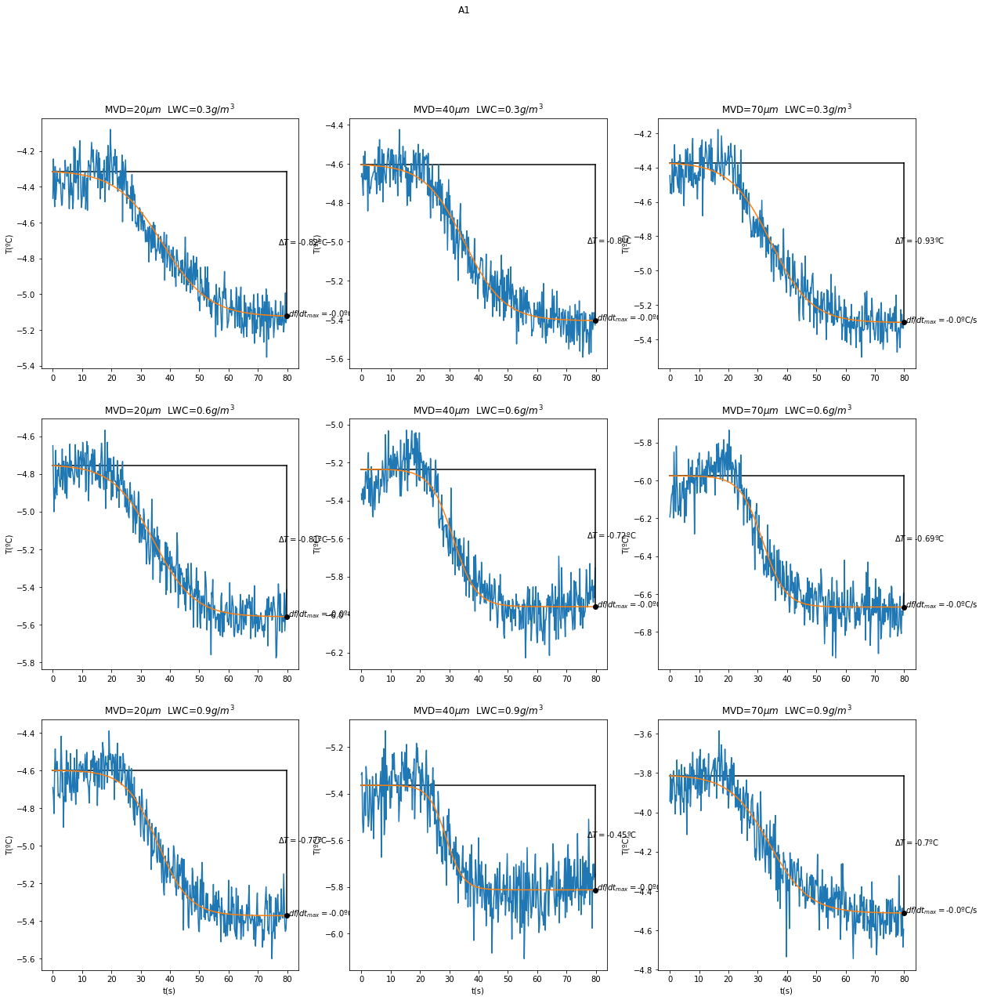

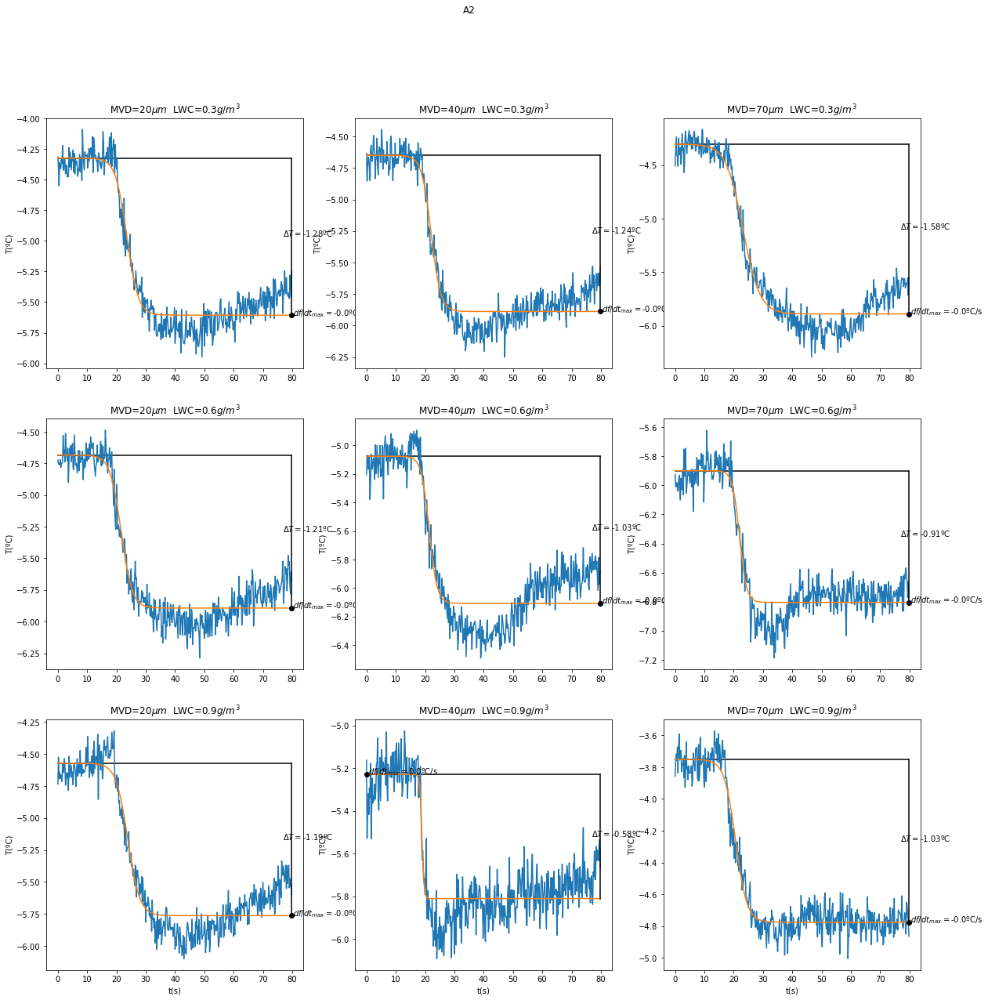

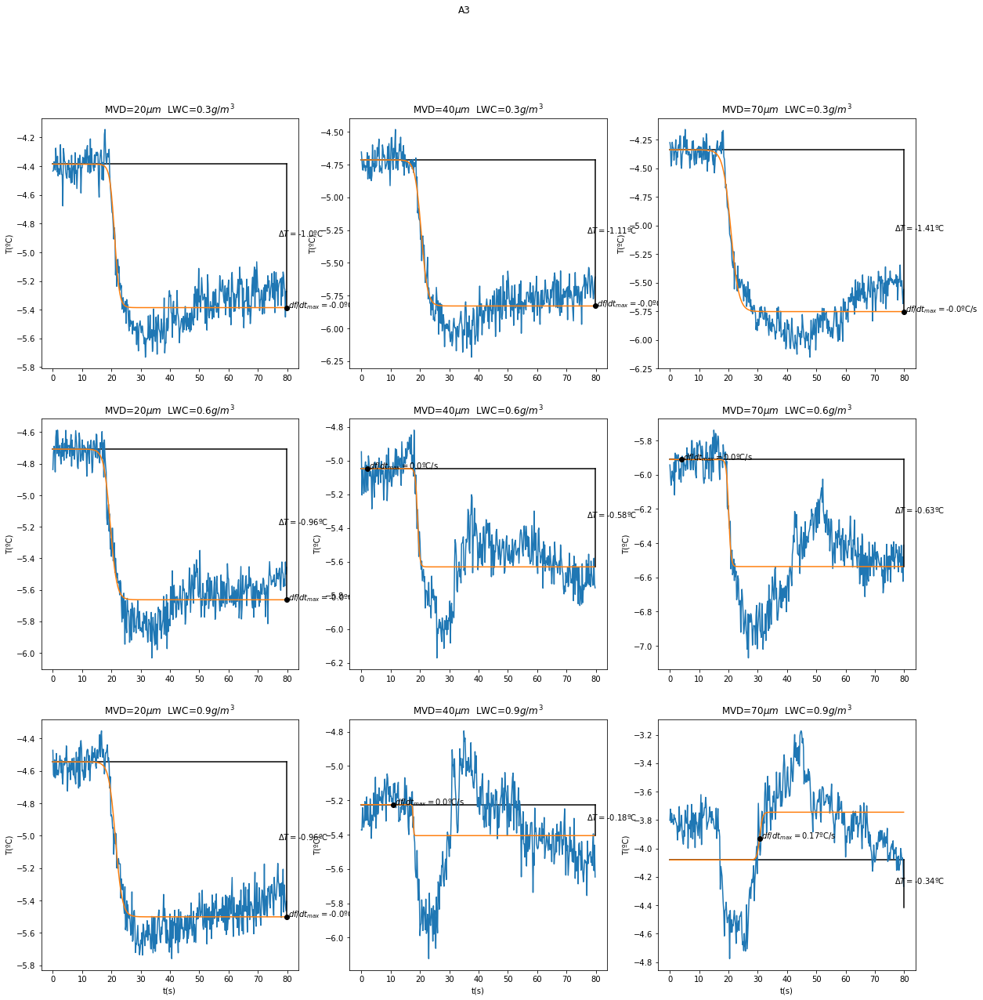

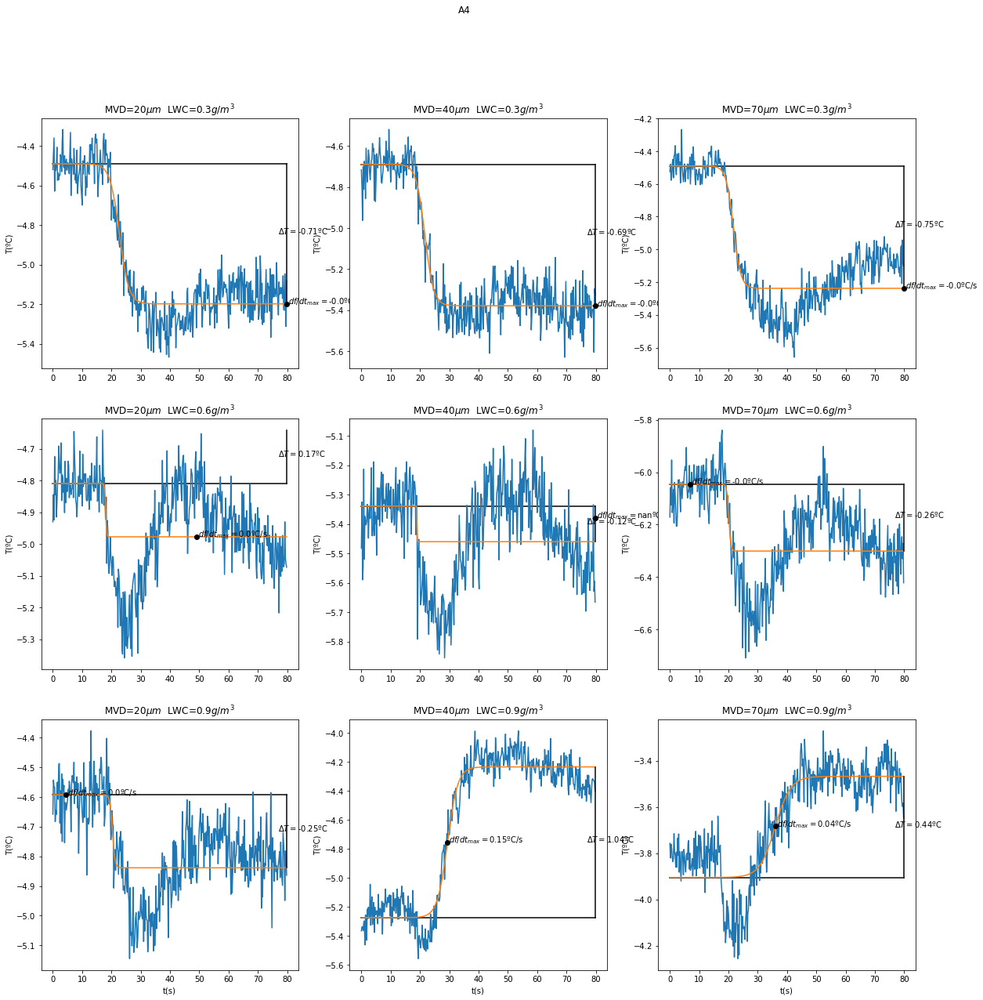

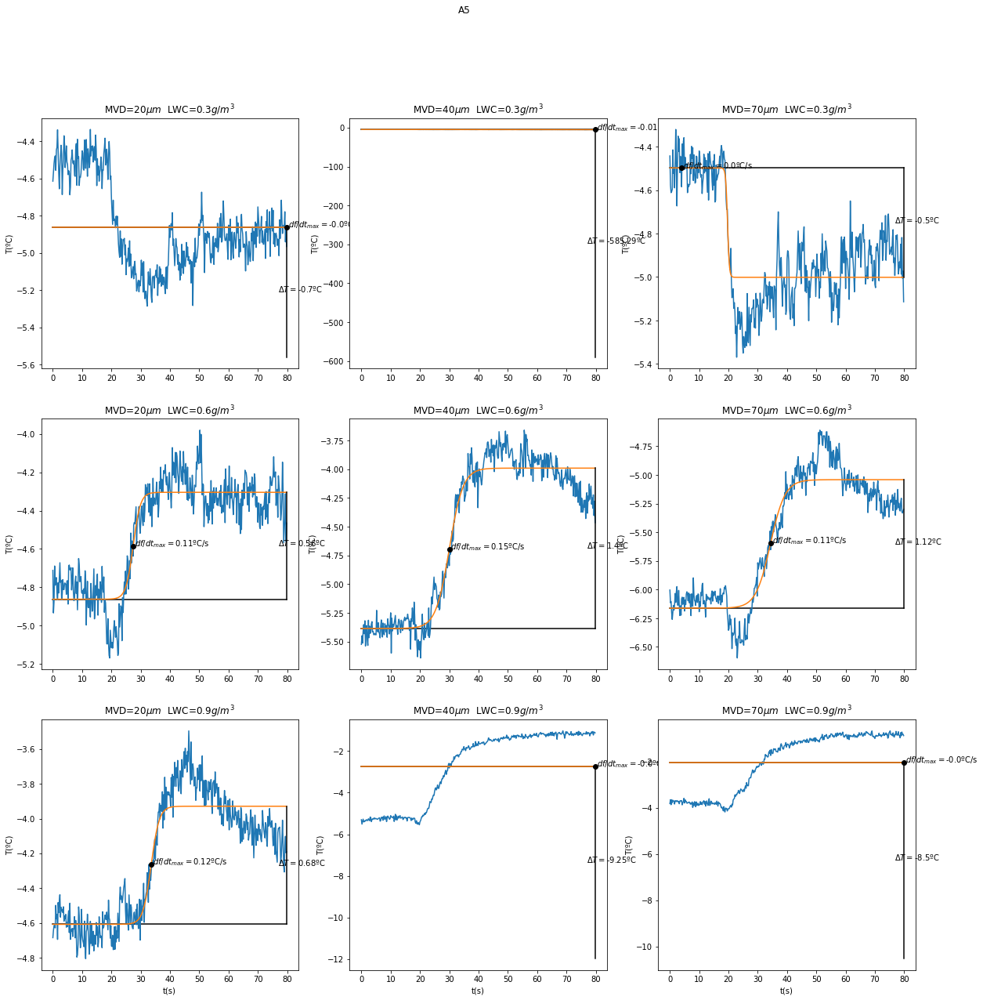

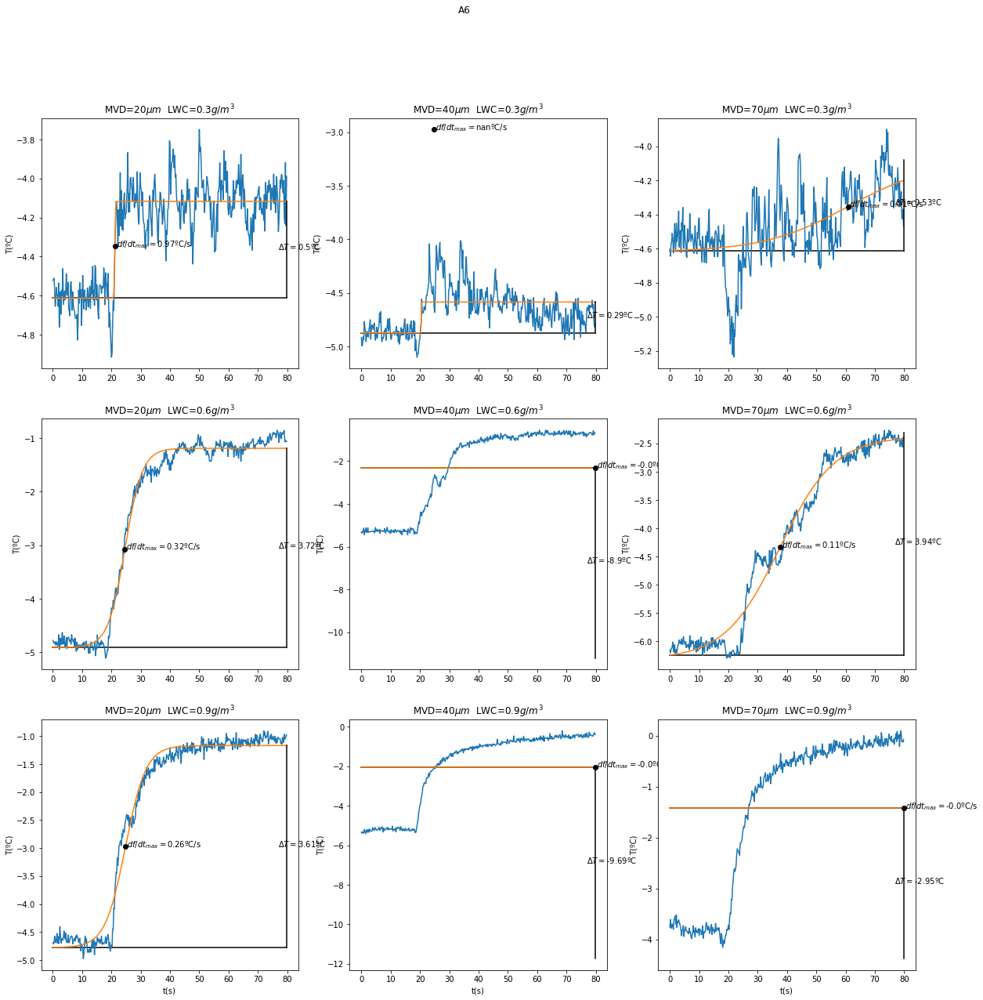

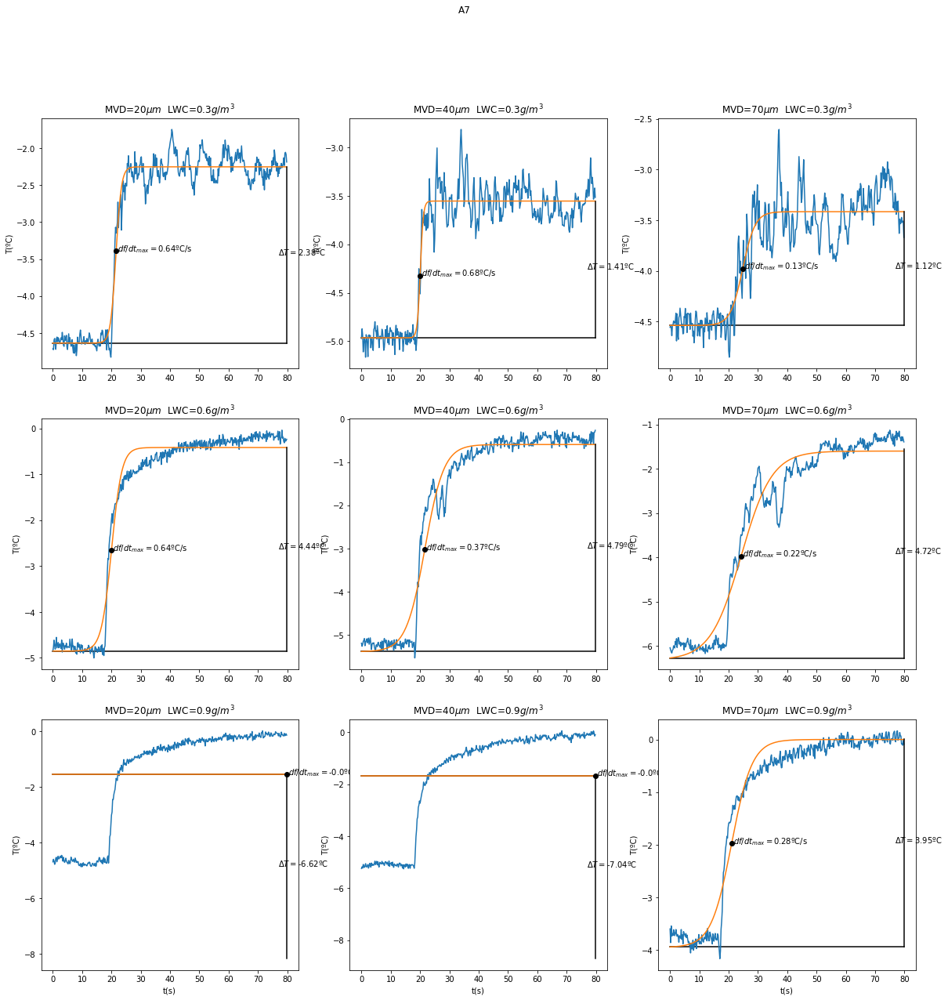

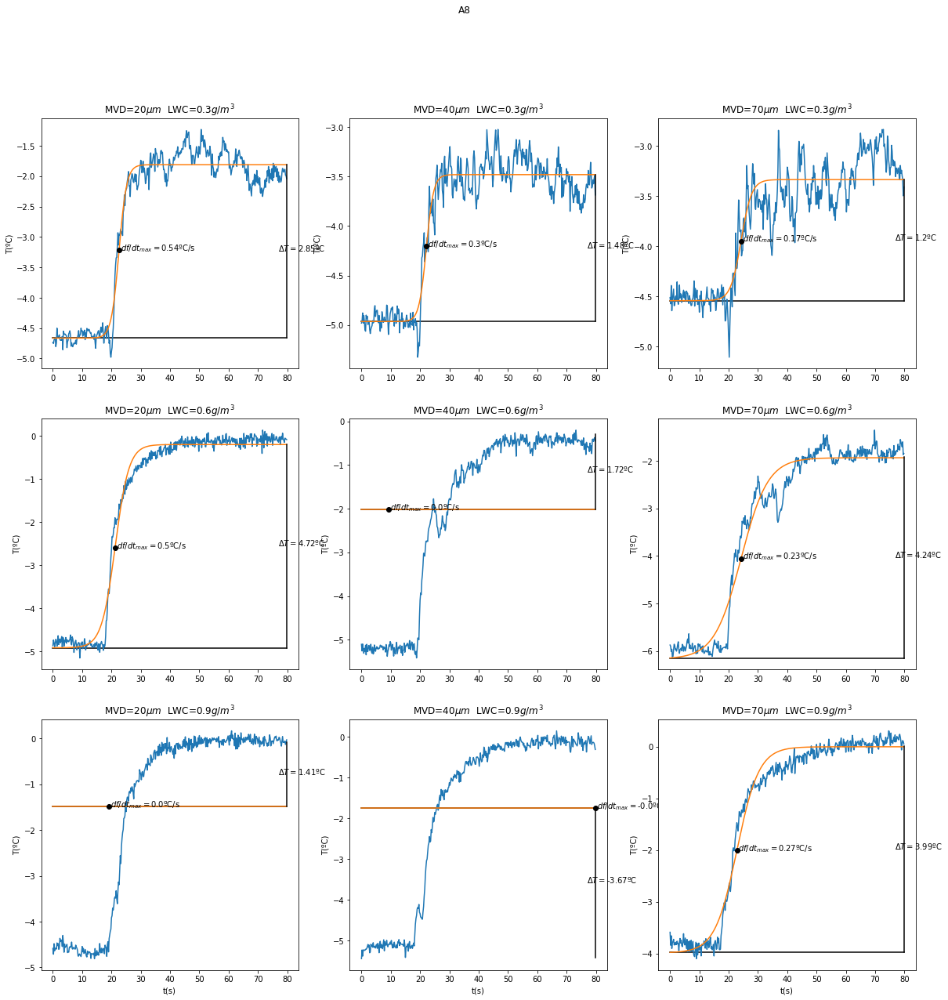

In [169]:
tabla=[]
for sensor in ['A1', 'A2', 'A3', 'A4', 'A5', 'A6', 'A7', 'A8']:
    print(sensor)
    S_pta=[]
    Time=[]
    MVD=[]
    LWC=[]
    for archivo in ensayos:
        df=ensayos[archivo]
        lwc,mvd= caracterizar_ensayo(archivo)
        for i in df.index:
            S_pta.append(df[sensor].loc[i])
            Time.append(i)
            MVD.append(mvd)
            LWC.append(lwc)
    dframe=pd.DataFrame()
    dframe['LWC']=LWC
    dframe['MVD']=MVD
    dframe['S_pta']= S_pta
    dframe['Tiempo']=Time

    fila=0
    columna = 0
    fig, ax = plt.subplots(3,3, sharey=False,figsize=(20,20))
    fig.suptitle(sensor)
    for gota in [20,40,70]:
        
        for contenido in [0.3,0.6,0.9]:
            
            Testeo=dframe[(dframe.MVD==gota)&(dframe.LWC==contenido)&(dframe.Tiempo<80)]
            if len(Testeo)==0:continue
            tiempo=list(Testeo.Tiempo)
            tempe=list((Testeo.S_pta))

            disparo_a=float(np.mean(tempe[-20:]))
            popt, pcov = curve_fit(exponential, tiempo, tempe,p0=(tiempo[0],disparo_a,-50,6),maxfev = 100000) 
            senal_aprox_rapido=[]
            t01=popt[0]
            a1=popt[1]
            m1=popt[2]
            #            n1=popt[3]
            tao1=popt[3]
            f=[]
            for t in tiempo:f.append(exponential(t,t01,a1,m1,tao1))


            df=[]
            for t in tiempo:df.append(dexponential(a1,m1,tao1,6,t,t01))
            maxdf=max(df)
            for d in range(len(df)):
                if df[d]==maxdf:
                    t_max=tiempo[d]
                    max_f=f[d]


            ax[fila,columna].plot([tiempo[0],tiempo[-1]],[f[0],f[0]],'k')

            ax[fila,columna].plot(tiempo,tempe,tiempo,f)
            ax[fila,columna].plot(t_max,max_f,'ok')
            ax[fila,columna].plot([tiempo[-1],tiempo[-1]],[f[0],f[0]+a1*(1-m1/6)],'k')
            #plt.arrow(tiempo[-1],f[0],0,a1*(1-m1/6)-0.4,head_width=2, head_length=0.4)
            ax[fila,columna].text(tiempo[-1]-3,(f[0]+f[0]+a1*(1-m1/6))/2,r'$\Delta T =$' +str(round(a1*(1-m1/6),2))+'ºC')
            #ax[fila,columna].axis([40,90,min(tempe)-.3,max(tempe)+.3])
            ax[fila,columna].text(t_max+.5,max_f,'$df/dt_{max} =$' +str(round(maxdf,2))+'ºC/s')
            if fila==2:ax[fila,columna].set_xlabel('t(s)')
            ax[fila,columna].set_ylabel('T(ºC)')
            ax[fila,columna].set_title('MVD='+str(gota)+'$\mu m$  LWC='+ str(contenido)+'$g/m^{3}$')
            tabla.append([sensor,gota,contenido,round(f[0],2),round(a1*(1-m1/6),2),round(maxdf,2)] )
            fila+=1
        fila=0
        columna+=1
    plt.savefig('Resultados_sensor_mayo//glaze//'+sensor+'.pdf')


In [12]:
BD_glaze=pd.DataFrame(data=tabla,columns=['sensor','MVD','LWC','T_0','Delta_T','dT'])
BD_glaze.to_csv('Resultados_sensor_mayo//glaze//basededatos.csv')

In [24]:
from pptx import Presentation
from pptx.util import Inches

def nueva_diapo(nombre_imagen):  
    global prs
    title_slide_layout = prs.slide_layouts[0]
    img_path = nombre_imagen
    blank_slide_layout = prs.slide_layouts[6]
    slide = prs.slides.add_slide(blank_slide_layout)
    title = slide.shapes.title
    title.text = titulo
    left = top = Inches(1)
    pic = slide.shapes.add_picture(img_path, left, top)
    left = Inches(5)
    height = Inches(5.5)
    pic = slide.shapes.add_picture(img_path, left, top, height=height)



A1
A2
A3


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20

A4


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20

A5


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20

A6


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20

A7


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20

A8


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\pandas\plotting\_matplotlib\core.py:320: RuntimeWarning: More than 20

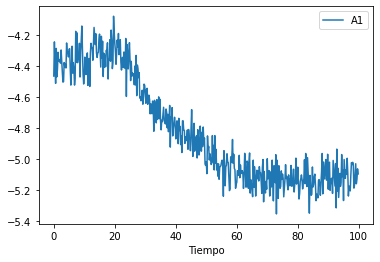

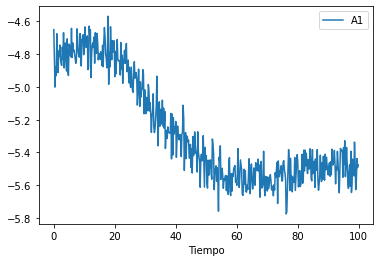

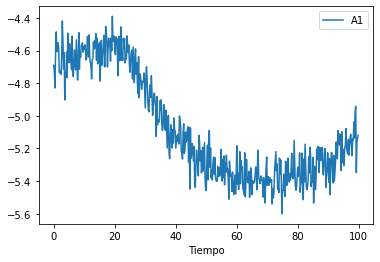

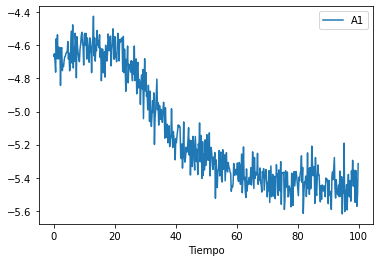

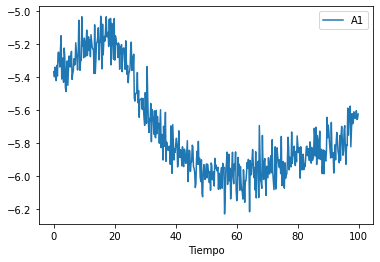

...

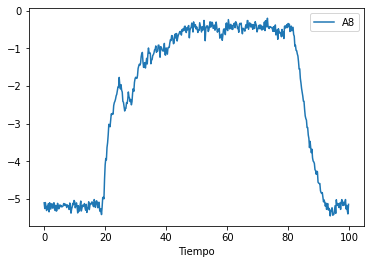

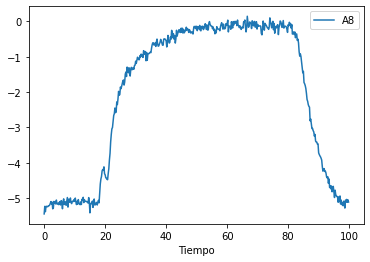

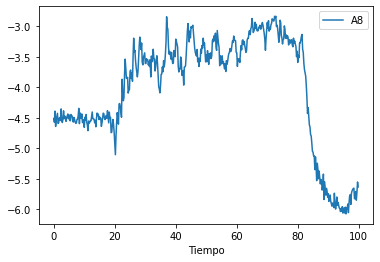

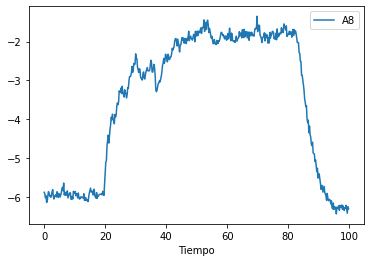

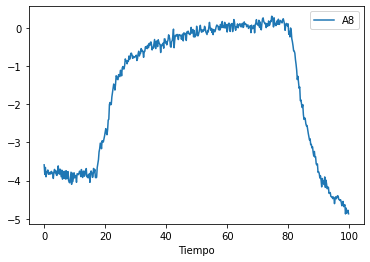

In [36]:
prs = Presentation()
tabla=[]
for sensor in ['A1', 'A2', 'A3', 'A4', 'A5', 'A6', 'A7', 'A8']:
    print(sensor)
    S_pta=[]
    Time=[]
    MVD=[]
    LWC=[]
    for archivo in ensayos:
        df=ensayos[archivo]
        lwc,mvd= caracterizar_ensayo(archivo)
        for i in df.index:
            S_pta.append(df[sensor].loc[i])
            Time.append(i)
            MVD.append(mvd)
            LWC.append(lwc)
    dframe=pd.DataFrame()
    dframe['LWC']=LWC
    dframe['MVD']=MVD
    dframe[sensor]= S_pta
    dframe['Tiempo']=Time
    for gota in [20,40,70]:
        
        for contenido in [0.3,0.6,0.9]:
            
            Testeo=dframe[(dframe.MVD==gota)&(dframe.LWC==contenido)&(dframe.Tiempo<100)]
            if len(Testeo)==0:continue
            Testeo.plot(x='Tiempo',y=sensor)
            
            titulo = 'LWC='+str(contenido)+'g/m3 MVD='+str(gota)+'\n'+sensor
            nombre_imagen ='Resultados_sensor_mayo//glaze//'+sensor+str(gota)+str(contenido)+'.png'
            plt.savefig(nombre_imagen)
            img_path = nombre_imagen
            blank_slide_layout = prs.slide_layouts[6]
            slide = prs.slides.add_slide(blank_slide_layout)
            left = top = width = height = Inches(1)
            txBox = slide.shapes.add_textbox(left, Inches(0), width, height)
            tf = txBox.text_frame
            p = tf.add_paragraph()
            p.text =titulo
            p.font.bold = True
            left = top = Inches(1)
        
            left = Inches(2)
            height = Inches(5.5)
            pic = slide.shapes.add_picture(img_path, left, top, height=height)
prs.save('test.pptx')

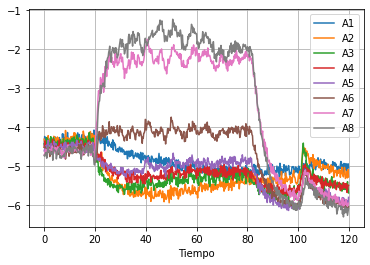

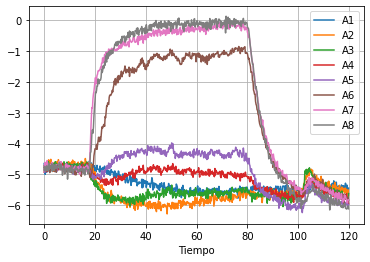

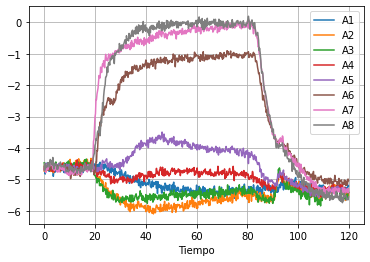

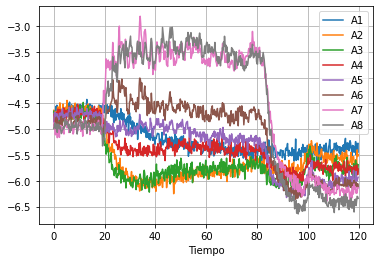

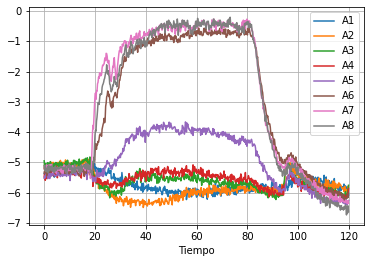

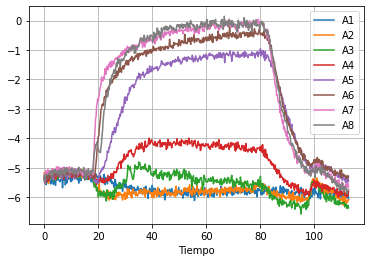

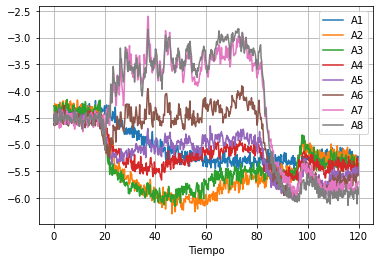

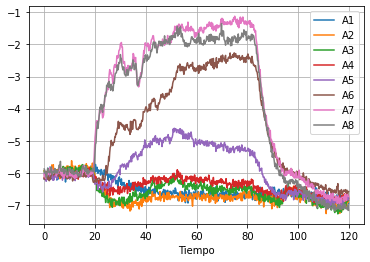

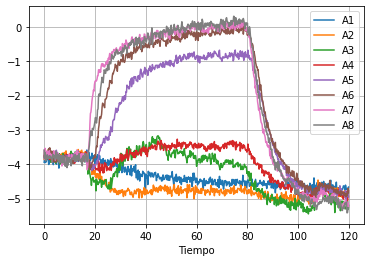

In [43]:
prs = Presentation()

sensores = ['A1', 'A2', 'A3', 'A4', 'A5', 'A6', 'A7', 'A8','Tiempo']
for archivo in ensayos:
    df=ensayos[archivo]
    contenido,gota= caracterizar_ensayo(archivo)
    df[sensores].plot(x='Tiempo')
    plt.grid()
    titulo = 'LWC='+str(contenido)+'g/m3 MVD='+str(gota)+'\n'+sensor
    nombre_imagen ='Resultados_sensor_mayo//glaze//'+sensor+str(gota)+str(contenido)+'.jpg'
    plt.savefig(nombre_imagen)
    img_path = nombre_imagen
    blank_slide_layout = prs.slide_layouts[6]
    slide = prs.slides.add_slide(blank_slide_layout)
    left = top = width = height = Inches(1)
    txBox = slide.shapes.add_textbox(left, Inches(0), width, height)
    tf = txBox.text_frame
    p = tf.add_paragraph()
    p.text =titulo
    p.font.bold = True
    left = top = Inches(1)

    left = Inches(2)
    height = Inches(5.5)
    pic = slide.shapes.add_picture(img_path, left, top, height=height)
    
prs.save('Ensayos.pptx')

In [82]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale

C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .l

ens P3-5 _4A
[[ 0.27041117 -0.0434145  -0.22730928 -0.41413602 -0.49314354 -0.47872891
  -0.47900199]
 [-0.49018667 -0.59341824 -0.51927007 -0.31265065  0.01058448  0.13750785
   0.14546318]]
ens P3-5 _4B
[[ 0.29594547  0.10923306 -0.36720669 -0.42521849 -0.44086744 -0.4405408
  -0.44316205]
 [-0.53093885 -0.7220554  -0.39548041 -0.18982171 -0.05986524  0.02268456
   0.0142987 ]]
ens P3-5 _4C
[[ 0.26751761  0.08473833 -0.33465218 -0.43829006 -0.45475268 -0.45095261
  -0.45497827]
 [-0.54315338 -0.68344506 -0.45719011 -0.16214866 -0.01821135  0.04134122
   0.02305484]]


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .l

ens P3-5 _5A
[[ 0.28148184  0.14171058 -0.20059279 -0.42895101 -0.47600591 -0.47250961
  -0.47602805]
 [-0.5053626  -0.60422598 -0.56519247 -0.24048195 -0.03985764  0.02431187
  -0.00811342]]
ens P3-5 _5B
[[ 0.10429444 -0.28669948 -0.40273648 -0.43989003 -0.43213683 -0.42365356
  -0.43011811]
 [ 0.73926045  0.55273789  0.27641584  0.00345931 -0.11478511 -0.19069102
  -0.14838613]]
ens P3-5 _5C
[[-0.04895773 -0.30658933 -0.42783439 -0.42304688 -0.42394604 -0.42082524
  -0.42985006]
 [-0.81090443 -0.49107748 -0.11418742  0.06810659  0.17958077  0.18465952
   0.13134404]]


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .l

ens P3-5 _6A
[[-0.32927034 -0.2179271   0.16160963  0.38643203  0.46588997  0.47543285
   0.4749227 ]
 [-0.45050406 -0.56464219 -0.58342057 -0.34961157 -0.12268951  0.02124415
   0.01065159]]
ens P3-5 _6B
[[ 0.08973071  0.31296102  0.40027394  0.44723526  0.43763764  0.41396436
   0.41336666]
 [-0.70115212 -0.49860167 -0.26184393  0.05562567  0.12972311  0.29517791
   0.29011641]]
ens P3-5 _6C
[[ 0.12620537 -0.36227787 -0.40188229 -0.41620368 -0.41920873 -0.41083791
  -0.41661533]
 [-0.88755138 -0.34813657 -0.24087917 -0.03244301  0.06739258  0.13007165
   0.10255616]]


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


ens P3-52_005
[[ 0.34231849  0.375675    0.38844249  0.39969281  0.40218037  0.35694291
   0.3766791 ]
 [-0.46160613 -0.39820909 -0.24607072 -0.09178284  0.16449074  0.58019566
   0.44236886]]


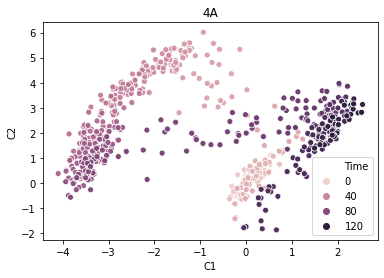

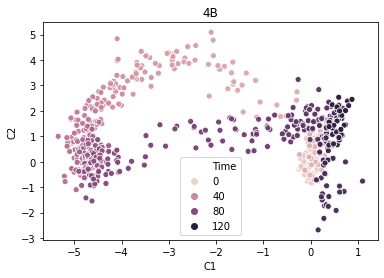

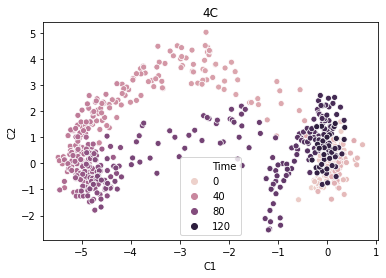

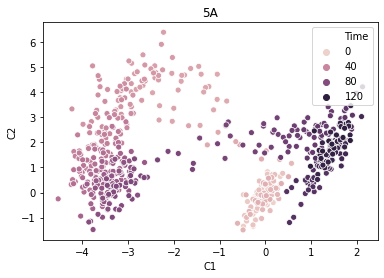

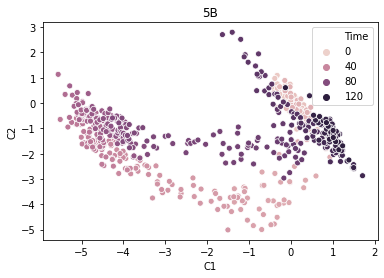

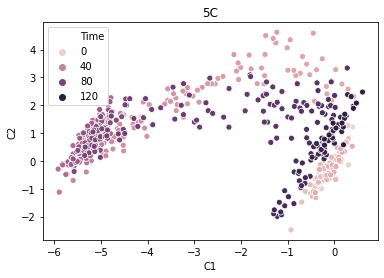

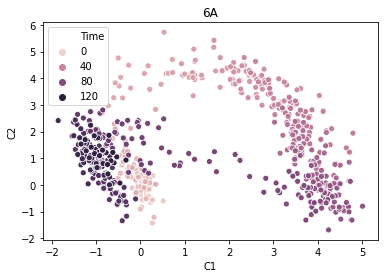

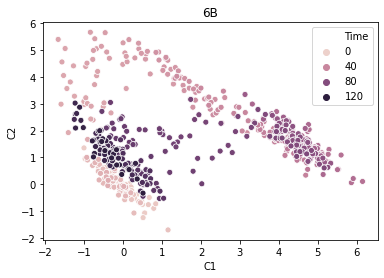

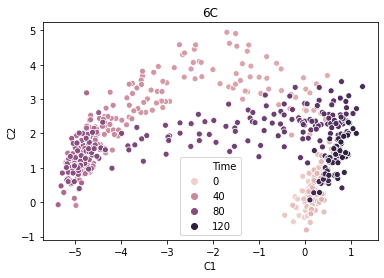

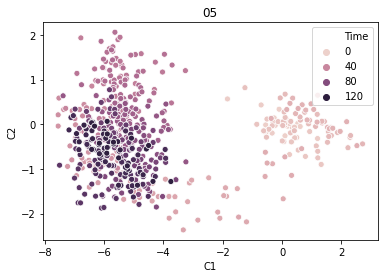

In [189]:
for ensayo in ensayos: 
    plt.figure()
    df = ensayos[ensayo][sensores]
    Delta = []
    for i in range(2,9):
        Delta.append('Delta_'+str(i))
        df['Delta_'+str(i)]=df['A'+str(i)]-df['A1']
    pca = PCA(n_components=2, svd_solver='full')
    X = np.array(df[Delta])
    X = scale(X)
    t = np.array(df['Tiempo'])
    X_transform = pca.fit_transform(X)
    media = (np.mean(X_transform[:10,0]),np.mean(X_transform[:10,1]))
    for i in [0,1]:X_transform[:,i]=X_transform[:,i]-media[i]
    df = pd.DataFrame(data=X_transform,columns=['C1','C2'])
    df['Time']=t
    sns.scatterplot(x="C1", y="C2", hue="Time", data=df)
    plt.title(ensayo[-2:])
    pca.fit(X)
    #print(pca.explained_variance_ratio_)
    print(ensayo)
    print(pca.components_)


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == '':
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using

        A1     A2     A3     A4     A5     A6     A7     A8  Tiempo  Delta_2  \
0.0 -4.465 -4.316 -4.434 -4.520 -4.615 -4.521 -4.715 -4.736     0.0    0.149   
0.2 -4.245 -4.407 -4.429 -4.434 -4.569 -4.517 -4.725 -4.753     0.2   -0.162   
0.4 -4.392 -4.552 -4.369 -4.360 -4.520 -4.511 -4.593 -4.697     0.4   -0.160   
0.6 -4.512 -4.361 -4.386 -4.629 -4.490 -4.564 -4.573 -4.669     0.6    0.151   
0.8 -4.287 -4.407 -4.427 -4.489 -4.479 -4.655 -4.663 -4.657     0.8   -0.120   

     Delta_3  Delta_4  Delta_5  Delta_6  Delta_7  Delta_8  LWC  MVD condicion  
0.0    0.031   -0.055   -0.150   -0.056   -0.250   -0.271  0.3   20        4A  
0.2   -0.184   -0.189   -0.324   -0.272   -0.480   -0.508  0.3   20        4A  
0.4    0.023    0.032   -0.128   -0.119   -0.201   -0.305  0.3   20        4A  
0.6    0.126   -0.117    0.022   -0.052   -0.061   -0.157  0.3   20        4A  
0.8   -0.140   -0.202   -0.192   -0.368   -0.376   -0.370  0.3   20        4A  
LWC=0.05g/m3   MVD=20u
-3.0311650033083

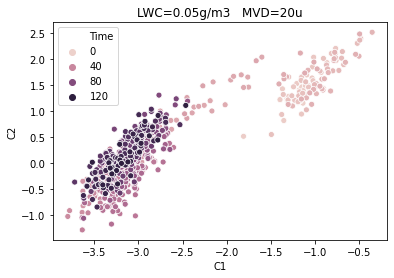

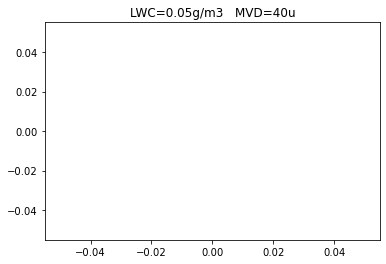

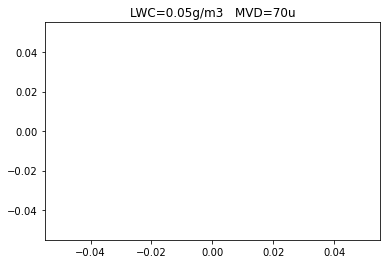

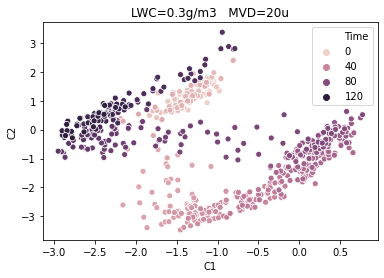

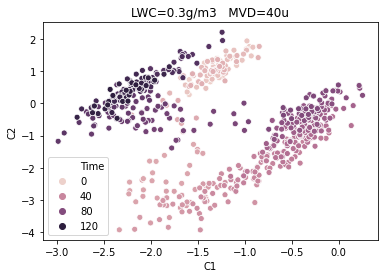

...

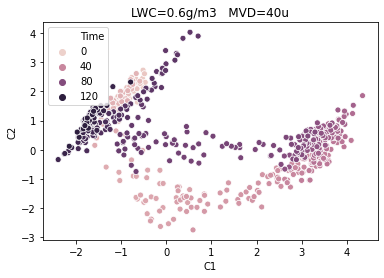

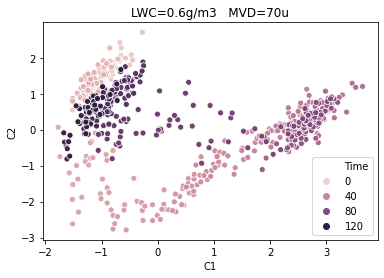

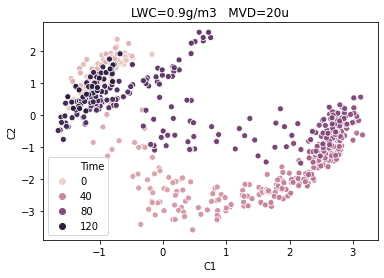

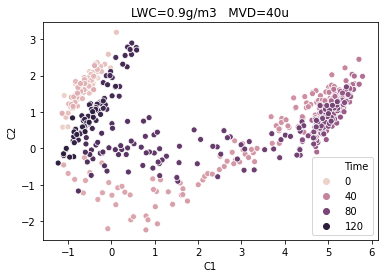

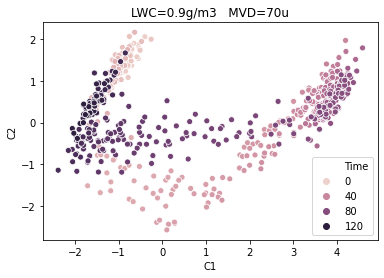

In [194]:
DF =list()
for ensayo in ensayos: 
    
    df = ensayos[ensayo][sensores]
    Delta = []
    for i in range(2,9):
        Delta.append('Delta_'+str(i))
        df['Delta_'+str(i)]=df['A'+str(i)]-df['A1']
    contenido,gota= caracterizar_ensayo(ensayo)
    LWC=[contenido for _ in range(len(df.index))]
    MVD=[gota for _ in range(len(df.index))]
    df['LWC']=LWC
    df['MVD']=MVD
    df['condicion']=ensayo[-2:]
    DF.append(df)
DF = pd.concat(DF)
print(DF.head())
pca = PCA(n_components=3, svd_solver='full')
X = np.array(DF[Delta])
X = scale(X)
X_transform = pca.fit_transform(X)
df = pd.DataFrame(data=X_transform,columns=['C1','C2','C3'])
df['LWC']=np.array(DF['LWC'])
df['MVD']=np.array(DF['MVD'])
df['Time']=np.array(DF['Tiempo'])
df['T_ref']=np.array(DF['A1'])
df['condicion']=np.array(DF['condicion'])
df.index=df['Time']
for lwc in [0.05,0.3,0.6,0.9]:
    for mvd in [20,40,70]:
        plt.figure()
        titulo ='LWC='+str(lwc)+'g/m3   MVD='+str(mvd)+'u'
        sns.scatterplot(x="C1", y="C2", hue="Time", data=df[(df.MVD == mvd)&(df.LWC==lwc)])
        plt.title(titulo)
        print(titulo)
        print(np.mean(df['C1'][(df.MVD == mvd)&(df.LWC==lwc)].loc[70:80]),np.mean(df['C2'][(df.MVD == mvd)&(df.LWC==lwc)].loc[70:80]))

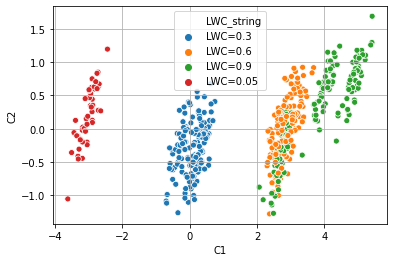

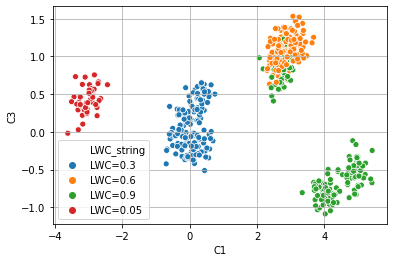

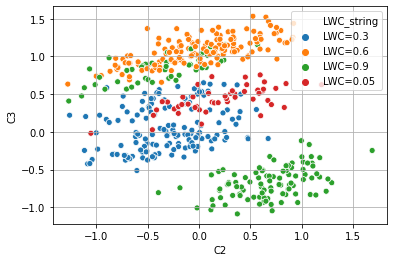

In [195]:
serie = ['LWC='+str(i) for i in list(df['LWC'])]
df['LWC_string']=serie
sns.scatterplot(x="C1", y="C2", hue="LWC_string", data=df[(df.Time<80)&(df.Time>70)])
plt.grid()
plt.figure()
sns.scatterplot(x="C1", y="C3", hue="LWC_string", data=df[(df.Time<80)&(df.Time>70)])
plt.grid()
plt.figure()
sns.scatterplot(x="C2", y="C3", hue="LWC_string", data=df[(df.Time<80)&(df.Time>70)])
plt.grid()


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sl

        A1     A2     A3     A4     A5     A6     A7     A8  Tiempo  Delta_2  \
0.0 -4.465 -4.316 -4.434 -4.520 -4.615 -4.521 -4.715 -4.736     0.0    0.149   
0.2 -4.245 -4.407 -4.429 -4.434 -4.569 -4.517 -4.725 -4.753     0.2   -0.162   
0.4 -4.392 -4.552 -4.369 -4.360 -4.520 -4.511 -4.593 -4.697     0.4   -0.160   
0.6 -4.512 -4.361 -4.386 -4.629 -4.490 -4.564 -4.573 -4.669     0.6    0.151   
0.8 -4.287 -4.407 -4.427 -4.489 -4.479 -4.655 -4.663 -4.657     0.8   -0.120   

     Delta_3  Delta_4  Delta_5  Delta_6  Delta_7  Delta_8  LWC  MVD condicion  
0.0    0.031   -0.055   -0.150   -0.056   -0.250   -0.271  0.3   20        4A  
0.2   -0.184   -0.189   -0.324   -0.272   -0.480   -0.508  0.3   20        4A  
0.4    0.023    0.032   -0.128   -0.119   -0.201   -0.305  0.3   20        4A  
0.6    0.126   -0.117    0.022   -0.052   -0.061   -0.157  0.3   20        4A  
0.8   -0.140   -0.202   -0.192   -0.368   -0.376   -0.370  0.3   20        4A  


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sl

        A1     A2     A3     A4     A5     A6     A7     A8  Tiempo  Delta_2  \
0.0 -4.650 -4.724 -4.837 -4.930 -4.712 -4.776 -4.853 -4.873     0.0   -0.074   
0.2 -4.815 -4.750 -4.733 -4.844 -4.934 -4.797 -4.762 -4.741     0.2    0.065   
0.4 -5.001 -4.758 -4.689 -4.924 -4.874 -4.827 -4.613 -4.801     0.4    0.243   
0.6 -4.877 -4.760 -4.715 -4.724 -4.689 -4.828 -4.722 -4.898     0.6    0.117   
0.8 -4.931 -4.720 -4.852 -4.845 -4.789 -4.803 -4.810 -4.822     0.8    0.211   

     Delta_3  Delta_4  Delta_5  Delta_6  Delta_7  Delta_8  LWC  MVD condicion  
0.0   -0.187   -0.280   -0.062   -0.126   -0.203   -0.223  0.6   20        4B  
0.2    0.082   -0.029   -0.119    0.018    0.053    0.074  0.6   20        4B  
0.4    0.312    0.077    0.127    0.174    0.388    0.200  0.6   20        4B  
0.6    0.162    0.153    0.188    0.049    0.155   -0.021  0.6   20        4B  
0.8    0.079    0.086    0.142    0.128    0.121    0.109  0.6   20        4B  


C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\Miguel\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a sl

        A1     A2     A3     A4     A5     A6     A7     A8  Tiempo  Delta_2  \
0.0 -4.691 -4.735 -4.472 -4.658 -4.685 -4.692 -4.695 -4.587     0.0   -0.044   
0.2 -4.738 -4.525 -4.623 -4.543 -4.643 -4.712 -4.604 -4.713     0.2    0.213   
0.4 -4.830 -4.692 -4.635 -4.566 -4.617 -4.690 -4.672 -4.483     0.4    0.138   
0.6 -4.595 -4.642 -4.531 -4.567 -4.605 -4.575 -4.785 -4.638     0.6   -0.047   
0.8 -4.486 -4.691 -4.643 -4.683 -4.629 -4.642 -4.725 -4.586     0.8   -0.205   

     Delta_3  Delta_4  Delta_5  Delta_6  Delta_7  Delta_8  LWC  MVD condicion  
0.0    0.219    0.033    0.006   -0.001   -0.004    0.104  0.9   20        4C  
0.2    0.115    0.195    0.095    0.026    0.134    0.025  0.9   20        4C  
0.4    0.195    0.264    0.213    0.140    0.158    0.347  0.9   20        4C  
0.6    0.064    0.028   -0.010    0.020   -0.190   -0.043  0.9   20        4C  
0.8   -0.157   -0.197   -0.143   -0.156   -0.239   -0.100  0.9   20        4C  


<Figure size 432x288 with 0 Axes>

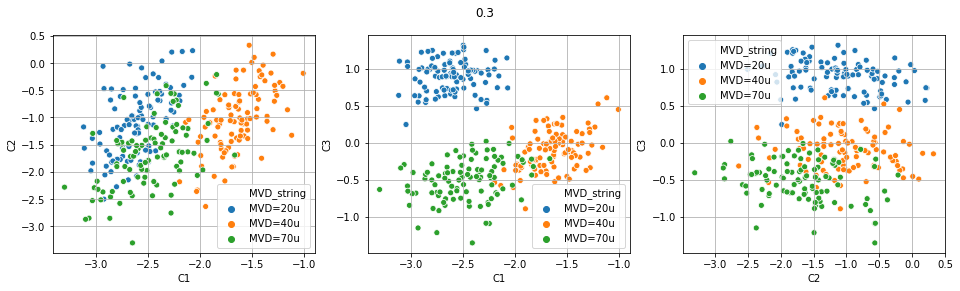

<Figure size 432x288 with 0 Axes>

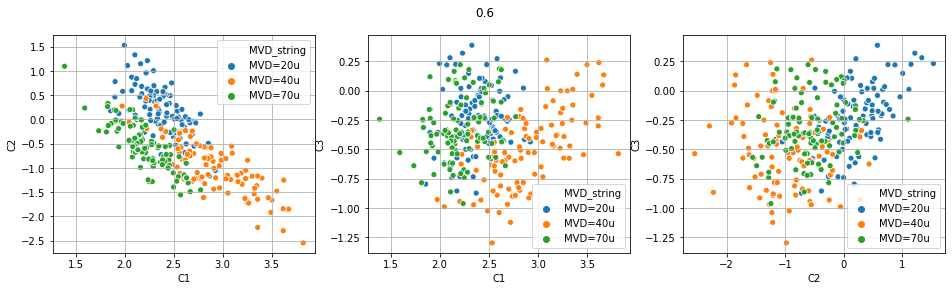

<Figure size 432x288 with 0 Axes>

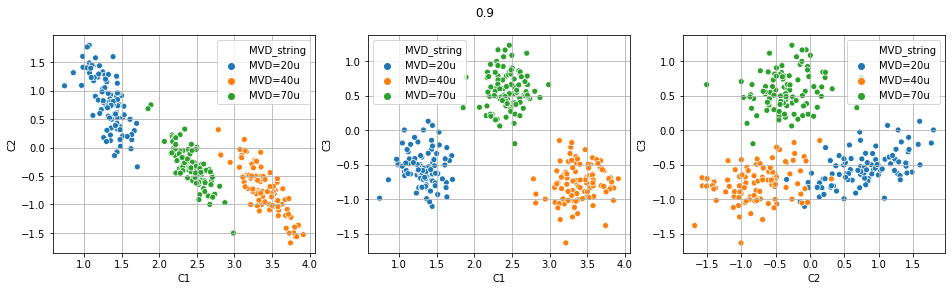

In [197]:
for LWC_elegido in [0.3,0.6,0.9]:
    DF =list()
    for ensayo in ensayos: 

        df = ensayos[ensayo][sensores]

        Delta = []
        for i in range(2,9):
            Delta.append('Delta_'+str(i))
            df['Delta_'+str(i)]=df['A'+str(i)]-df['A1']
        contenido,gota= caracterizar_ensayo(ensayo)
        LWC=[contenido for _ in range(len(df.index))]
        MVD=[gota for _ in range(len(df.index))]
        df['LWC']=LWC

        df['MVD']=MVD
        df['condicion']=ensayo[-2:]
        df = df[df.LWC==LWC_elegido]
        DF.append(df)
    DF = pd.concat(DF)
    print(DF.head())
    pca = PCA(n_components=3, svd_solver='full')
    X = np.array(DF[Delta])
    X = scale(X)
    X_transform = pca.fit_transform(X)
    df = pd.DataFrame(data=X_transform,columns=['C1','C2','C3'])
    df['LWC']=np.array(DF['LWC'])
    df['MVD']=np.array(DF['MVD'])
    df['Time']=np.array(DF['Tiempo'])
    df['T_ref']=np.array(DF['A1'])
    df['condicion']=np.array(DF['condicion'])
    df.index=df['Time']

    serie = ['MVD='+str(i)+'u' for i in list(df['MVD'])]
    df['MVD_string']=serie
    
    plt.figure()
    f, axes = plt.subplots(1, 3, figsize=(16, 4), sharex=False)
    f.suptitle(LWC_elegido)
    sns.scatterplot(x="C1", y="C2", hue="MVD_string", data=df[(df.Time<80)&(df.Time>60)],ax=axes[0])
    sns.scatterplot(x="C1", y="C3", hue="MVD_string", data=df[(df.Time<80)&(df.Time>60)],ax=axes[1])
    sns.scatterplot(x="C2", y="C3", hue="MVD_string", data=df[(df.Time<80)&(df.Time>60)],ax=axes[2])
    for i in range(3):axes[i].grid()

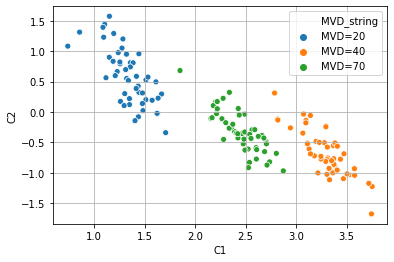

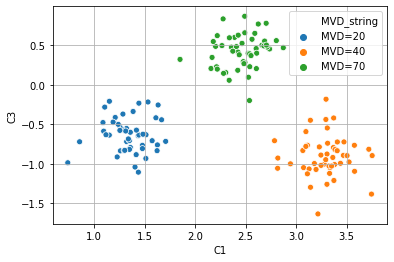

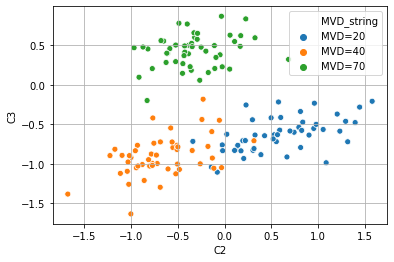